## Imports

In [1]:
#import the Forward Modelling Engine modules - LoopStructural
from LoopStructural import GeologicalModel
from LoopStructural.datasets import load_noddy_single_fold
from LoopStructural.visualisation.model_visualisation import LavaVuModelViewer
from LoopStructural.utils.helper import strike_dip_vector, plunge_and_plunge_dir_to_vector
# from LoopStructural.visualisation.rotation_angle_plotter import RotationAnglePlotter
# import other libraries
import pandas as pd
import numpy as np
from scipy.interpolate import Rbf
import matplotlib.pyplot as plt
import logging
logging.getLogger().setLevel(logging.INFO)

/home/lgrose/miniconda3/envs/loop/lib/python3.8/site-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.decomposition.pca module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.decomposition. Anything that cannot be imported from sklearn.decomposition is now part of the private API.
  warnings.warn(message, FutureWarning)


In [2]:
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

## Structural geology of folds 

Folds are one of the most common features found in deformed rocks and are defined by the location of higher curvature. 
The geometry of the folded surface can be characterised by three geometrical elements: 

1. the fold hinge is the point of maximum curvature along folded surface
2. the axial surface is a surfaces that passes through all curvature points in all folded foliations
3. the fold axis is the intersection of the folded foliation and the axial surface

Modelling folded surfaces using standard implicit algorithms is challenging because the implicit modelling methods are generally trying to minimise the resulting curvature of the surface. 
To model folded surfaces the geologist will need to characterise the geometry of the folded surface in high detail.

<img src="images/folded_surface.png" alt="Folded outcrop" style="width: 400px;"/>

## Modelling folded surfaces without structural geology
In the following section we will attempt to model a synthetic fold shape that is defined by a sinusoidal folded surface.
For simplicity we will consider the fold as cylindrical and therefore only consider the fold in a 2D plane. 
The data set has been sampled from a model generated using Noddy and represents a fold with a wavelength of ~10km and amplitude of ~2km.

<img src="images/noddy.png" alt="Noddy Model" style="width: 400px;"/>

The orientation of the structure has been sampled within the model volume (10km,7km,5km) at 500m intervals. 


**The aim of this exercise is to investigate how standard implicit modelling techniques are fundamentally limited when trying to model folded surfaces.**

1. Load data from sample datasets
2.  Visualise data
3. Look at varying degrees of sampling e.g. 200 points, 100 points, 10 points. 
2. Look at using data points ONLY from a map surface


### Modelling folded surfaces using loop structural

In [3]:
# load the sample data
data, boundary_points = load_noddy_single_fold()
data.head()


,X,Y,Z,dip,strike,type,coord,random
972,500.0,500.0,5500.0,69.965373,399.166448,s0,NaN,0.126657
976,500.0,500.0,6000.0,69.965373,399.166448,s0,NaN,0.376144
980,500.0,500.0,6500.0,69.965373,399.166448,s0,NaN,0.731684
984,500.0,500.0,7000.0,69.965373,399.166448,s0,NaN,0.479522
988,500.0,500.0,7500.0,69.965373,399.166448,s0,NaN,0.465607


The input dataset was generated using Noddy by sampling the orientation of a structure on a regular grid. We have loaded it into a pandas DataFrame, this is basically an excel spreadsheet for python.
Above are the first 5 rows of the dataset and as we can see it is regularly sampled with data points being sampled regularly along the $z$, $y$ and $x$ axes. In order to avoid artefacts due to the sampling errors we will shuffle the data. We can do this using the `random` column in the DataFrame (ensuring everyone has the same data).

In [4]:
data = data.sort_values('random') # sort the data by a random int then we can select N random points 
data.head()

,X,Y,Z,dip,strike,type,coord,random
11272,2000.0,6000.0,6000.0,70.370847,398.150099,s0,NaN,0.000340
1120,2000.0,500.0,7500.0,70.370847,398.150099,s0,NaN,0.003175
11356,3000.0,6000.0,5500.0,64.030744,417.522113,s0,NaN,0.004159
7724,3500.0,4000.0,8000.0,64.030744,417.522113,s0,NaN,0.004213
5608,500.0,3000.0,7500.0,69.965373,399.166448,s0,NaN,0.005269


The data can be visualised using the lavavu 3d viewer - by first converting from strike and dip to normal vectors. Note that there are a lot of data points to display as the model volume was regularly sampled on a grid.

Plot area has not been defined.



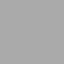

In [5]:
viewer = LavaVuModelViewer()
xyz = data[['X','Y','Z']]
vector = strike_dip_vector(data['strike'],data['dip'])
viewer.add_vector_data(xyz,vector,name='all_data')
viewer.interactive()

The data points are now randomly ordered and can now be subsampled by choosing the first N samples from the dataframe
```Python
data[:100]
```
returns the first 100 data points from the array

### Testing data density
* Use the toggle bar to change the amount of data used by the interpolation algorithm. 
* How does the shape of the fold change as we remove data points?
* Now what happens if we only consider data from the map view?

**HINT** you can view the strike and dip data by unchecking the scalar field box. 

**The black arrows are the normal vector to the folded surface**


In [ ]:
npoints = 40
model = GeologicalModel(boundary_points[0,:],boundary_points[1,:])
model.set_model_data(data[:npoints])
stratigraphy = model.create_and_add_foliation("s0",
                                              interpolatortype="PLI",
                                              nelements=10000,
                                              buffer=0.3,
                                              regularisation=0.1
                                             )#.2)
viewer = LavaVuModelViewer(model,background="white")
# viewer.add_scalar_field(model.bounding_box,(38,55,30),
#                       'box',
#                      paint_with=stratigraphy,
#                      cmap='prism')
viewer.add_data(stratigraphy['feature'])
viewer.add_isosurface(stratigraphy['feature'],
                     voxet=model.voxet())
viewer.interactive()

[[[   1   36  953  920]
  [   1  920  953  919]
  [ 920   36  954  953]
  [   1    2   36  920]
  [   1   36  953   35]]

 [[  34   69  986  953]
  [  34  953  986  952]
  [ 953   69  987  986]
  [  34   35   69  953]
  [  34   69  986   68]]

 [[ 918  953 1870 1837]
  [ 918 1837 1870 1836]
  [1837  953 1871 1870]
  [ 918  919  953 1837]
  [ 918  953 1870  952]]]
[[[   1   36  953  920]
  [   1  920  953  919]
  [ 920   36  954  953]
  [   1    2   36  920]
  [   1   36  953   35]]

 [[  34   69  986  953]
  [  34  953  986  952]
  [ 953   69  987  986]
  [  34   35   69  953]
  [  34   69  986   68]]

 [[ 918  953 1870 1837]
  [ 918 1837 1870 1836]
  [1837  953 1871 1870]
  [ 918  919  953 1837]
  [ 918  953 1870  952]]]
[[[   1   36  953  920]
  [   1  920  953  919]
  [ 920   36  954  953]
  [   1    2   36  920]
  [   1   36  953   35]]

 [[  34   69  986  953]
  [  34  953  986  952]
  [ 953   69  987  986]
  [  34   35   69  953]
  [  34   69  986   68]]

 [[ 918  953 1870 1837]


[[[  48   81  965 1000]
  [  48   82 1000   81]
  [  47   48   81  965]
  [ 965 1000  999   81]
  [  48 1000  965  966]]

 [[  50   83  967 1002]
  [  50   84 1002   83]
  [  49   50   83  967]
  [ 967 1002 1001   83]
  [  50 1002  967  968]]

 [[  15   48  932  967]
  [  15   49  967   48]
  [  14   15   48  932]
  [ 932  967  966   48]
  [  15  967  932  933]]

 [[  83  116 1000 1035]
  [  83  117 1035  116]
  [  82   83  116 1000]
  [1000 1035 1034  116]
  [  83 1035 1000 1001]]

 [[ 967 1000 1884 1919]
  [ 967 1001 1919 1000]
  [ 966  967 1000 1884]
  [1884 1919 1918 1000]
  [ 967 1919 1884 1885]]]
[[[  48   81  965 1000]
  [  48   82 1000   81]
  [  47   48   81  965]
  [ 965 1000  999   81]
  [  48 1000  965  966]]

 [[  50   83  967 1002]
  [  50   84 1002   83]
  [  49   50   83  967]
  [ 967 1002 1001   83]
  [  50 1002  967  968]]

 [[  15   48  932  967]
  [  15   49  967   48]
  [  14   15   48  932]
  [ 932  967  966   48]
  [  15  967  932  933]]

 [[  83  116 1000 1035]


[[[  91  126 1043 1010]
  [  91 1010 1043 1009]
  [1010  126 1044 1043]
  [  91   92  126 1010]
  [  91  126 1043  125]]

 [[  93  128 1045 1012]
  [  93 1012 1045 1011]
  [1012  128 1046 1045]
  [  93   94  128 1012]
  [  93  128 1045  127]]

 [[  58   93 1010  977]
  [  58  977 1010  976]
  [ 977   93 1011 1010]
  [  58   59   93  977]
  [  58   93 1010   92]]

 [[ 126  161 1078 1045]
  [ 126 1045 1078 1044]
  [1045  161 1079 1078]
  [ 126  127  161 1045]
  [ 126  161 1078  160]]

 [[1010 1045 1962 1929]
  [1010 1929 1962 1928]
  [1929 1045 1963 1962]
  [1010 1011 1045 1929]
  [1010 1045 1962 1044]]]
[[[  93  126 1010 1045]
  [  93  127 1045  126]
  [  92   93  126 1010]
  [1010 1045 1044  126]
  [  93 1045 1010 1011]]

 [[  95  128 1012 1047]
  [  95  129 1047  128]
  [  94   95  128 1012]
  [1012 1047 1046  128]
  [  95 1047 1012 1013]]

 [[  60   93  977 1012]
  [  60   94 1012   93]
  [  59   60   93  977]
  [ 977 1012 1011   93]
  [  60 1012  977  978]]

 [[ 128  161 1045 1080]


[[[ 139  172 1056 1091]
  [ 139  173 1091  172]
  [ 138  139  172 1056]
  [1056 1091 1090  172]
  [ 139 1091 1056 1057]]

 [[ 141  174 1058 1093]
  [ 141  175 1093  174]
  [ 140  141  174 1058]
  [1058 1093 1092  174]
  [ 141 1093 1058 1059]]

 [[ 106  139 1023 1058]
  [ 106  140 1058  139]
  [ 105  106  139 1023]
  [1023 1058 1057  139]
  [ 106 1058 1023 1024]]

 [[ 174  207 1091 1126]
  [ 174  208 1126  207]
  [ 173  174  207 1091]
  [1091 1126 1125  207]
  [ 174 1126 1091 1092]]

 [[1058 1091 1975 2010]
  [1058 1092 2010 1091]
  [1057 1058 1091 1975]
  [1975 2010 2009 1091]
  [1058 2010 1975 1976]]]
[[[ 139  172 1056 1091]
  [ 139  173 1091  172]
  [ 138  139  172 1056]
  [1056 1091 1090  172]
  [ 139 1091 1056 1057]]

 [[ 141  174 1058 1093]
  [ 141  175 1093  174]
  [ 140  141  174 1058]
  [1058 1093 1092  174]
  [ 141 1093 1058 1059]]

 [[ 106  139 1023 1058]
  [ 106  140 1058  139]
  [ 105  106  139 1023]
  [1023 1058 1057  139]
  [ 106 1058 1023 1024]]

 [[ 174  207 1091 1126]


[[[ 182  217 1134 1101]
  [ 182 1101 1134 1100]
  [1101  217 1135 1134]
  [ 182  183  217 1101]
  [ 182  217 1134  216]]

 [[ 184  219 1136 1103]
  [ 184 1103 1136 1102]
  [1103  219 1137 1136]
  [ 184  185  219 1103]
  [ 184  219 1136  218]]

 [[ 149  184 1101 1068]
  [ 149 1068 1101 1067]
  [1068  184 1102 1101]
  [ 149  150  184 1068]
  [ 149  184 1101  183]]

 [[ 217  252 1169 1136]
  [ 217 1136 1169 1135]
  [1136  252 1170 1169]
  [ 217  218  252 1136]
  [ 217  252 1169  251]]

 [[1101 1136 2053 2020]
  [1101 2020 2053 2019]
  [2020 1136 2054 2053]
  [1101 1102 1136 2020]
  [1101 1136 2053 1135]]]
[[[ 184  217 1101 1136]
  [ 184  218 1136  217]
  [ 183  184  217 1101]
  [1101 1136 1135  217]
  [ 184 1136 1101 1102]]

 [[ 186  219 1103 1138]
  [ 186  220 1138  219]
  [ 185  186  219 1103]
  [1103 1138 1137  219]
  [ 186 1138 1103 1104]]

 [[ 151  184 1068 1103]
  [ 151  185 1103  184]
  [ 150  151  184 1068]
  [1068 1103 1102  184]
  [ 151 1103 1068 1069]]

 [[ 219  252 1136 1171]


[[[ 227  262 1179 1146]
  [ 227 1146 1179 1145]
  [1146  262 1180 1179]
  [ 227  228  262 1146]
  [ 227  262 1179  261]]

 [[ 229  264 1181 1148]
  [ 229 1148 1181 1147]
  [1148  264 1182 1181]
  [ 229  230  264 1148]
  [ 229  264 1181  263]]

 [[ 194  229 1146 1113]
  [ 194 1113 1146 1112]
  [1113  229 1147 1146]
  [ 194  195  229 1113]
  [ 194  229 1146  228]]

 [[ 262  297 1214 1181]
  [ 262 1181 1214 1180]
  [1181  297 1215 1214]
  [ 262  263  297 1181]
  [ 262  297 1214  296]]

 [[1146 1181 2098 2065]
  [1146 2065 2098 2064]
  [2065 1181 2099 2098]
  [1146 1147 1181 2065]
  [1146 1181 2098 1180]]]
[[[ 227  262 1179 1146]
  [ 227 1146 1179 1145]
  [1146  262 1180 1179]
  [ 227  228  262 1146]
  [ 227  262 1179  261]]

 [[ 229  264 1181 1148]
  [ 229 1148 1181 1147]
  [1148  264 1182 1181]
  [ 229  230  264 1148]
  [ 229  264 1181  263]]

 [[ 194  229 1146 1113]
  [ 194 1113 1146 1112]
  [1113  229 1147 1146]
  [ 194  195  229 1113]
  [ 194  229 1146  228]]

 [[ 262  297 1214 1181]


  [1192 1227 2144 1226]]]
[[[ 273  308 1225 1192]
  [ 273 1192 1225 1191]
  [1192  308 1226 1225]
  [ 273  274  308 1192]
  [ 273  308 1225  307]]

 [[ 275  310 1227 1194]
  [ 275 1194 1227 1193]
  [1194  310 1228 1227]
  [ 275  276  310 1194]
  [ 275  310 1227  309]]

 [[ 240  275 1192 1159]
  [ 240 1159 1192 1158]
  [1159  275 1193 1192]
  [ 240  241  275 1159]
  [ 240  275 1192  274]]

 [[ 308  343 1260 1227]
  [ 308 1227 1260 1226]
  [1227  343 1261 1260]
  [ 308  309  343 1227]
  [ 308  343 1260  342]]

 [[1192 1227 2144 2111]
  [1192 2111 2144 2110]
  [2111 1227 2145 2144]
  [1192 1193 1227 2111]
  [1192 1227 2144 1226]]]
[[[ 273  308 1225 1192]
  [ 273 1192 1225 1191]
  [1192  308 1226 1225]
  [ 273  274  308 1192]
  [ 273  308 1225  307]]

 [[ 275  310 1227 1194]
  [ 275 1194 1227 1193]
  [1194  310 1228 1227]
  [ 275  276  310 1194]
  [ 275  310 1227  309]]

 [[ 240  275 1192 1159]
  [ 240 1159 1192 1158]
  [1159  275 1193 1192]
  [ 240  241  275 1159]
  [ 240  275 1192  274]]

[[[ 295  328 1212 1247]
  [ 295  329 1247  328]
  [ 294  295  328 1212]
  [1212 1247 1246  328]
  [ 295 1247 1212 1213]]

 [[ 297  330 1214 1249]
  [ 297  331 1249  330]
  [ 296  297  330 1214]
  [1214 1249 1248  330]
  [ 297 1249 1214 1215]]

 [[ 262  295 1179 1214]
  [ 262  296 1214  295]
  [ 261  262  295 1179]
  [1179 1214 1213  295]
  [ 262 1214 1179 1180]]

 [[ 330  363 1247 1282]
  [ 330  364 1282  363]
  [ 329  330  363 1247]
  [1247 1282 1281  363]
  [ 330 1282 1247 1248]]

 [[1214 1247 2131 2166]
  [1214 1248 2166 1247]
  [1213 1214 1247 2131]
  [2131 2166 2165 1247]
  [1214 2166 2131 2132]]]
[[[ 295  328 1212 1247]
  [ 295  329 1247  328]
  [ 294  295  328 1212]
  [1212 1247 1246  328]
  [ 295 1247 1212 1213]]

 [[ 297  330 1214 1249]
  [ 297  331 1249  330]
  [ 296  297  330 1214]
  [1214 1249 1248  330]
  [ 297 1249 1214 1215]]

 [[ 262  295 1179 1214]
  [ 262  296 1214  295]
  [ 261  262  295 1179]
  [1179 1214 1213  295]
  [ 262 1214 1179 1180]]

 [[ 330  363 1247 1282]


[[[ 341  376 1293 1260]
  [ 341 1260 1293 1259]
  [1260  376 1294 1293]
  [ 341  342  376 1260]
  [ 341  376 1293  375]]

 [[ 306  341 1258 1225]
  [ 306 1225 1258 1224]
  [1225  341 1259 1258]
  [ 306  307  341 1225]
  [ 306  341 1258  340]]

 [[ 374  409 1326 1293]
  [ 374 1293 1326 1292]
  [1293  409 1327 1326]
  [ 374  375  409 1293]
  [ 374  409 1326  408]]

 [[1258 1293 2210 2177]
  [1258 2177 2210 2176]
  [2177 1293 2211 2210]
  [1258 1259 1293 2177]
  [1258 1293 2210 1292]]]
[[[ 341  374 1258 1293]
  [ 341  375 1293  374]
  [ 340  341  374 1258]
  [1258 1293 1292  374]
  [ 341 1293 1258 1259]]

 [[ 343  376 1260 1295]
  [ 343  377 1295  376]
  [ 342  343  376 1260]
  [1260 1295 1294  376]
  [ 343 1295 1260 1261]]

 [[ 308  341 1225 1260]
  [ 308  342 1260  341]
  [ 307  308  341 1225]
  [1225 1260 1259  341]
  [ 308 1260 1225 1226]]

 [[ 376  409 1293 1328]
  [ 376  410 1328  409]
  [ 375  376  409 1293]
  [1293 1328 1327  409]
  [ 376 1328 1293 1294]]

 [[1260 1293 2177 2212]


  [1305 1340 2257 1339]]]
[[[ 386  421 1338 1305]
  [ 386 1305 1338 1304]
  [1305  421 1339 1338]
  [ 386  387  421 1305]
  [ 386  421 1338  420]]

 [[ 388  423 1340 1307]
  [ 388 1307 1340 1306]
  [1307  423 1341 1340]
  [ 388  389  423 1307]
  [ 388  423 1340  422]]

 [[ 353  388 1305 1272]
  [ 353 1272 1305 1271]
  [1272  388 1306 1305]
  [ 353  354  388 1272]
  [ 353  388 1305  387]]

 [[ 421  456 1373 1340]
  [ 421 1340 1373 1339]
  [1340  456 1374 1373]
  [ 421  422  456 1340]
  [ 421  456 1373  455]]

 [[1305 1340 2257 2224]
  [1305 2224 2257 2223]
  [2224 1340 2258 2257]
  [1305 1306 1340 2224]
  [1305 1340 2257 1339]]]
[[[ 386  421 1338 1305]
  [ 386 1305 1338 1304]
  [1305  421 1339 1338]
  [ 386  387  421 1305]
  [ 386  421 1338  420]]

 [[ 388  423 1340 1307]
  [ 388 1307 1340 1306]
  [1307  423 1341 1340]
  [ 388  389  423 1307]
  [ 388  423 1340  422]]

 [[ 353  388 1305 1272]
  [ 353 1272 1305 1271]
  [1272  388 1306 1305]
  [ 353  354  388 1272]
  [ 353  388 1305  387]]

  [1350 1385 2302 1384]]]
[[[ 431  466 1383 1350]
  [ 431 1350 1383 1349]
  [1350  466 1384 1383]
  [ 431  432  466 1350]
  [ 431  466 1383  465]]

 [[ 433  468 1385 1352]
  [ 433 1352 1385 1351]
  [1352  468 1386 1385]
  [ 433  434  468 1352]
  [ 433  468 1385  467]]

 [[ 398  433 1350 1317]
  [ 398 1317 1350 1316]
  [1317  433 1351 1350]
  [ 398  399  433 1317]
  [ 398  433 1350  432]]

 [[ 466  501 1418 1385]
  [ 466 1385 1418 1384]
  [1385  501 1419 1418]
  [ 466  467  501 1385]
  [ 466  501 1418  500]]

 [[1350 1385 2302 2269]
  [1350 2269 2302 2268]
  [2269 1385 2303 2302]
  [1350 1351 1385 2269]
  [1350 1385 2302 1384]]]
[[[ 431  466 1383 1350]
  [ 431 1350 1383 1349]
  [1350  466 1384 1383]
  [ 431  432  466 1350]
  [ 431  466 1383  465]]

 [[ 433  468 1385 1352]
  [ 433 1352 1385 1351]
  [1352  468 1386 1385]
  [ 433  434  468 1352]
  [ 433  468 1385  467]]

 [[ 398  433 1350 1317]
  [ 398 1317 1350 1316]
  [1317  433 1351 1350]
  [ 398  399  433 1317]
  [ 398  433 1350  432]]

  [1389 1424 2341 1423]]]
[[[ 472  505 1389 1424]
  [ 472  506 1424  505]
  [ 471  472  505 1389]
  [1389 1424 1423  505]
  [ 472 1424 1389 1390]]

 [[ 474  507 1391 1426]
  [ 474  508 1426  507]
  [ 473  474  507 1391]
  [1391 1426 1425  507]
  [ 474 1426 1391 1392]]

 [[ 439  472 1356 1391]
  [ 439  473 1391  472]
  [ 438  439  472 1356]
  [1356 1391 1390  472]
  [ 439 1391 1356 1357]]

 [[ 507  540 1424 1459]
  [ 507  541 1459  540]
  [ 506  507  540 1424]
  [1424 1459 1458  540]
  [ 507 1459 1424 1425]]

 [[1391 1424 2308 2343]
  [1391 1425 2343 1424]
  [1390 1391 1424 2308]
  [2308 2343 2342 1424]
  [1391 2343 2308 2309]]]
[[[ 472  505 1389 1424]
  [ 472  506 1424  505]
  [ 471  472  505 1389]
  [1389 1424 1423  505]
  [ 472 1424 1389 1390]]

 [[ 474  507 1391 1426]
  [ 474  508 1426  507]
  [ 473  474  507 1391]
  [1391 1426 1425  507]
  [ 474 1426 1391 1392]]

 [[ 439  472 1356 1391]
  [ 439  473 1391  472]
  [ 438  439  472 1356]
  [1356 1391 1390  472]
  [ 439 1391 1356 1357]]

  [1435 1470 2387 1469]]]
[[[ 516  551 1468 1435]
  [ 516 1435 1468 1434]
  [1435  551 1469 1468]
  [ 516  517  551 1435]
  [ 516  551 1468  550]]

 [[ 518  553 1470 1437]
  [ 518 1437 1470 1436]
  [1437  553 1471 1470]
  [ 518  519  553 1437]
  [ 518  553 1470  552]]

 [[ 483  518 1435 1402]
  [ 483 1402 1435 1401]
  [1402  518 1436 1435]
  [ 483  484  518 1402]
  [ 483  518 1435  517]]

 [[ 551  586 1503 1470]
  [ 551 1470 1503 1469]
  [1470  586 1504 1503]
  [ 551  552  586 1470]
  [ 551  586 1503  585]]

 [[1435 1470 2387 2354]
  [1435 2354 2387 2353]
  [2354 1470 2388 2387]
  [1435 1436 1470 2354]
  [1435 1470 2387 1469]]]
[[[ 516  551 1468 1435]
  [ 516 1435 1468 1434]
  [1435  551 1469 1468]
  [ 516  517  551 1435]
  [ 516  551 1468  550]]

 [[ 518  553 1470 1437]
  [ 518 1437 1470 1436]
  [1437  553 1471 1470]
  [ 518  519  553 1437]
  [ 518  553 1470  552]]

 [[ 483  518 1435 1402]
  [ 483 1402 1435 1401]
  [1402  518 1436 1435]
  [ 483  484  518 1402]
  [ 483  518 1435  517]]

  [1482 2434 2399 2400]]]
[[[ 563  596 1480 1515]
  [ 563  597 1515  596]
  [ 562  563  596 1480]
  [1480 1515 1514  596]
  [ 563 1515 1480 1481]]

 [[ 565  598 1482 1517]
  [ 565  599 1517  598]
  [ 564  565  598 1482]
  [1482 1517 1516  598]
  [ 565 1517 1482 1483]]

 [[ 530  563 1447 1482]
  [ 530  564 1482  563]
  [ 529  530  563 1447]
  [1447 1482 1481  563]
  [ 530 1482 1447 1448]]

 [[ 598  631 1515 1550]
  [ 598  632 1550  631]
  [ 597  598  631 1515]
  [1515 1550 1549  631]
  [ 598 1550 1515 1516]]

 [[1482 1515 2399 2434]
  [1482 1516 2434 1515]
  [1481 1482 1515 2399]
  [2399 2434 2433 1515]
  [1482 2434 2399 2400]]]
[[[ 563  596 1480 1515]
  [ 563  597 1515  596]
  [ 562  563  596 1480]
  [1480 1515 1514  596]
  [ 563 1515 1480 1481]]

 [[ 565  598 1482 1517]
  [ 565  599 1517  598]
  [ 564  565  598 1482]
  [1482 1517 1516  598]
  [ 565 1517 1482 1483]]

 [[ 530  563 1447 1482]
  [ 530  564 1482  563]
  [ 529  530  563 1447]
  [1447 1482 1481  563]
  [ 530 1482 1447 1448]]

[[[ 608  643 1560 1527]
  [ 608 1527 1560 1526]
  [1527  643 1561 1560]
  [ 608  609  643 1527]
  [ 608  643 1560  642]]

 [[ 610  645 1562 1529]
  [ 610 1529 1562 1528]
  [1529  645 1563 1562]
  [ 610  611  645 1529]
  [ 610  645 1562  644]]

 [[ 575  610 1527 1494]
  [ 575 1494 1527 1493]
  [1494  610 1528 1527]
  [ 575  576  610 1494]
  [ 575  610 1527  609]]

 [[ 643  678 1595 1562]
  [ 643 1562 1595 1561]
  [1562  678 1596 1595]
  [ 643  644  678 1562]
  [ 643  678 1595  677]]

 [[1527 1562 2479 2446]
  [1527 2446 2479 2445]
  [2446 1562 2480 2479]
  [1527 1528 1562 2446]
  [1527 1562 2479 1561]]]
[[[ 608  643 1560 1527]
  [ 608 1527 1560 1526]
  [1527  643 1561 1560]
  [ 608  609  643 1527]
  [ 608  643 1560  642]]

 [[ 610  645 1562 1529]
  [ 610 1529 1562 1528]
  [1529  645 1563 1562]
  [ 610  611  645 1529]
  [ 610  645 1562  644]]

 [[ 575  610 1527 1494]
  [ 575 1494 1527 1493]
  [1494  610 1528 1527]
  [ 575  576  610 1494]
  [ 575  610 1527  609]]

 [[ 643  678 1595 1562]


[[[ 658  691 1575 1610]
  [ 658  692 1610  691]
  [ 657  658  691 1575]
  [1575 1610 1609  691]
  [ 658 1610 1575 1576]]

 [[ 660  693 1577 1612]
  [ 660  694 1612  693]
  [ 659  660  693 1577]
  [1577 1612 1611  693]
  [ 660 1612 1577 1578]]

 [[ 625  658 1542 1577]
  [ 625  659 1577  658]
  [ 624  625  658 1542]
  [1542 1577 1576  658]
  [ 625 1577 1542 1543]]

 [[ 693  726 1610 1645]
  [ 693  727 1645  726]
  [ 692  693  726 1610]
  [1610 1645 1644  726]
  [ 693 1645 1610 1611]]

 [[1577 1610 2494 2529]
  [1577 1611 2529 1610]
  [1576 1577 1610 2494]
  [2494 2529 2528 1610]
  [1577 2529 2494 2495]]]
[[[ 658  691 1575 1610]
  [ 658  692 1610  691]
  [ 657  658  691 1575]
  [1575 1610 1609  691]
  [ 658 1610 1575 1576]]

 [[ 660  693 1577 1612]
  [ 660  694 1612  693]
  [ 659  660  693 1577]
  [1577 1612 1611  693]
  [ 660 1612 1577 1578]]

 [[ 625  658 1542 1577]
  [ 625  659 1577  658]
  [ 624  625  658 1542]
  [1542 1577 1576  658]
  [ 625 1577 1542 1543]]

 [[ 693  726 1610 1645]


[[[ 703  736 1620 1655]
  [ 703  737 1655  736]
  [ 702  703  736 1620]
  [1620 1655 1654  736]
  [ 703 1655 1620 1621]]

 [[ 705  738 1622 1657]
  [ 705  739 1657  738]
  [ 704  705  738 1622]
  [1622 1657 1656  738]
  [ 705 1657 1622 1623]]

 [[ 670  703 1587 1622]
  [ 670  704 1622  703]
  [ 669  670  703 1587]
  [1587 1622 1621  703]
  [ 670 1622 1587 1588]]

 [[ 738  771 1655 1690]
  [ 738  772 1690  771]
  [ 737  738  771 1655]
  [1655 1690 1689  771]
  [ 738 1690 1655 1656]]

 [[1622 1655 2539 2574]
  [1622 1656 2574 1655]
  [1621 1622 1655 2539]
  [2539 2574 2573 1655]
  [1622 2574 2539 2540]]]
[[[ 703  738 1655 1622]
  [ 703 1622 1655 1621]
  [1622  738 1656 1655]
  [ 703  704  738 1622]
  [ 703  738 1655  737]]

 [[ 705  740 1657 1624]
  [ 705 1624 1657 1623]
  [1624  740 1658 1657]
  [ 705  706  740 1624]
  [ 705  740 1657  739]]

 [[ 670  705 1622 1589]
  [ 670 1589 1622 1588]
  [1589  705 1623 1622]
  [ 670  671  705 1589]
  [ 670  705 1622  704]]

 [[ 738  773 1690 1657]


[[[ 751  784 1668 1703]
  [ 751  785 1703  784]
  [ 750  751  784 1668]
  [1668 1703 1702  784]
  [ 751 1703 1668 1669]]

 [[ 753  786 1670 1705]
  [ 753  787 1705  786]
  [ 752  753  786 1670]
  [1670 1705 1704  786]
  [ 753 1705 1670 1671]]

 [[ 718  751 1635 1670]
  [ 718  752 1670  751]
  [ 717  718  751 1635]
  [1635 1670 1669  751]
  [ 718 1670 1635 1636]]

 [[ 786  819 1703 1738]
  [ 786  820 1738  819]
  [ 785  786  819 1703]
  [1703 1738 1737  819]
  [ 786 1738 1703 1704]]

 [[1670 1703 2587 2622]
  [1670 1704 2622 1703]
  [1669 1670 1703 2587]
  [2587 2622 2621 1703]
  [1670 2622 2587 2588]]]
[[[ 751  784 1668 1703]
  [ 751  785 1703  784]
  [ 750  751  784 1668]
  [1668 1703 1702  784]
  [ 751 1703 1668 1669]]

 [[ 753  786 1670 1705]
  [ 753  787 1705  786]
  [ 752  753  786 1670]
  [1670 1705 1704  786]
  [ 753 1705 1670 1671]]

 [[ 718  751 1635 1670]
  [ 718  752 1670  751]
  [ 717  718  751 1635]
  [1635 1670 1669  751]
  [ 718 1670 1635 1636]]

 [[ 786  819 1703 1738]


[[[ 796  831 1748 1715]
  [ 796 1715 1748 1714]
  [1715  831 1749 1748]
  [ 796  797  831 1715]
  [ 796  831 1748  830]]

 [[ 798  833 1750 1717]
  [ 798 1717 1750 1716]
  [1717  833 1751 1750]
  [ 798  799  833 1717]
  [ 798  833 1750  832]]

 [[ 763  798 1715 1682]
  [ 763 1682 1715 1681]
  [1682  798 1716 1715]
  [ 763  764  798 1682]
  [ 763  798 1715  797]]

 [[ 831  866 1783 1750]
  [ 831 1750 1783 1749]
  [1750  866 1784 1783]
  [ 831  832  866 1750]
  [ 831  866 1783  865]]

 [[1715 1750 2667 2634]
  [1715 2634 2667 2633]
  [2634 1750 2668 2667]
  [1715 1716 1750 2634]
  [1715 1750 2667 1749]]]
[[[ 796  831 1748 1715]
  [ 796 1715 1748 1714]
  [1715  831 1749 1748]
  [ 796  797  831 1715]
  [ 796  831 1748  830]]

 [[ 798  833 1750 1717]
  [ 798 1717 1750 1716]
  [1717  833 1751 1750]
  [ 798  799  833 1717]
  [ 798  833 1750  832]]

 [[ 763  798 1715 1682]
  [ 763 1682 1715 1681]
  [1682  798 1716 1715]
  [ 763  764  798 1682]
  [ 763  798 1715  797]]

 [[ 831  866 1783 1750]


[[[ 843  876 1760 1795]
  [ 843  877 1795  876]
  [ 842  843  876 1760]
  [1760 1795 1794  876]
  [ 843 1795 1760 1761]]

 [[ 845  878 1762 1797]
  [ 845  879 1797  878]
  [ 844  845  878 1762]
  [1762 1797 1796  878]
  [ 845 1797 1762 1763]]

 [[ 810  843 1727 1762]
  [ 810  844 1762  843]
  [ 809  810  843 1727]
  [1727 1762 1761  843]
  [ 810 1762 1727 1728]]

 [[ 878  911 1795 1830]
  [ 878  912 1830  911]
  [ 877  878  911 1795]
  [1795 1830 1829  911]
  [ 878 1830 1795 1796]]

 [[1762 1795 2679 2714]
  [1762 1796 2714 1795]
  [1761 1762 1795 2679]
  [2679 2714 2713 1795]
  [1762 2714 2679 2680]]]
[[[ 843  876 1760 1795]
  [ 843  877 1795  876]
  [ 842  843  876 1760]
  [1760 1795 1794  876]
  [ 843 1795 1760 1761]]

 [[ 845  878 1762 1797]
  [ 845  879 1797  878]
  [ 844  845  878 1762]
  [1762 1797 1796  878]
  [ 845 1797 1762 1763]]

 [[ 810  843 1727 1762]
  [ 810  844 1762  843]
  [ 809  810  843 1727]
  [1727 1762 1761  843]
  [ 810 1762 1727 1728]]

 [[ 878  911 1795 1830]


[[[ 928  961 1845 1880]
  [ 928  962 1880  961]
  [ 927  928  961 1845]
  [1845 1880 1879  961]
  [ 928 1880 1845 1846]]

 [[ 930  963 1847 1882]
  [ 930  964 1882  963]
  [ 929  930  963 1847]
  [1847 1882 1881  963]
  [ 930 1882 1847 1848]]

 [[ 963  996 1880 1915]
  [ 963  997 1915  996]
  [ 962  963  996 1880]
  [1880 1915 1914  996]
  [ 963 1915 1880 1881]]

 [[  11   44  928  963]
  [  11   45  963   44]
  [  10   11   44  928]
  [ 928  963  962   44]
  [  11  963  928  929]]

 [[1847 1880 2764 2799]
  [1847 1881 2799 1880]
  [1846 1847 1880 2764]
  [2764 2799 2798 1880]
  [1847 2799 2764 2765]]]
[[[ 928  961 1845 1880]
  [ 928  962 1880  961]
  [ 927  928  961 1845]
  [1845 1880 1879  961]
  [ 928 1880 1845 1846]]

 [[ 930  963 1847 1882]
  [ 930  964 1882  963]
  [ 929  930  963 1847]
  [1847 1882 1881  963]
  [ 930 1882 1847 1848]]

 [[ 963  996 1880 1915]
  [ 963  997 1915  996]
  [ 962  963  996 1880]
  [1880 1915 1914  996]
  [ 963 1915 1880 1881]]

 [[  11   44  928  963]


[[[ 971 1006 1923 1890]
  [ 971 1890 1923 1889]
  [1890 1006 1924 1923]
  [ 971  972 1006 1890]
  [ 971 1006 1923 1005]]

 [[ 973 1008 1925 1892]
  [ 973 1892 1925 1891]
  [1892 1008 1926 1925]
  [ 973  974 1008 1892]
  [ 973 1008 1925 1007]]

 [[ 938  973 1890 1857]
  [ 938 1857 1890 1856]
  [1857  973 1891 1890]
  [ 938  939  973 1857]
  [ 938  973 1890  972]]

 [[1006 1041 1958 1925]
  [1006 1925 1958 1924]
  [1925 1041 1959 1958]
  [1006 1007 1041 1925]
  [1006 1041 1958 1040]]

 [[  54   89 1006  973]
  [  54  973 1006  972]
  [ 973   89 1007 1006]
  [  54   55   89  973]
  [  54   89 1006   88]]

 [[1890 1925 2842 2809]
  [1890 2809 2842 2808]
  [2809 1925 2843 2842]
  [1890 1891 1925 2809]
  [1890 1925 2842 1924]]]
[[[ 971 1006 1923 1890]
  [ 971 1890 1923 1889]
  [1890 1006 1924 1923]
  [ 971  972 1006 1890]
  [ 971 1006 1923 1005]]

 [[ 973 1008 1925 1892]
  [ 973 1892 1925 1891]
  [1892 1008 1926 1925]
  [ 973  974 1008 1892]
  [ 973 1008 1925 1007]]

 [[ 938  973 1890 1857]


[[[1014 1047 1931 1966]
  [1014 1048 1966 1047]
  [1013 1014 1047 1931]
  [1931 1966 1965 1047]
  [1014 1966 1931 1932]]

 [[1016 1049 1933 1968]
  [1016 1050 1968 1049]
  [1015 1016 1049 1933]
  [1933 1968 1967 1049]
  [1016 1968 1933 1934]]

 [[ 981 1014 1898 1933]
  [ 981 1015 1933 1014]
  [ 980  981 1014 1898]
  [1898 1933 1932 1014]
  [ 981 1933 1898 1899]]

 [[1049 1082 1966 2001]
  [1049 1083 2001 1082]
  [1048 1049 1082 1966]
  [1966 2001 2000 1082]
  [1049 2001 1966 1967]]

 [[  97  130 1014 1049]
  [  97  131 1049  130]
  [  96   97  130 1014]
  [1014 1049 1048  130]
  [  97 1049 1014 1015]]

 [[1933 1966 2850 2885]
  [1933 1967 2885 1966]
  [1932 1933 1966 2850]
  [2850 2885 2884 1966]
  [1933 2885 2850 2851]]]
[[[1014 1049 1966 1933]
  [1014 1933 1966 1932]
  [1933 1049 1967 1966]
  [1014 1015 1049 1933]
  [1014 1049 1966 1048]]

 [[1016 1051 1968 1935]
  [1016 1935 1968 1934]
  [1935 1051 1969 1968]
  [1016 1017 1051 1935]
  [1016 1051 1968 1050]]

 [[ 981 1016 1933 1900]


[[[1056 1089 1973 2008]
  [1056 1090 2008 1089]
  [1055 1056 1089 1973]
  [1973 2008 2007 1089]
  [1056 2008 1973 1974]]

 [[1058 1091 1975 2010]
  [1058 1092 2010 1091]
  [1057 1058 1091 1975]
  [1975 2010 2009 1091]
  [1058 2010 1975 1976]]

 [[1023 1056 1940 1975]
  [1023 1057 1975 1056]
  [1022 1023 1056 1940]
  [1940 1975 1974 1056]
  [1023 1975 1940 1941]]

 [[1091 1124 2008 2043]
  [1091 1125 2043 1124]
  [1090 1091 1124 2008]
  [2008 2043 2042 1124]
  [1091 2043 2008 2009]]

 [[ 139  172 1056 1091]
  [ 139  173 1091  172]
  [ 138  139  172 1056]
  [1056 1091 1090  172]
  [ 139 1091 1056 1057]]

 [[1975 2008 2892 2927]
  [1975 2009 2927 2008]
  [1974 1975 2008 2892]
  [2892 2927 2926 2008]
  [1975 2927 2892 2893]]]
[[[1056 1089 1973 2008]
  [1056 1090 2008 1089]
  [1055 1056 1089 1973]
  [1973 2008 2007 1089]
  [1056 2008 1973 1974]]

 [[1058 1091 1975 2010]
  [1058 1092 2010 1091]
  [1057 1058 1091 1975]
  [1975 2010 2009 1091]
  [1058 2010 1975 1976]]

 [[1023 1056 1940 1975]


[[[1097 1130 2014 2049]
  [1097 1131 2049 1130]
  [1096 1097 1130 2014]
  [2014 2049 2048 1130]
  [1097 2049 2014 2015]]

 [[1099 1132 2016 2051]
  [1099 1133 2051 1132]
  [1098 1099 1132 2016]
  [2016 2051 2050 1132]
  [1099 2051 2016 2017]]

 [[1064 1097 1981 2016]
  [1064 1098 2016 1097]
  [1063 1064 1097 1981]
  [1981 2016 2015 1097]
  [1064 2016 1981 1982]]

 [[1132 1165 2049 2084]
  [1132 1166 2084 1165]
  [1131 1132 1165 2049]
  [2049 2084 2083 1165]
  [1132 2084 2049 2050]]

 [[ 180  213 1097 1132]
  [ 180  214 1132  213]
  [ 179  180  213 1097]
  [1097 1132 1131  213]
  [ 180 1132 1097 1098]]

 [[2016 2049 2933 2968]
  [2016 2050 2968 2049]
  [2015 2016 2049 2933]
  [2933 2968 2967 2049]
  [2016 2968 2933 2934]]]
[[[1097 1130 2014 2049]
  [1097 1131 2049 1130]
  [1096 1097 1130 2014]
  [2014 2049 2048 1130]
  [1097 2049 2014 2015]]

 [[1099 1132 2016 2051]
  [1099 1133 2051 1132]
  [1098 1099 1132 2016]
  [2016 2051 2050 1132]
  [1099 2051 2016 2017]]

 [[1064 1097 1981 2016]


[[[1136 1171 2088 2055]
  [1136 2055 2088 2054]
  [2055 1171 2089 2088]
  [1136 1137 1171 2055]
  [1136 1171 2088 1170]]

 [[1138 1173 2090 2057]
  [1138 2057 2090 2056]
  [2057 1173 2091 2090]
  [1138 1139 1173 2057]
  [1138 1173 2090 1172]]

 [[1103 1138 2055 2022]
  [1103 2022 2055 2021]
  [2022 1138 2056 2055]
  [1103 1104 1138 2022]
  [1103 1138 2055 1137]]

 [[1171 1206 2123 2090]
  [1171 2090 2123 2089]
  [2090 1206 2124 2123]
  [1171 1172 1206 2090]
  [1171 1206 2123 1205]]

 [[ 219  254 1171 1138]
  [ 219 1138 1171 1137]
  [1138  254 1172 1171]
  [ 219  220  254 1138]
  [ 219  254 1171  253]]

 [[2055 2090 3007 2974]
  [2055 2974 3007 2973]
  [2974 2090 3008 3007]
  [2055 2056 2090 2974]
  [2055 2090 3007 2089]]]
[[[1136 1171 2088 2055]
  [1136 2055 2088 2054]
  [2055 1171 2089 2088]
  [1136 1137 1171 2055]
  [1136 1171 2088 1170]]

 [[1138 1173 2090 2057]
  [1138 2057 2090 2056]
  [2057 1173 2091 2090]
  [1138 1139 1173 2057]
  [1138 1173 2090 1172]]

 [[1103 1138 2055 2022]


[[[1177 1212 2129 2096]
  [1177 2096 2129 2095]
  [2096 1212 2130 2129]
  [1177 1178 1212 2096]
  [1177 1212 2129 1211]]

 [[1179 1214 2131 2098]
  [1179 2098 2131 2097]
  [2098 1214 2132 2131]
  [1179 1180 1214 2098]
  [1179 1214 2131 1213]]

 [[1144 1179 2096 2063]
  [1144 2063 2096 2062]
  [2063 1179 2097 2096]
  [1144 1145 1179 2063]
  [1144 1179 2096 1178]]

 [[1212 1247 2164 2131]
  [1212 2131 2164 2130]
  [2131 1247 2165 2164]
  [1212 1213 1247 2131]
  [1212 1247 2164 1246]]

 [[ 260  295 1212 1179]
  [ 260 1179 1212 1178]
  [1179  295 1213 1212]
  [ 260  261  295 1179]
  [ 260  295 1212  294]]

 [[2096 2131 3048 3015]
  [2096 3015 3048 3014]
  [3015 2131 3049 3048]
  [2096 2097 2131 3015]
  [2096 2131 3048 2130]]]
[[[1179 1212 2096 2131]
  [1179 1213 2131 1212]
  [1178 1179 1212 2096]
  [2096 2131 2130 1212]
  [1179 2131 2096 2097]]

 [[1181 1214 2098 2133]
  [1181 1215 2133 1214]
  [1180 1181 1214 2098]
  [2098 2133 2132 1214]
  [1181 2133 2098 2099]]

 [[1146 1179 2063 2098]


[[[1218 1251 2135 2170]
  [1218 1252 2170 1251]
  [1217 1218 1251 2135]
  [2135 2170 2169 1251]
  [1218 2170 2135 2136]]

 [[1220 1253 2137 2172]
  [1220 1254 2172 1253]
  [1219 1220 1253 2137]
  [2137 2172 2171 1253]
  [1220 2172 2137 2138]]

 [[1185 1218 2102 2137]
  [1185 1219 2137 1218]
  [1184 1185 1218 2102]
  [2102 2137 2136 1218]
  [1185 2137 2102 2103]]

 [[1253 1286 2170 2205]
  [1253 1287 2205 1286]
  [1252 1253 1286 2170]
  [2170 2205 2204 1286]
  [1253 2205 2170 2171]]

 [[ 301  334 1218 1253]
  [ 301  335 1253  334]
  [ 300  301  334 1218]
  [1218 1253 1252  334]
  [ 301 1253 1218 1219]]

 [[2137 2170 3054 3089]
  [2137 2171 3089 2170]
  [2136 2137 2170 3054]
  [3054 3089 3088 2170]
  [2137 3089 3054 3055]]]
[[[1218 1251 2135 2170]
  [1218 1252 2170 1251]
  [1217 1218 1251 2135]
  [2135 2170 2169 1251]
  [1218 2170 2135 2136]]

 [[1220 1253 2137 2172]
  [1220 1254 2172 1253]
  [1219 1220 1253 2137]
  [2137 2172 2171 1253]
  [1220 2172 2137 2138]]

 [[1185 1218 2102 2137]


[[[1260 1293 2177 2212]
  [1260 1294 2212 1293]
  [1259 1260 1293 2177]
  [2177 2212 2211 1293]
  [1260 2212 2177 2178]]

 [[1262 1295 2179 2214]
  [1262 1296 2214 1295]
  [1261 1262 1295 2179]
  [2179 2214 2213 1295]
  [1262 2214 2179 2180]]

 [[1227 1260 2144 2179]
  [1227 1261 2179 1260]
  [1226 1227 1260 2144]
  [2144 2179 2178 1260]
  [1227 2179 2144 2145]]

 [[1295 1328 2212 2247]
  [1295 1329 2247 1328]
  [1294 1295 1328 2212]
  [2212 2247 2246 1328]
  [1295 2247 2212 2213]]

 [[ 343  376 1260 1295]
  [ 343  377 1295  376]
  [ 342  343  376 1260]
  [1260 1295 1294  376]
  [ 343 1295 1260 1261]]

 [[2179 2212 3096 3131]
  [2179 2213 3131 2212]
  [2178 2179 2212 3096]
  [3096 3131 3130 2212]
  [2179 3131 3096 3097]]]
[[[1260 1293 2177 2212]
  [1260 1294 2212 1293]
  [1259 1260 1293 2177]
  [2177 2212 2211 1293]
  [1260 2212 2177 2178]]

 [[1262 1295 2179 2214]
  [1262 1296 2214 1295]
  [1261 1262 1295 2179]
  [2179 2214 2213 1295]
  [1262 2214 2179 2180]]

 [[1227 1260 2144 2179]


[[[1299 1332 2216 2251]
  [1299 1333 2251 1332]
  [1298 1299 1332 2216]
  [2216 2251 2250 1332]
  [1299 2251 2216 2217]]

 [[1301 1334 2218 2253]
  [1301 1335 2253 1334]
  [1300 1301 1334 2218]
  [2218 2253 2252 1334]
  [1301 2253 2218 2219]]

 [[1266 1299 2183 2218]
  [1266 1300 2218 1299]
  [1265 1266 1299 2183]
  [2183 2218 2217 1299]
  [1266 2218 2183 2184]]

 [[1334 1367 2251 2286]
  [1334 1368 2286 1367]
  [1333 1334 1367 2251]
  [2251 2286 2285 1367]
  [1334 2286 2251 2252]]

 [[ 382  415 1299 1334]
  [ 382  416 1334  415]
  [ 381  382  415 1299]
  [1299 1334 1333  415]
  [ 382 1334 1299 1300]]

 [[2218 2251 3135 3170]
  [2218 2252 3170 2251]
  [2217 2218 2251 3135]
  [3135 3170 3169 2251]
  [2218 3170 3135 3136]]]
[[[1299 1332 2216 2251]
  [1299 1333 2251 1332]
  [1298 1299 1332 2216]
  [2216 2251 2250 1332]
  [1299 2251 2216 2217]]

 [[1301 1334 2218 2253]
  [1301 1335 2253 1334]
  [1300 1301 1334 2218]
  [2218 2253 2252 1334]
  [1301 2253 2218 2219]]

 [[1266 1299 2183 2218]


[[[1338 1373 2290 2257]
  [1338 2257 2290 2256]
  [2257 1373 2291 2290]
  [1338 1339 1373 2257]
  [1338 1373 2290 1372]]

 [[1340 1375 2292 2259]
  [1340 2259 2292 2258]
  [2259 1375 2293 2292]
  [1340 1341 1375 2259]
  [1340 1375 2292 1374]]

 [[1305 1340 2257 2224]
  [1305 2224 2257 2223]
  [2224 1340 2258 2257]
  [1305 1306 1340 2224]
  [1305 1340 2257 1339]]

 [[1373 1408 2325 2292]
  [1373 2292 2325 2291]
  [2292 1408 2326 2325]
  [1373 1374 1408 2292]
  [1373 1408 2325 1407]]

 [[ 421  456 1373 1340]
  [ 421 1340 1373 1339]
  [1340  456 1374 1373]
  [ 421  422  456 1340]
  [ 421  456 1373  455]]

 [[2257 2292 3209 3176]
  [2257 3176 3209 3175]
  [3176 2292 3210 3209]
  [2257 2258 2292 3176]
  [2257 2292 3209 2291]]]
[[[1340 1373 2257 2292]
  [1340 1374 2292 1373]
  [1339 1340 1373 2257]
  [2257 2292 2291 1373]
  [1340 2292 2257 2258]]

 [[1342 1375 2259 2294]
  [1342 1376 2294 1375]
  [1341 1342 1375 2259]
  [2259 2294 2293 1375]
  [1342 2294 2259 2260]]

 [[1307 1340 2224 2259]


[[[1379 1412 2296 2331]
  [1379 1413 2331 1412]
  [1378 1379 1412 2296]
  [2296 2331 2330 1412]
  [1379 2331 2296 2297]]

 [[1381 1414 2298 2333]
  [1381 1415 2333 1414]
  [1380 1381 1414 2298]
  [2298 2333 2332 1414]
  [1381 2333 2298 2299]]

 [[1346 1379 2263 2298]
  [1346 1380 2298 1379]
  [1345 1346 1379 2263]
  [2263 2298 2297 1379]
  [1346 2298 2263 2264]]

 [[1414 1447 2331 2366]
  [1414 1448 2366 1447]
  [1413 1414 1447 2331]
  [2331 2366 2365 1447]
  [1414 2366 2331 2332]]

 [[ 462  495 1379 1414]
  [ 462  496 1414  495]
  [ 461  462  495 1379]
  [1379 1414 1413  495]
  [ 462 1414 1379 1380]]

 [[2298 2331 3215 3250]
  [2298 2332 3250 2331]
  [2297 2298 2331 3215]
  [3215 3250 3249 2331]
  [2298 3250 3215 3216]]]
[[[1379 1412 2296 2331]
  [1379 1413 2331 1412]
  [1378 1379 1412 2296]
  [2296 2331 2330 1412]
  [1379 2331 2296 2297]]

 [[1381 1414 2298 2333]
  [1381 1415 2333 1414]
  [1380 1381 1414 2298]
  [2298 2333 2332 1414]
  [1381 2333 2298 2299]]

 [[1346 1379 2263 2298]


[[[1418 1453 2370 2337]
  [1418 2337 2370 2336]
  [2337 1453 2371 2370]
  [1418 1419 1453 2337]
  [1418 1453 2370 1452]]

 [[1420 1455 2372 2339]
  [1420 2339 2372 2338]
  [2339 1455 2373 2372]
  [1420 1421 1455 2339]
  [1420 1455 2372 1454]]

 [[1385 1420 2337 2304]
  [1385 2304 2337 2303]
  [2304 1420 2338 2337]
  [1385 1386 1420 2304]
  [1385 1420 2337 1419]]

 [[1453 1488 2405 2372]
  [1453 2372 2405 2371]
  [2372 1488 2406 2405]
  [1453 1454 1488 2372]
  [1453 1488 2405 1487]]

 [[ 501  536 1453 1420]
  [ 501 1420 1453 1419]
  [1420  536 1454 1453]
  [ 501  502  536 1420]
  [ 501  536 1453  535]]

 [[2337 2372 3289 3256]
  [2337 3256 3289 3255]
  [3256 2372 3290 3289]
  [2337 2338 2372 3256]
  [2337 2372 3289 2371]]]
[[[1418 1453 2370 2337]
  [1418 2337 2370 2336]
  [2337 1453 2371 2370]
  [1418 1419 1453 2337]
  [1418 1453 2370 1452]]

 [[1420 1455 2372 2339]
  [1420 2339 2372 2338]
  [2339 1455 2373 2372]
  [1420 1421 1455 2339]
  [1420 1455 2372 1454]]

 [[1385 1420 2337 2304]


[[[1459 1492 2376 2411]
  [1459 1493 2411 1492]
  [1458 1459 1492 2376]
  [2376 2411 2410 1492]
  [1459 2411 2376 2377]]

 [[1461 1494 2378 2413]
  [1461 1495 2413 1494]
  [1460 1461 1494 2378]
  [2378 2413 2412 1494]
  [1461 2413 2378 2379]]

 [[1426 1459 2343 2378]
  [1426 1460 2378 1459]
  [1425 1426 1459 2343]
  [2343 2378 2377 1459]
  [1426 2378 2343 2344]]

 [[1494 1527 2411 2446]
  [1494 1528 2446 1527]
  [1493 1494 1527 2411]
  [2411 2446 2445 1527]
  [1494 2446 2411 2412]]

 [[ 542  575 1459 1494]
  [ 542  576 1494  575]
  [ 541  542  575 1459]
  [1459 1494 1493  575]
  [ 542 1494 1459 1460]]

 [[2378 2411 3295 3330]
  [2378 2412 3330 2411]
  [2377 2378 2411 3295]
  [3295 3330 3329 2411]
  [2378 3330 3295 3296]]]
[[[1459 1492 2376 2411]
  [1459 1493 2411 1492]
  [1458 1459 1492 2376]
  [2376 2411 2410 1492]
  [1459 2411 2376 2377]]

 [[1461 1494 2378 2413]
  [1461 1495 2413 1494]
  [1460 1461 1494 2378]
  [2378 2413 2412 1494]
  [1461 2413 2378 2379]]

 [[1426 1459 2343 2378]


[[[1499 1534 2451 2418]
  [1499 2418 2451 2417]
  [2418 1534 2452 2451]
  [1499 1500 1534 2418]
  [1499 1534 2451 1533]]

 [[1501 1536 2453 2420]
  [1501 2420 2453 2419]
  [2420 1536 2454 2453]
  [1501 1502 1536 2420]
  [1501 1536 2453 1535]]

 [[1466 1501 2418 2385]
  [1466 2385 2418 2384]
  [2385 1501 2419 2418]
  [1466 1467 1501 2385]
  [1466 1501 2418 1500]]

 [[1534 1569 2486 2453]
  [1534 2453 2486 2452]
  [2453 1569 2487 2486]
  [1534 1535 1569 2453]
  [1534 1569 2486 1568]]

 [[ 582  617 1534 1501]
  [ 582 1501 1534 1500]
  [1501  617 1535 1534]
  [ 582  583  617 1501]
  [ 582  617 1534  616]]

 [[2418 2453 3370 3337]
  [2418 3337 3370 3336]
  [3337 2453 3371 3370]
  [2418 2419 2453 3337]
  [2418 2453 3370 2452]]]
[[[1499 1534 2451 2418]
  [1499 2418 2451 2417]
  [2418 1534 2452 2451]
  [1499 1500 1534 2418]
  [1499 1534 2451 1533]]

 [[1501 1536 2453 2420]
  [1501 2420 2453 2419]
  [2420 1536 2454 2453]
  [1501 1502 1536 2420]
  [1501 1536 2453 1535]]

 [[1466 1501 2418 2385]


[[[1540 1573 2457 2492]
  [1540 1574 2492 1573]
  [1539 1540 1573 2457]
  [2457 2492 2491 1573]
  [1540 2492 2457 2458]]

 [[1542 1575 2459 2494]
  [1542 1576 2494 1575]
  [1541 1542 1575 2459]
  [2459 2494 2493 1575]
  [1542 2494 2459 2460]]

 [[1507 1540 2424 2459]
  [1507 1541 2459 1540]
  [1506 1507 1540 2424]
  [2424 2459 2458 1540]
  [1507 2459 2424 2425]]

 [[1575 1608 2492 2527]
  [1575 1609 2527 1608]
  [1574 1575 1608 2492]
  [2492 2527 2526 1608]
  [1575 2527 2492 2493]]

 [[ 623  656 1540 1575]
  [ 623  657 1575  656]
  [ 622  623  656 1540]
  [1540 1575 1574  656]
  [ 623 1575 1540 1541]]

 [[2459 2492 3376 3411]
  [2459 2493 3411 2492]
  [2458 2459 2492 3376]
  [3376 3411 3410 2492]
  [2459 3411 3376 3377]]]
[[[1540 1573 2457 2492]
  [1540 1574 2492 1573]
  [1539 1540 1573 2457]
  [2457 2492 2491 1573]
  [1540 2492 2457 2458]]

 [[1542 1575 2459 2494]
  [1542 1576 2494 1575]
  [1541 1542 1575 2459]
  [2459 2494 2493 1575]
  [1542 2494 2459 2460]]

 [[1507 1540 2424 2459]


  [2498 2533 3450 2532]]]
[[[1579 1614 2531 2498]
  [1579 2498 2531 2497]
  [2498 1614 2532 2531]
  [1579 1580 1614 2498]
  [1579 1614 2531 1613]]

 [[1581 1616 2533 2500]
  [1581 2500 2533 2499]
  [2500 1616 2534 2533]
  [1581 1582 1616 2500]
  [1581 1616 2533 1615]]

 [[1546 1581 2498 2465]
  [1546 2465 2498 2464]
  [2465 1581 2499 2498]
  [1546 1547 1581 2465]
  [1546 1581 2498 1580]]

 [[1614 1649 2566 2533]
  [1614 2533 2566 2532]
  [2533 1649 2567 2566]
  [1614 1615 1649 2533]
  [1614 1649 2566 1648]]

 [[ 662  697 1614 1581]
  [ 662 1581 1614 1580]
  [1581  697 1615 1614]
  [ 662  663  697 1581]
  [ 662  697 1614  696]]

 [[2498 2533 3450 3417]
  [2498 3417 3450 3416]
  [3417 2533 3451 3450]
  [2498 2499 2533 3417]
  [2498 2533 3450 2532]]]
[[[1579 1614 2531 2498]
  [1579 2498 2531 2497]
  [2498 1614 2532 2531]
  [1579 1580 1614 2498]
  [1579 1614 2531 1613]]

 [[1581 1616 2533 2500]
  [1581 2500 2533 2499]
  [2500 1616 2534 2533]
  [1581 1582 1616 2500]
  [1581 1616 2533 1615]]

  [2539 2574 3491 2573]]]
[[[1620 1655 2572 2539]
  [1620 2539 2572 2538]
  [2539 1655 2573 2572]
  [1620 1621 1655 2539]
  [1620 1655 2572 1654]]

 [[1622 1657 2574 2541]
  [1622 2541 2574 2540]
  [2541 1657 2575 2574]
  [1622 1623 1657 2541]
  [1622 1657 2574 1656]]

 [[1587 1622 2539 2506]
  [1587 2506 2539 2505]
  [2506 1622 2540 2539]
  [1587 1588 1622 2506]
  [1587 1622 2539 1621]]

 [[1655 1690 2607 2574]
  [1655 2574 2607 2573]
  [2574 1690 2608 2607]
  [1655 1656 1690 2574]
  [1655 1690 2607 1689]]

 [[ 703  738 1655 1622]
  [ 703 1622 1655 1621]
  [1622  738 1656 1655]
  [ 703  704  738 1622]
  [ 703  738 1655  737]]

 [[2539 2574 3491 3458]
  [2539 3458 3491 3457]
  [3458 2574 3492 3491]
  [2539 2540 2574 3458]
  [2539 2574 3491 2573]]]
[[[1620 1655 2572 2539]
  [1620 2539 2572 2538]
  [2539 1655 2573 2572]
  [1620 1621 1655 2539]
  [1620 1655 2572 1654]]

 [[1622 1657 2574 2541]
  [1622 2541 2574 2540]
  [2541 1657 2575 2574]
  [1622 1623 1657 2541]
  [1622 1657 2574 1656]]

  [2576 2611 3528 2610]]]
[[[1657 1692 2609 2576]
  [1657 2576 2609 2575]
  [2576 1692 2610 2609]
  [1657 1658 1692 2576]
  [1657 1692 2609 1691]]

 [[1659 1694 2611 2578]
  [1659 2578 2611 2577]
  [2578 1694 2612 2611]
  [1659 1660 1694 2578]
  [1659 1694 2611 1693]]

 [[1624 1659 2576 2543]
  [1624 2543 2576 2542]
  [2543 1659 2577 2576]
  [1624 1625 1659 2543]
  [1624 1659 2576 1658]]

 [[1692 1727 2644 2611]
  [1692 2611 2644 2610]
  [2611 1727 2645 2644]
  [1692 1693 1727 2611]
  [1692 1727 2644 1726]]

 [[ 740  775 1692 1659]
  [ 740 1659 1692 1658]
  [1659  775 1693 1692]
  [ 740  741  775 1659]
  [ 740  775 1692  774]]

 [[2576 2611 3528 3495]
  [2576 3495 3528 3494]
  [3495 2611 3529 3528]
  [2576 2577 2611 3495]
  [2576 2611 3528 2610]]]
[[[1659 1692 2576 2611]
  [1659 1693 2611 1692]
  [1658 1659 1692 2576]
  [2576 2611 2610 1692]
  [1659 2611 2576 2577]]

 [[1661 1694 2578 2613]
  [1661 1695 2613 1694]
  [1660 1661 1694 2578]
  [2578 2613 2612 1694]
  [1661 2613 2578 2579]]

[[[1698 1731 2615 2650]
  [1698 1732 2650 1731]
  [1697 1698 1731 2615]
  [2615 2650 2649 1731]
  [1698 2650 2615 2616]]

 [[1665 1698 2582 2617]
  [1665 1699 2617 1698]
  [1664 1665 1698 2582]
  [2582 2617 2616 1698]
  [1665 2617 2582 2583]]

 [[1733 1766 2650 2685]
  [1733 1767 2685 1766]
  [1732 1733 1766 2650]
  [2650 2685 2684 1766]
  [1733 2685 2650 2651]]

 [[ 781  814 1698 1733]
  [ 781  815 1733  814]
  [ 780  781  814 1698]
  [1698 1733 1732  814]
  [ 781 1733 1698 1699]]

 [[2617 2650 3534 3569]
  [2617 2651 3569 2650]
  [2616 2617 2650 3534]
  [3534 3569 3568 2650]
  [2617 3569 3534 3535]]]
[[[1701 1736 2653 2620]
  [1701 2620 2653 2619]
  [2620 1736 2654 2653]
  [1701 1702 1736 2620]
  [1701 1736 2653 1735]]

 [[1666 1701 2618 2585]
  [1666 2585 2618 2584]
  [2585 1701 2619 2618]
  [1666 1667 1701 2585]
  [1666 1701 2618 1700]]

 [[1734 1769 2686 2653]
  [1734 2653 2686 2652]
  [2653 1769 2687 2686]
  [1734 1735 1769 2653]
  [1734 1769 2686 1768]]

 [[ 782  817 1734 1701]


  [2659 3611 3576 3577]]]
[[[1740 1773 2657 2692]
  [1740 1774 2692 1773]
  [1739 1740 1773 2657]
  [2657 2692 2691 1773]
  [1740 2692 2657 2658]]

 [[1742 1775 2659 2694]
  [1742 1776 2694 1775]
  [1741 1742 1775 2659]
  [2659 2694 2693 1775]
  [1742 2694 2659 2660]]

 [[1707 1740 2624 2659]
  [1707 1741 2659 1740]
  [1706 1707 1740 2624]
  [2624 2659 2658 1740]
  [1707 2659 2624 2625]]

 [[1775 1808 2692 2727]
  [1775 1809 2727 1808]
  [1774 1775 1808 2692]
  [2692 2727 2726 1808]
  [1775 2727 2692 2693]]

 [[ 823  856 1740 1775]
  [ 823  857 1775  856]
  [ 822  823  856 1740]
  [1740 1775 1774  856]
  [ 823 1775 1740 1741]]

 [[2659 2692 3576 3611]
  [2659 2693 3611 2692]
  [2658 2659 2692 3576]
  [3576 3611 3610 2692]
  [2659 3611 3576 3577]]]
[[[1740 1775 2692 2659]
  [1740 2659 2692 2658]
  [2659 1775 2693 2692]
  [1740 1741 1775 2659]
  [1740 1775 2692 1774]]

 [[1742 1777 2694 2661]
  [1742 2661 2694 2660]
  [2661 1777 2695 2694]
  [1742 1743 1777 2661]
  [1742 1777 2694 1776]]

[[[1764 1797 2681 2716]
  [1764 1798 2716 1797]
  [1763 1764 1797 2681]
  [2681 2716 2715 1797]
  [1764 2716 2681 2682]]

 [[1766 1799 2683 2718]
  [1766 1800 2718 1799]
  [1765 1766 1799 2683]
  [2683 2718 2717 1799]
  [1766 2718 2683 2684]]

 [[1731 1764 2648 2683]
  [1731 1765 2683 1764]
  [1730 1731 1764 2648]
  [2648 2683 2682 1764]
  [1731 2683 2648 2649]]

 [[1799 1832 2716 2751]
  [1799 1833 2751 1832]
  [1798 1799 1832 2716]
  [2716 2751 2750 1832]
  [1799 2751 2716 2717]]

 [[ 847  880 1764 1799]
  [ 847  881 1799  880]
  [ 846  847  880 1764]
  [1764 1799 1798  880]
  [ 847 1799 1764 1765]]

 [[2683 2716 3600 3635]
  [2683 2717 3635 2716]
  [2682 2683 2716 3600]
  [3600 3635 3634 2716]
  [2683 3635 3600 3601]]]
[[[1764 1799 2716 2683]
  [1764 2683 2716 2682]
  [2683 1799 2717 2716]
  [1764 1765 1799 2683]
  [1764 1799 2716 1798]]

 [[1766 1801 2718 2685]
  [1766 2685 2718 2684]
  [2685 1801 2719 2718]
  [1766 1767 1801 2685]
  [1766 1801 2718 1800]]

 [[1731 1766 2683 2650]


[[[1837 1870 2754 2789]
  [1837 1871 2789 1870]
  [1836 1837 1870 2754]
  [2754 2789 2788 1870]
  [1837 2789 2754 2755]]

 [[1839 1872 2756 2791]
  [1839 1873 2791 1872]
  [1838 1839 1872 2756]
  [2756 2791 2790 1872]
  [1839 2791 2756 2757]]

 [[1872 1905 2789 2824]
  [1872 1906 2824 1905]
  [1871 1872 1905 2789]
  [2789 2824 2823 1905]
  [1872 2824 2789 2790]]

 [[ 920  953 1837 1872]
  [ 920  954 1872  953]
  [ 919  920  953 1837]
  [1837 1872 1871  953]
  [ 920 1872 1837 1838]]

 [[2756 2789 3673 3708]
  [2756 2790 3708 2789]
  [2755 2756 2789 3673]
  [3673 3708 3707 2789]
  [2756 3708 3673 3674]]]
[[[1837 1870 2754 2789]
  [1837 1871 2789 1870]
  [1836 1837 1870 2754]
  [2754 2789 2788 1870]
  [1837 2789 2754 2755]]

 [[1839 1872 2756 2791]
  [1839 1873 2791 1872]
  [1838 1839 1872 2756]
  [2756 2791 2790 1872]
  [1839 2791 2756 2757]]

 [[1872 1905 2789 2824]
  [1872 1906 2824 1905]
  [1871 1872 1905 2789]
  [2789 2824 2823 1905]
  [1872 2824 2789 2790]]

 [[ 920  953 1837 1872]


[[[1863 1898 2815 2782]
  [1863 2782 2815 2781]
  [2782 1898 2816 2815]
  [1863 1864 1898 2782]
  [1863 1898 2815 1897]]

 [[1865 1900 2817 2784]
  [1865 2784 2817 2783]
  [2784 1900 2818 2817]
  [1865 1866 1900 2784]
  [1865 1900 2817 1899]]

 [[1898 1933 2850 2817]
  [1898 2817 2850 2816]
  [2817 1933 2851 2850]
  [1898 1899 1933 2817]
  [1898 1933 2850 1932]]

 [[ 946  981 1898 1865]
  [ 946 1865 1898 1864]
  [1865  981 1899 1898]
  [ 946  947  981 1865]
  [ 946  981 1898  980]]

 [[2782 2817 3734 3701]
  [2782 3701 3734 3700]
  [3701 2817 3735 3734]
  [2782 2783 2817 3701]
  [2782 2817 3734 2816]]]
[[[1863 1898 2815 2782]
  [1863 2782 2815 2781]
  [2782 1898 2816 2815]
  [1863 1864 1898 2782]
  [1863 1898 2815 1897]]

 [[1865 1900 2817 2784]
  [1865 2784 2817 2783]
  [2784 1900 2818 2817]
  [1865 1866 1900 2784]
  [1865 1900 2817 1899]]

 [[1898 1933 2850 2817]
  [1898 2817 2850 2816]
  [2817 1933 2851 2850]
  [1898 1899 1933 2817]
  [1898 1933 2850 1932]]

 [[ 946  981 1898 1865]


[[[1890 1923 2807 2842]
  [1890 1924 2842 1923]
  [1889 1890 1923 2807]
  [2807 2842 2841 1923]
  [1890 2842 2807 2808]]

 [[1892 1925 2809 2844]
  [1892 1926 2844 1925]
  [1891 1892 1925 2809]
  [2809 2844 2843 1925]
  [1892 2844 2809 2810]]

 [[1857 1890 2774 2809]
  [1857 1891 2809 1890]
  [1856 1857 1890 2774]
  [2774 2809 2808 1890]
  [1857 2809 2774 2775]]

 [[1925 1958 2842 2877]
  [1925 1959 2877 1958]
  [1924 1925 1958 2842]
  [2842 2877 2876 1958]
  [1925 2877 2842 2843]]

 [[ 973 1006 1890 1925]
  [ 973 1007 1925 1006]
  [ 972  973 1006 1890]
  [1890 1925 1924 1006]
  [ 973 1925 1890 1891]]

 [[2809 2842 3726 3761]
  [2809 2843 3761 2842]
  [2808 2809 2842 3726]
  [3726 3761 3760 2842]
  [2809 3761 3726 3727]]]
[[[1890 1923 2807 2842]
  [1890 1924 2842 1923]
  [1889 1890 1923 2807]
  [2807 2842 2841 1923]
  [1890 2842 2807 2808]]

 [[1892 1925 2809 2844]
  [1892 1926 2844 1925]
  [1891 1892 1925 2809]
  [2809 2844 2843 1925]
  [1892 2844 2809 2810]]

 [[1857 1890 2774 2809]


[[[1923 1958 2875 2842]
  [1923 2842 2875 2841]
  [2842 1958 2876 2875]
  [1923 1924 1958 2842]
  [1923 1958 2875 1957]]

 [[1925 1960 2877 2844]
  [1925 2844 2877 2843]
  [2844 1960 2878 2877]
  [1925 1926 1960 2844]
  [1925 1960 2877 1959]]

 [[1890 1925 2842 2809]
  [1890 2809 2842 2808]
  [2809 1925 2843 2842]
  [1890 1891 1925 2809]
  [1890 1925 2842 1924]]

 [[1958 1993 2910 2877]
  [1958 2877 2910 2876]
  [2877 1993 2911 2910]
  [1958 1959 1993 2877]
  [1958 1993 2910 1992]]

 [[1006 1041 1958 1925]
  [1006 1925 1958 1924]
  [1925 1041 1959 1958]
  [1006 1007 1041 1925]
  [1006 1041 1958 1040]]

 [[2842 2877 3794 3761]
  [2842 3761 3794 3760]
  [3761 2877 3795 3794]
  [2842 2843 2877 3761]
  [2842 2877 3794 2876]]]
[[[1923 1958 2875 2842]
  [1923 2842 2875 2841]
  [2842 1958 2876 2875]
  [1923 1924 1958 2842]
  [1923 1958 2875 1957]]

 [[1925 1960 2877 2844]
  [1925 2844 2877 2843]
  [2844 1960 2878 2877]
  [1925 1926 1960 2844]
  [1925 1960 2877 1959]]

 [[1890 1925 2842 2809]


[[[1964 1999 2916 2883]
  [1964 2883 2916 2882]
  [2883 1999 2917 2916]
  [1964 1965 1999 2883]
  [1964 1999 2916 1998]]

 [[1966 2001 2918 2885]
  [1966 2885 2918 2884]
  [2885 2001 2919 2918]
  [1966 1967 2001 2885]
  [1966 2001 2918 2000]]

 [[1931 1966 2883 2850]
  [1931 2850 2883 2849]
  [2850 1966 2884 2883]
  [1931 1932 1966 2850]
  [1931 1966 2883 1965]]

 [[1999 2034 2951 2918]
  [1999 2918 2951 2917]
  [2918 2034 2952 2951]
  [1999 2000 2034 2918]
  [1999 2034 2951 2033]]

 [[1047 1082 1999 1966]
  [1047 1966 1999 1965]
  [1966 1082 2000 1999]
  [1047 1048 1082 1966]
  [1047 1082 1999 1081]]

 [[2883 2918 3835 3802]
  [2883 3802 3835 3801]
  [3802 2918 3836 3835]
  [2883 2884 2918 3802]
  [2883 2918 3835 2917]]]
[[[1964 1999 2916 2883]
  [1964 2883 2916 2882]
  [2883 1999 2917 2916]
  [1964 1965 1999 2883]
  [1964 1999 2916 1998]]

 [[1966 2001 2918 2885]
  [1966 2885 2918 2884]
  [2885 2001 2919 2918]
  [1966 1967 2001 2885]
  [1966 2001 2918 2000]]

 [[1931 1966 2883 2850]


  [2927 3879 3844 3845]]]
[[[2008 2041 2925 2960]
  [2008 2042 2960 2041]
  [2007 2008 2041 2925]
  [2925 2960 2959 2041]
  [2008 2960 2925 2926]]

 [[2010 2043 2927 2962]
  [2010 2044 2962 2043]
  [2009 2010 2043 2927]
  [2927 2962 2961 2043]
  [2010 2962 2927 2928]]

 [[1975 2008 2892 2927]
  [1975 2009 2927 2008]
  [1974 1975 2008 2892]
  [2892 2927 2926 2008]
  [1975 2927 2892 2893]]

 [[2043 2076 2960 2995]
  [2043 2077 2995 2076]
  [2042 2043 2076 2960]
  [2960 2995 2994 2076]
  [2043 2995 2960 2961]]

 [[1091 1124 2008 2043]
  [1091 1125 2043 1124]
  [1090 1091 1124 2008]
  [2008 2043 2042 1124]
  [1091 2043 2008 2009]]

 [[2927 2960 3844 3879]
  [2927 2961 3879 2960]
  [2926 2927 2960 3844]
  [3844 3879 3878 2960]
  [2927 3879 3844 3845]]]
[[[2008 2041 2925 2960]
  [2008 2042 2960 2041]
  [2007 2008 2041 2925]
  [2925 2960 2959 2041]
  [2008 2960 2925 2926]]

 [[2010 2043 2927 2962]
  [2010 2044 2962 2043]
  [2009 2010 2043 2927]
  [2927 2962 2961 2043]
  [2010 2962 2927 2928]]

[[[2047 2082 2999 2966]
  [2047 2966 2999 2965]
  [2966 2082 3000 2999]
  [2047 2048 2082 2966]
  [2047 2082 2999 2081]]

 [[2049 2084 3001 2968]
  [2049 2968 3001 2967]
  [2968 2084 3002 3001]
  [2049 2050 2084 2968]
  [2049 2084 3001 2083]]

 [[2014 2049 2966 2933]
  [2014 2933 2966 2932]
  [2933 2049 2967 2966]
  [2014 2015 2049 2933]
  [2014 2049 2966 2048]]

 [[2082 2117 3034 3001]
  [2082 3001 3034 3000]
  [3001 2117 3035 3034]
  [2082 2083 2117 3001]
  [2082 2117 3034 2116]]

 [[1130 1165 2082 2049]
  [1130 2049 2082 2048]
  [2049 1165 2083 2082]
  [1130 1131 1165 2049]
  [1130 1165 2082 1164]]

 [[2966 3001 3918 3885]
  [2966 3885 3918 3884]
  [3885 3001 3919 3918]
  [2966 2967 3001 3885]
  [2966 3001 3918 3000]]]
[[[2047 2082 2999 2966]
  [2047 2966 2999 2965]
  [2966 2082 3000 2999]
  [2047 2048 2082 2966]
  [2047 2082 2999 2081]]

 [[2049 2084 3001 2968]
  [2049 2968 3001 2967]
  [2968 2084 3002 3001]
  [2049 2050 2084 2968]
  [2049 2084 3001 2083]]

 [[2014 2049 2966 2933]


[[[2088 2123 3040 3007]
  [2088 3007 3040 3006]
  [3007 2123 3041 3040]
  [2088 2089 2123 3007]
  [2088 2123 3040 2122]]

 [[2090 2125 3042 3009]
  [2090 3009 3042 3008]
  [3009 2125 3043 3042]
  [2090 2091 2125 3009]
  [2090 2125 3042 2124]]

 [[2055 2090 3007 2974]
  [2055 2974 3007 2973]
  [2974 2090 3008 3007]
  [2055 2056 2090 2974]
  [2055 2090 3007 2089]]

 [[2123 2158 3075 3042]
  [2123 3042 3075 3041]
  [3042 2158 3076 3075]
  [2123 2124 2158 3042]
  [2123 2158 3075 2157]]

 [[1171 1206 2123 2090]
  [1171 2090 2123 2089]
  [2090 1206 2124 2123]
  [1171 1172 1206 2090]
  [1171 1206 2123 1205]]

 [[3007 3042 3959 3926]
  [3007 3926 3959 3925]
  [3926 3042 3960 3959]
  [3007 3008 3042 3926]
  [3007 3042 3959 3041]]]
[[[2088 2123 3040 3007]
  [2088 3007 3040 3006]
  [3007 2123 3041 3040]
  [2088 2089 2123 3007]
  [2088 2123 3040 2122]]

 [[2090 2125 3042 3009]
  [2090 3009 3042 3008]
  [3009 2125 3043 3042]
  [2090 2091 2125 3009]
  [2090 2125 3042 2124]]

 [[2055 2090 3007 2974]


[[[2129 2162 3046 3081]
  [2129 2163 3081 2162]
  [2128 2129 2162 3046]
  [3046 3081 3080 2162]
  [2129 3081 3046 3047]]

 [[2131 2164 3048 3083]
  [2131 2165 3083 2164]
  [2130 2131 2164 3048]
  [3048 3083 3082 2164]
  [2131 3083 3048 3049]]

 [[2096 2129 3013 3048]
  [2096 2130 3048 2129]
  [2095 2096 2129 3013]
  [3013 3048 3047 2129]
  [2096 3048 3013 3014]]

 [[2164 2197 3081 3116]
  [2164 2198 3116 2197]
  [2163 2164 2197 3081]
  [3081 3116 3115 2197]
  [2164 3116 3081 3082]]

 [[1212 1245 2129 2164]
  [1212 1246 2164 1245]
  [1211 1212 1245 2129]
  [2129 2164 2163 1245]
  [1212 2164 2129 2130]]

 [[3048 3081 3965 4000]
  [3048 3082 4000 3081]
  [3047 3048 3081 3965]
  [3965 4000 3999 3081]
  [3048 4000 3965 3966]]]
[[[2129 2162 3046 3081]
  [2129 2163 3081 2162]
  [2128 2129 2162 3046]
  [3046 3081 3080 2162]
  [2129 3081 3046 3047]]

 [[2131 2164 3048 3083]
  [2131 2165 3083 2164]
  [2130 2131 2164 3048]
  [3048 3083 3082 2164]
  [2131 3083 3048 3049]]

 [[2096 2129 3013 3048]


  [3087 3122 4039 3121]]]
[[[2168 2203 3120 3087]
  [2168 3087 3120 3086]
  [3087 2203 3121 3120]
  [2168 2169 2203 3087]
  [2168 2203 3120 2202]]

 [[2170 2205 3122 3089]
  [2170 3089 3122 3088]
  [3089 2205 3123 3122]
  [2170 2171 2205 3089]
  [2170 2205 3122 2204]]

 [[2135 2170 3087 3054]
  [2135 3054 3087 3053]
  [3054 2170 3088 3087]
  [2135 2136 2170 3054]
  [2135 2170 3087 2169]]

 [[2203 2238 3155 3122]
  [2203 3122 3155 3121]
  [3122 2238 3156 3155]
  [2203 2204 2238 3122]
  [2203 2238 3155 2237]]

 [[1251 1286 2203 2170]
  [1251 2170 2203 2169]
  [2170 1286 2204 2203]
  [1251 1252 1286 2170]
  [1251 1286 2203 1285]]

 [[3087 3122 4039 4006]
  [3087 4006 4039 4005]
  [4006 3122 4040 4039]
  [3087 3088 3122 4006]
  [3087 3122 4039 3121]]]
[[[2168 2203 3120 3087]
  [2168 3087 3120 3086]
  [3087 2203 3121 3120]
  [2168 2169 2203 3087]
  [2168 2203 3120 2202]]

 [[2170 2205 3122 3089]
  [2170 3089 3122 3088]
  [3089 2205 3123 3122]
  [2170 2171 2205 3089]
  [2170 2205 3122 2204]]

[[[2212 2245 3129 3164]
  [2212 2246 3164 2245]
  [2211 2212 2245 3129]
  [3129 3164 3163 2245]
  [2212 3164 3129 3130]]

 [[2214 2247 3131 3166]
  [2214 2248 3166 2247]
  [2213 2214 2247 3131]
  [3131 3166 3165 2247]
  [2214 3166 3131 3132]]

 [[2179 2212 3096 3131]
  [2179 2213 3131 2212]
  [2178 2179 2212 3096]
  [3096 3131 3130 2212]
  [2179 3131 3096 3097]]

 [[2247 2280 3164 3199]
  [2247 2281 3199 2280]
  [2246 2247 2280 3164]
  [3164 3199 3198 2280]
  [2247 3199 3164 3165]]

 [[1295 1328 2212 2247]
  [1295 1329 2247 1328]
  [1294 1295 1328 2212]
  [2212 2247 2246 1328]
  [1295 2247 2212 2213]]

 [[3131 3164 4048 4083]
  [3131 3165 4083 3164]
  [3130 3131 3164 4048]
  [4048 4083 4082 3164]
  [3131 4083 4048 4049]]]
[[[2212 2245 3129 3164]
  [2212 2246 3164 2245]
  [2211 2212 2245 3129]
  [3129 3164 3163 2245]
  [2212 3164 3129 3130]]

 [[2214 2247 3131 3166]
  [2214 2248 3166 2247]
  [2213 2214 2247 3131]
  [3131 3166 3165 2247]
  [2214 3166 3131 3132]]

 [[2179 2212 3096 3131]


  [3172 4124 4089 4090]]]
[[[2253 2288 3205 3172]
  [2253 3172 3205 3171]
  [3172 2288 3206 3205]
  [2253 2254 2288 3172]
  [2253 2288 3205 2287]]

 [[2255 2290 3207 3174]
  [2255 3174 3207 3173]
  [3174 2290 3208 3207]
  [2255 2256 2290 3174]
  [2255 2290 3207 2289]]

 [[2220 2255 3172 3139]
  [2220 3139 3172 3138]
  [3139 2255 3173 3172]
  [2220 2221 2255 3139]
  [2220 2255 3172 2254]]

 [[2288 2323 3240 3207]
  [2288 3207 3240 3206]
  [3207 2323 3241 3240]
  [2288 2289 2323 3207]
  [2288 2323 3240 2322]]

 [[1336 1371 2288 2255]
  [1336 2255 2288 2254]
  [2255 1371 2289 2288]
  [1336 1337 1371 2255]
  [1336 1371 2288 1370]]

 [[3172 3207 4124 4091]
  [3172 4091 4124 4090]
  [4091 3207 4125 4124]
  [3172 3173 3207 4091]
  [3172 3207 4124 3206]]]
[[[2253 2288 3205 3172]
  [2253 3172 3205 3171]
  [3172 2288 3206 3205]
  [2253 2254 2288 3172]
  [2253 2288 3205 2287]]

 [[2255 2290 3207 3174]
  [2255 3174 3207 3173]
  [3174 2290 3208 3207]
  [2255 2256 2290 3174]
  [2255 2290 3207 2289]]

[[[2294 2327 3211 3246]
  [2294 2328 3246 2327]
  [2293 2294 2327 3211]
  [3211 3246 3245 2327]
  [2294 3246 3211 3212]]

 [[2296 2329 3213 3248]
  [2296 2330 3248 2329]
  [2295 2296 2329 3213]
  [3213 3248 3247 2329]
  [2296 3248 3213 3214]]

 [[2261 2294 3178 3213]
  [2261 2295 3213 2294]
  [2260 2261 2294 3178]
  [3178 3213 3212 2294]
  [2261 3213 3178 3179]]

 [[2329 2362 3246 3281]
  [2329 2363 3281 2362]
  [2328 2329 2362 3246]
  [3246 3281 3280 2362]
  [2329 3281 3246 3247]]

 [[1377 1410 2294 2329]
  [1377 1411 2329 1410]
  [1376 1377 1410 2294]
  [2294 2329 2328 1410]
  [1377 2329 2294 2295]]

 [[3213 3246 4130 4165]
  [3213 3247 4165 3246]
  [3212 3213 3246 4130]
  [4130 4165 4164 3246]
  [3213 4165 4130 4131]]]
[[[2294 2327 3211 3246]
  [2294 2328 3246 2327]
  [2293 2294 2327 3211]
  [3211 3246 3245 2327]
  [2294 3246 3211 3212]]

 [[2296 2329 3213 3248]
  [2296 2330 3248 2329]
  [2295 2296 2329 3213]
  [3213 3248 3247 2329]
  [2296 3248 3213 3214]]

 [[2261 2294 3178 3213]


[[[2335 2368 3252 3287]
  [2335 2369 3287 2368]
  [2334 2335 2368 3252]
  [3252 3287 3286 2368]
  [2335 3287 3252 3253]]

 [[2337 2370 3254 3289]
  [2337 2371 3289 2370]
  [2336 2337 2370 3254]
  [3254 3289 3288 2370]
  [2337 3289 3254 3255]]

 [[2302 2335 3219 3254]
  [2302 2336 3254 2335]
  [2301 2302 2335 3219]
  [3219 3254 3253 2335]
  [2302 3254 3219 3220]]

 [[2370 2403 3287 3322]
  [2370 2404 3322 2403]
  [2369 2370 2403 3287]
  [3287 3322 3321 2403]
  [2370 3322 3287 3288]]

 [[1418 1451 2335 2370]
  [1418 1452 2370 1451]
  [1417 1418 1451 2335]
  [2335 2370 2369 1451]
  [1418 2370 2335 2336]]

 [[3254 3287 4171 4206]
  [3254 3288 4206 3287]
  [3253 3254 3287 4171]
  [4171 4206 4205 3287]
  [3254 4206 4171 4172]]]
[[[2335 2368 3252 3287]
  [2335 2369 3287 2368]
  [2334 2335 2368 3252]
  [3252 3287 3286 2368]
  [2335 3287 3252 3253]]

 [[2337 2370 3254 3289]
  [2337 2371 3289 2370]
  [2336 2337 2370 3254]
  [3254 3289 3288 2370]
  [2337 3289 3254 3255]]

 [[2302 2335 3219 3254]


  [3293 3328 4245 3327]]]
[[[2374 2409 3326 3293]
  [2374 3293 3326 3292]
  [3293 2409 3327 3326]
  [2374 2375 2409 3293]
  [2374 2409 3326 2408]]

 [[2376 2411 3328 3295]
  [2376 3295 3328 3294]
  [3295 2411 3329 3328]
  [2376 2377 2411 3295]
  [2376 2411 3328 2410]]

 [[2341 2376 3293 3260]
  [2341 3260 3293 3259]
  [3260 2376 3294 3293]
  [2341 2342 2376 3260]
  [2341 2376 3293 2375]]

 [[2409 2444 3361 3328]
  [2409 3328 3361 3327]
  [3328 2444 3362 3361]
  [2409 2410 2444 3328]
  [2409 2444 3361 2443]]

 [[1457 1492 2409 2376]
  [1457 2376 2409 2375]
  [2376 1492 2410 2409]
  [1457 1458 1492 2376]
  [1457 1492 2409 1491]]

 [[3293 3328 4245 4212]
  [3293 4212 4245 4211]
  [4212 3328 4246 4245]
  [3293 3294 3328 4212]
  [3293 3328 4245 3327]]]
[[[2374 2409 3326 3293]
  [2374 3293 3326 3292]
  [3293 2409 3327 3326]
  [2374 2375 2409 3293]
  [2374 2409 3326 2408]]

 [[2376 2411 3328 3295]
  [2376 3295 3328 3294]
  [3295 2411 3329 3328]
  [2376 2377 2411 3295]
  [2376 2411 3328 2410]]

[[[2403 2438 3355 3322]
  [2403 3322 3355 3321]
  [3322 2438 3356 3355]
  [2403 2404 2438 3322]
  [2403 2438 3355 2437]]

 [[2405 2440 3357 3324]
  [2405 3324 3357 3323]
  [3324 2440 3358 3357]
  [2405 2406 2440 3324]
  [2405 2440 3357 2439]]

 [[2370 2405 3322 3289]
  [2370 3289 3322 3288]
  [3289 2405 3323 3322]
  [2370 2371 2405 3289]
  [2370 2405 3322 2404]]

 [[2438 2473 3390 3357]
  [2438 3357 3390 3356]
  [3357 2473 3391 3390]
  [2438 2439 2473 3357]
  [2438 2473 3390 2472]]

 [[1486 1521 2438 2405]
  [1486 2405 2438 2404]
  [2405 1521 2439 2438]
  [1486 1487 1521 2405]
  [1486 1521 2438 1520]]

 [[3322 3357 4274 4241]
  [3322 4241 4274 4240]
  [4241 3357 4275 4274]
  [3322 3323 3357 4241]
  [3322 3357 4274 3356]]]
[[[2405 2438 3322 3357]
  [2405 2439 3357 2438]
  [2404 2405 2438 3322]
  [3322 3357 3356 2438]
  [2405 3357 3322 3323]]

 [[2407 2440 3324 3359]
  [2407 2441 3359 2440]
  [2406 2407 2440 3324]
  [3324 3359 3358 2440]
  [2407 3359 3324 3325]]

 [[2372 2405 3289 3324]


[[[2444 2479 3396 3363]
  [2444 3363 3396 3362]
  [3363 2479 3397 3396]
  [2444 2445 2479 3363]
  [2444 2479 3396 2478]]

 [[2446 2481 3398 3365]
  [2446 3365 3398 3364]
  [3365 2481 3399 3398]
  [2446 2447 2481 3365]
  [2446 2481 3398 2480]]

 [[2411 2446 3363 3330]
  [2411 3330 3363 3329]
  [3330 2446 3364 3363]
  [2411 2412 2446 3330]
  [2411 2446 3363 2445]]

 [[2479 2514 3431 3398]
  [2479 3398 3431 3397]
  [3398 2514 3432 3431]
  [2479 2480 2514 3398]
  [2479 2514 3431 2513]]

 [[1527 1562 2479 2446]
  [1527 2446 2479 2445]
  [2446 1562 2480 2479]
  [1527 1528 1562 2446]
  [1527 1562 2479 1561]]

 [[3363 3398 4315 4282]
  [3363 4282 4315 4281]
  [4282 3398 4316 4315]
  [3363 3364 3398 4282]
  [3363 3398 4315 3397]]]
[[[2444 2479 3396 3363]
  [2444 3363 3396 3362]
  [3363 2479 3397 3396]
  [2444 2445 2479 3363]
  [2444 2479 3396 2478]]

 [[2446 2481 3398 3365]
  [2446 3365 3398 3364]
  [3365 2481 3399 3398]
  [2446 2447 2481 3365]
  [2446 2481 3398 2480]]

 [[2411 2446 3363 3330]


  [3405 4357 4322 4323]]]
[[[2486 2519 3403 3438]
  [2486 2520 3438 2519]
  [2485 2486 2519 3403]
  [3403 3438 3437 2519]
  [2486 3438 3403 3404]]

 [[2488 2521 3405 3440]
  [2488 2522 3440 2521]
  [2487 2488 2521 3405]
  [3405 3440 3439 2521]
  [2488 3440 3405 3406]]

 [[2453 2486 3370 3405]
  [2453 2487 3405 2486]
  [2452 2453 2486 3370]
  [3370 3405 3404 2486]
  [2453 3405 3370 3371]]

 [[2521 2554 3438 3473]
  [2521 2555 3473 2554]
  [2520 2521 2554 3438]
  [3438 3473 3472 2554]
  [2521 3473 3438 3439]]

 [[1569 1602 2486 2521]
  [1569 1603 2521 1602]
  [1568 1569 1602 2486]
  [2486 2521 2520 1602]
  [1569 2521 2486 2487]]

 [[3405 3438 4322 4357]
  [3405 3439 4357 3438]
  [3404 3405 3438 4322]
  [4322 4357 4356 3438]
  [3405 4357 4322 4323]]]
[[[2486 2519 3403 3438]
  [2486 2520 3438 2519]
  [2485 2486 2519 3403]
  [3403 3438 3437 2519]
  [2486 3438 3403 3404]]

 [[2488 2521 3405 3440]
  [2488 2522 3440 2521]
  [2487 2488 2521 3405]
  [3405 3440 3439 2521]
  [2488 3440 3405 3406]]

[[[2525 2560 3477 3444]
  [2525 3444 3477 3443]
  [3444 2560 3478 3477]
  [2525 2526 2560 3444]
  [2525 2560 3477 2559]]

 [[2527 2562 3479 3446]
  [2527 3446 3479 3445]
  [3446 2562 3480 3479]
  [2527 2528 2562 3446]
  [2527 2562 3479 2561]]

 [[2492 2527 3444 3411]
  [2492 3411 3444 3410]
  [3411 2527 3445 3444]
  [2492 2493 2527 3411]
  [2492 2527 3444 2526]]

 [[2560 2595 3512 3479]
  [2560 3479 3512 3478]
  [3479 2595 3513 3512]
  [2560 2561 2595 3479]
  [2560 2595 3512 2594]]

 [[1608 1643 2560 2527]
  [1608 2527 2560 2526]
  [2527 1643 2561 2560]
  [1608 1609 1643 2527]
  [1608 1643 2560 1642]]

 [[3444 3479 4396 4363]
  [3444 4363 4396 4362]
  [4363 3479 4397 4396]
  [3444 3445 3479 4363]
  [3444 3479 4396 3478]]]
[[[2525 2560 3477 3444]
  [2525 3444 3477 3443]
  [3444 2560 3478 3477]
  [2525 2526 2560 3444]
  [2525 2560 3477 2559]]

 [[2527 2562 3479 3446]
  [2527 3446 3479 3445]
  [3446 2562 3480 3479]
  [2527 2528 2562 3446]
  [2527 2562 3479 2561]]

 [[2492 2527 3444 3411]


[[[2566 2601 3518 3485]
  [2566 3485 3518 3484]
  [3485 2601 3519 3518]
  [2566 2567 2601 3485]
  [2566 2601 3518 2600]]

 [[2568 2603 3520 3487]
  [2568 3487 3520 3486]
  [3487 2603 3521 3520]
  [2568 2569 2603 3487]
  [2568 2603 3520 2602]]

 [[2533 2568 3485 3452]
  [2533 3452 3485 3451]
  [3452 2568 3486 3485]
  [2533 2534 2568 3452]
  [2533 2568 3485 2567]]

 [[2601 2636 3553 3520]
  [2601 3520 3553 3519]
  [3520 2636 3554 3553]
  [2601 2602 2636 3520]
  [2601 2636 3553 2635]]

 [[1649 1684 2601 2568]
  [1649 2568 2601 2567]
  [2568 1684 2602 2601]
  [1649 1650 1684 2568]
  [1649 1684 2601 1683]]

 [[3485 3520 4437 4404]
  [3485 4404 4437 4403]
  [4404 3520 4438 4437]
  [3485 3486 3520 4404]
  [3485 3520 4437 3519]]]
[[[2566 2601 3518 3485]
  [2566 3485 3518 3484]
  [3485 2601 3519 3518]
  [2566 2567 2601 3485]
  [2566 2601 3518 2600]]

 [[2568 2603 3520 3487]
  [2568 3487 3520 3486]
  [3487 2603 3521 3520]
  [2568 2569 2603 3487]
  [2568 2603 3520 2602]]

 [[2533 2568 3485 3452]


[[[2607 2640 3524 3559]
  [2607 2641 3559 2640]
  [2606 2607 2640 3524]
  [3524 3559 3558 2640]
  [2607 3559 3524 3525]]

 [[2609 2642 3526 3561]
  [2609 2643 3561 2642]
  [2608 2609 2642 3526]
  [3526 3561 3560 2642]
  [2609 3561 3526 3527]]

 [[2574 2607 3491 3526]
  [2574 2608 3526 2607]
  [2573 2574 2607 3491]
  [3491 3526 3525 2607]
  [2574 3526 3491 3492]]

 [[2642 2675 3559 3594]
  [2642 2676 3594 2675]
  [2641 2642 2675 3559]
  [3559 3594 3593 2675]
  [2642 3594 3559 3560]]

 [[1690 1723 2607 2642]
  [1690 1724 2642 1723]
  [1689 1690 1723 2607]
  [2607 2642 2641 1723]
  [1690 2642 2607 2608]]

 [[3526 3559 4443 4478]
  [3526 3560 4478 3559]
  [3525 3526 3559 4443]
  [4443 4478 4477 3559]
  [3526 4478 4443 4444]]]
[[[2607 2640 3524 3559]
  [2607 2641 3559 2640]
  [2606 2607 2640 3524]
  [3524 3559 3558 2640]
  [2607 3559 3524 3525]]

 [[2609 2642 3526 3561]
  [2609 2643 3561 2642]
  [2608 2609 2642 3526]
  [3526 3561 3560 2642]
  [2609 3561 3526 3527]]

 [[2574 2607 3491 3526]


[[[2648 2681 3565 3600]
  [2648 2682 3600 2681]
  [2647 2648 2681 3565]
  [3565 3600 3599 2681]
  [2648 3600 3565 3566]]

 [[2650 2683 3567 3602]
  [2650 2684 3602 2683]
  [2649 2650 2683 3567]
  [3567 3602 3601 2683]
  [2650 3602 3567 3568]]

 [[2615 2648 3532 3567]
  [2615 2649 3567 2648]
  [2614 2615 2648 3532]
  [3532 3567 3566 2648]
  [2615 3567 3532 3533]]

 [[2683 2716 3600 3635]
  [2683 2717 3635 2716]
  [2682 2683 2716 3600]
  [3600 3635 3634 2716]
  [2683 3635 3600 3601]]

 [[1731 1764 2648 2683]
  [1731 1765 2683 1764]
  [1730 1731 1764 2648]
  [2648 2683 2682 1764]
  [1731 2683 2648 2649]]

 [[3567 3600 4484 4519]
  [3567 3601 4519 3600]
  [3566 3567 3600 4484]
  [4484 4519 4518 3600]
  [3567 4519 4484 4485]]]
[[[2648 2681 3565 3600]
  [2648 2682 3600 2681]
  [2647 2648 2681 3565]
  [3565 3600 3599 2681]
  [2648 3600 3565 3566]]

 [[2650 2683 3567 3602]
  [2650 2684 3602 2683]
  [2649 2650 2683 3567]
  [3567 3602 3601 2683]
  [2650 3602 3567 3568]]

 [[2615 2648 3532 3567]


[[[2681 2716 3633 3600]
  [2681 3600 3633 3599]
  [3600 2716 3634 3633]
  [2681 2682 2716 3600]
  [2681 2716 3633 2715]]

 [[2683 2718 3635 3602]
  [2683 3602 3635 3601]
  [3602 2718 3636 3635]
  [2683 2684 2718 3602]
  [2683 2718 3635 2717]]

 [[2648 2683 3600 3567]
  [2648 3567 3600 3566]
  [3567 2683 3601 3600]
  [2648 2649 2683 3567]
  [2648 2683 3600 2682]]

 [[2716 2751 3668 3635]
  [2716 3635 3668 3634]
  [3635 2751 3669 3668]
  [2716 2717 2751 3635]
  [2716 2751 3668 2750]]

 [[1764 1799 2716 2683]
  [1764 2683 2716 2682]
  [2683 1799 2717 2716]
  [1764 1765 1799 2683]
  [1764 1799 2716 1798]]

 [[3600 3635 4552 4519]
  [3600 4519 4552 4518]
  [4519 3635 4553 4552]
  [3600 3601 3635 4519]
  [3600 3635 4552 3634]]]
[[[2683 2716 3600 3635]
  [2683 2717 3635 2716]
  [2682 2683 2716 3600]
  [3600 3635 3634 2716]
  [2683 3635 3600 3601]]

 [[2685 2718 3602 3637]
  [2685 2719 3637 2718]
  [2684 2685 2718 3602]
  [3602 3637 3636 2718]
  [2685 3637 3602 3603]]

 [[2650 2683 3567 3602]


[[[2760 2795 3712 3679]
  [2760 3679 3712 3678]
  [3679 2795 3713 3712]
  [2760 2761 2795 3679]
  [2760 2795 3712 2794]]

 [[2762 2797 3714 3681]
  [2762 3681 3714 3680]
  [3681 2797 3715 3714]
  [2762 2763 2797 3681]
  [2762 2797 3714 2796]]

 [[2795 2830 3747 3714]
  [2795 3714 3747 3713]
  [3714 2830 3748 3747]
  [2795 2796 2830 3714]
  [2795 2830 3747 2829]]

 [[1843 1878 2795 2762]
  [1843 2762 2795 2761]
  [2762 1878 2796 2795]
  [1843 1844 1878 2762]
  [1843 1878 2795 1877]]

 [[3679 3714 4631 4598]
  [3679 4598 4631 4597]
  [4598 3714 4632 4631]
  [3679 3680 3714 4598]
  [3679 3714 4631 3713]]]
[[[2760 2795 3712 3679]
  [2760 3679 3712 3678]
  [3679 2795 3713 3712]
  [2760 2761 2795 3679]
  [2760 2795 3712 2794]]

 [[2762 2797 3714 3681]
  [2762 3681 3714 3680]
  [3681 2797 3715 3714]
  [2762 2763 2797 3681]
  [2762 2797 3714 2796]]

 [[2795 2830 3747 3714]
  [2795 3714 3747 3713]
  [3714 2830 3748 3747]
  [2795 2796 2830 3714]
  [2795 2830 3747 2829]]

 [[1843 1878 2795 2762]


[[[2805 2840 3757 3724]
  [2805 3724 3757 3723]
  [3724 2840 3758 3757]
  [2805 2806 2840 3724]
  [2805 2840 3757 2839]]

 [[2807 2842 3759 3726]
  [2807 3726 3759 3725]
  [3726 2842 3760 3759]
  [2807 2808 2842 3726]
  [2807 2842 3759 2841]]

 [[2772 2807 3724 3691]
  [2772 3691 3724 3690]
  [3691 2807 3725 3724]
  [2772 2773 2807 3691]
  [2772 2807 3724 2806]]

 [[2840 2875 3792 3759]
  [2840 3759 3792 3758]
  [3759 2875 3793 3792]
  [2840 2841 2875 3759]
  [2840 2875 3792 2874]]

 [[1888 1923 2840 2807]
  [1888 2807 2840 2806]
  [2807 1923 2841 2840]
  [1888 1889 1923 2807]
  [1888 1923 2840 1922]]

 [[3724 3759 4676 4643]
  [3724 4643 4676 4642]
  [4643 3759 4677 4676]
  [3724 3725 3759 4643]
  [3724 3759 4676 3758]]]
[[[2805 2840 3757 3724]
  [2805 3724 3757 3723]
  [3724 2840 3758 3757]
  [2805 2806 2840 3724]
  [2805 2840 3757 2839]]

 [[2807 2842 3759 3726]
  [2807 3726 3759 3725]
  [3726 2842 3760 3759]
  [2807 2808 2842 3726]
  [2807 2842 3759 2841]]

 [[2772 2807 3724 3691]


[[[2846 2879 3763 3798]
  [2846 2880 3798 2879]
  [2845 2846 2879 3763]
  [3763 3798 3797 2879]
  [2846 3798 3763 3764]]

 [[2848 2881 3765 3800]
  [2848 2882 3800 2881]
  [2847 2848 2881 3765]
  [3765 3800 3799 2881]
  [2848 3800 3765 3766]]

 [[2813 2846 3730 3765]
  [2813 2847 3765 2846]
  [2812 2813 2846 3730]
  [3730 3765 3764 2846]
  [2813 3765 3730 3731]]

 [[2881 2914 3798 3833]
  [2881 2915 3833 2914]
  [2880 2881 2914 3798]
  [3798 3833 3832 2914]
  [2881 3833 3798 3799]]

 [[1929 1962 2846 2881]
  [1929 1963 2881 1962]
  [1928 1929 1962 2846]
  [2846 2881 2880 1962]
  [1929 2881 2846 2847]]

 [[3765 3798 4682 4717]
  [3765 3799 4717 3798]
  [3764 3765 3798 4682]
  [4682 4717 4716 3798]
  [3765 4717 4682 4683]]]
[[[2846 2879 3763 3798]
  [2846 2880 3798 2879]
  [2845 2846 2879 3763]
  [3763 3798 3797 2879]
  [2846 3798 3763 3764]]

 [[2848 2881 3765 3800]
  [2848 2882 3800 2881]
  [2847 2848 2881 3765]
  [3765 3800 3799 2881]
  [2848 3800 3765 3766]]

 [[2813 2846 3730 3765]


  [3804 3839 4756 3838]]]
[[[2885 2920 3837 3804]
  [2885 3804 3837 3803]
  [3804 2920 3838 3837]
  [2885 2886 2920 3804]
  [2885 2920 3837 2919]]

 [[2887 2922 3839 3806]
  [2887 3806 3839 3805]
  [3806 2922 3840 3839]
  [2887 2888 2922 3806]
  [2887 2922 3839 2921]]

 [[2852 2887 3804 3771]
  [2852 3771 3804 3770]
  [3771 2887 3805 3804]
  [2852 2853 2887 3771]
  [2852 2887 3804 2886]]

 [[2920 2955 3872 3839]
  [2920 3839 3872 3838]
  [3839 2955 3873 3872]
  [2920 2921 2955 3839]
  [2920 2955 3872 2954]]

 [[1968 2003 2920 2887]
  [1968 2887 2920 2886]
  [2887 2003 2921 2920]
  [1968 1969 2003 2887]
  [1968 2003 2920 2002]]

 [[3804 3839 4756 4723]
  [3804 4723 4756 4722]
  [4723 3839 4757 4756]
  [3804 3805 3839 4723]
  [3804 3839 4756 3838]]]
[[[2885 2920 3837 3804]
  [2885 3804 3837 3803]
  [3804 2920 3838 3837]
  [2885 2886 2920 3804]
  [2885 2920 3837 2919]]

 [[2887 2922 3839 3806]
  [2887 3806 3839 3805]
  [3806 2922 3840 3839]
  [2887 2888 2922 3806]
  [2887 2922 3839 2921]]

[[[2927 2962 3879 3846]
  [2927 3846 3879 3845]
  [3846 2962 3880 3879]
  [2927 2928 2962 3846]
  [2927 2962 3879 2961]]

 [[2929 2964 3881 3848]
  [2929 3848 3881 3847]
  [3848 2964 3882 3881]
  [2929 2930 2964 3848]
  [2929 2964 3881 2963]]

 [[2894 2929 3846 3813]
  [2894 3813 3846 3812]
  [3813 2929 3847 3846]
  [2894 2895 2929 3813]
  [2894 2929 3846 2928]]

 [[2962 2997 3914 3881]
  [2962 3881 3914 3880]
  [3881 2997 3915 3914]
  [2962 2963 2997 3881]
  [2962 2997 3914 2996]]

 [[2010 2045 2962 2929]
  [2010 2929 2962 2928]
  [2929 2045 2963 2962]
  [2010 2011 2045 2929]
  [2010 2045 2962 2044]]

 [[3846 3881 4798 4765]
  [3846 4765 4798 4764]
  [4765 3881 4799 4798]
  [3846 3847 3881 4765]
  [3846 3881 4798 3880]]]
[[[2929 2962 3846 3881]
  [2929 2963 3881 2962]
  [2928 2929 2962 3846]
  [3846 3881 3880 2962]
  [2929 3881 3846 3847]]

 [[2931 2964 3848 3883]
  [2931 2965 3883 2964]
  [2930 2931 2964 3848]
  [3848 3883 3882 2964]
  [2931 3883 3848 3849]]

 [[2896 2929 3813 3848]


[[[2968 3003 3920 3887]
  [2968 3887 3920 3886]
  [3887 3003 3921 3920]
  [2968 2969 3003 3887]
  [2968 3003 3920 3002]]

 [[2970 3005 3922 3889]
  [2970 3889 3922 3888]
  [3889 3005 3923 3922]
  [2970 2971 3005 3889]
  [2970 3005 3922 3004]]

 [[2935 2970 3887 3854]
  [2935 3854 3887 3853]
  [3854 2970 3888 3887]
  [2935 2936 2970 3854]
  [2935 2970 3887 2969]]

 [[3003 3038 3955 3922]
  [3003 3922 3955 3921]
  [3922 3038 3956 3955]
  [3003 3004 3038 3922]
  [3003 3038 3955 3037]]

 [[2051 2086 3003 2970]
  [2051 2970 3003 2969]
  [2970 2086 3004 3003]
  [2051 2052 2086 2970]
  [2051 2086 3003 2085]]

 [[3887 3922 4839 4806]
  [3887 4806 4839 4805]
  [4806 3922 4840 4839]
  [3887 3888 3922 4806]
  [3887 3922 4839 3921]]]
[[[2970 3003 3887 3922]
  [2970 3004 3922 3003]
  [2969 2970 3003 3887]
  [3887 3922 3921 3003]
  [2970 3922 3887 3888]]

 [[2972 3005 3889 3924]
  [2972 3006 3924 3005]
  [2971 2972 3005 3889]
  [3889 3924 3923 3005]
  [2972 3924 3889 3890]]

 [[2937 2970 3854 3889]


[[[3011 3046 3963 3930]
  [3011 3930 3963 3929]
  [3930 3046 3964 3963]
  [3011 3012 3046 3930]
  [3011 3046 3963 3045]]

 [[3013 3048 3965 3932]
  [3013 3932 3965 3931]
  [3932 3048 3966 3965]
  [3013 3014 3048 3932]
  [3013 3048 3965 3047]]

 [[2978 3013 3930 3897]
  [2978 3897 3930 3896]
  [3897 3013 3931 3930]
  [2978 2979 3013 3897]
  [2978 3013 3930 3012]]

 [[3046 3081 3998 3965]
  [3046 3965 3998 3964]
  [3965 3081 3999 3998]
  [3046 3047 3081 3965]
  [3046 3081 3998 3080]]

 [[2094 2129 3046 3013]
  [2094 3013 3046 3012]
  [3013 2129 3047 3046]
  [2094 2095 2129 3013]
  [2094 2129 3046 2128]]

 [[3930 3965 4882 4849]
  [3930 4849 4882 4848]
  [4849 3965 4883 4882]
  [3930 3931 3965 4849]
  [3930 3965 4882 3964]]]
[[[3013 3046 3930 3965]
  [3013 3047 3965 3046]
  [3012 3013 3046 3930]
  [3930 3965 3964 3046]
  [3013 3965 3930 3931]]

 [[3015 3048 3932 3967]
  [3015 3049 3967 3048]
  [3014 3015 3048 3932]
  [3932 3967 3966 3048]
  [3015 3967 3932 3933]]

 [[2980 3013 3897 3932]


  [3973 4008 4925 4007]]]
[[[3054 3089 4006 3973]
  [3054 3973 4006 3972]
  [3973 3089 4007 4006]
  [3054 3055 3089 3973]
  [3054 3089 4006 3088]]

 [[3056 3091 4008 3975]
  [3056 3975 4008 3974]
  [3975 3091 4009 4008]
  [3056 3057 3091 3975]
  [3056 3091 4008 3090]]

 [[3021 3056 3973 3940]
  [3021 3940 3973 3939]
  [3940 3056 3974 3973]
  [3021 3022 3056 3940]
  [3021 3056 3973 3055]]

 [[3089 3124 4041 4008]
  [3089 4008 4041 4007]
  [4008 3124 4042 4041]
  [3089 3090 3124 4008]
  [3089 3124 4041 3123]]

 [[2137 2172 3089 3056]
  [2137 3056 3089 3055]
  [3056 2172 3090 3089]
  [2137 2138 2172 3056]
  [2137 2172 3089 2171]]

 [[3973 4008 4925 4892]
  [3973 4892 4925 4891]
  [4892 4008 4926 4925]
  [3973 3974 4008 4892]
  [3973 4008 4925 4007]]]
[[[3054 3089 4006 3973]
  [3054 3973 4006 3972]
  [3973 3089 4007 4006]
  [3054 3055 3089 3973]
  [3054 3089 4006 3088]]

 [[3056 3091 4008 3975]
  [3056 3975 4008 3974]
  [3975 3091 4009 4008]
  [3056 3057 3091 3975]
  [3056 3091 4008 3090]]

  [4017 4969 4934 4935]]]
[[[3098 3131 4015 4050]
  [3098 3132 4050 3131]
  [3097 3098 3131 4015]
  [4015 4050 4049 3131]
  [3098 4050 4015 4016]]

 [[3100 3133 4017 4052]
  [3100 3134 4052 3133]
  [3099 3100 3133 4017]
  [4017 4052 4051 3133]
  [3100 4052 4017 4018]]

 [[3065 3098 3982 4017]
  [3065 3099 4017 3098]
  [3064 3065 3098 3982]
  [3982 4017 4016 3098]
  [3065 4017 3982 3983]]

 [[3133 3166 4050 4085]
  [3133 3167 4085 3166]
  [3132 3133 3166 4050]
  [4050 4085 4084 3166]
  [3133 4085 4050 4051]]

 [[2181 2214 3098 3133]
  [2181 2215 3133 2214]
  [2180 2181 2214 3098]
  [3098 3133 3132 2214]
  [2181 3133 3098 3099]]

 [[4017 4050 4934 4969]
  [4017 4051 4969 4050]
  [4016 4017 4050 4934]
  [4934 4969 4968 4050]
  [4017 4969 4934 4935]]]
[[[3098 3131 4015 4050]
  [3098 3132 4050 3131]
  [3097 3098 3131 4015]
  [4015 4050 4049 3131]
  [3098 4050 4015 4016]]

 [[3100 3133 4017 4052]
  [3100 3134 4052 3133]
  [3099 3100 3133 4017]
  [4017 4052 4051 3133]
  [3100 4052 4017 4018]]

[[[3139 3172 4056 4091]
  [3139 3173 4091 3172]
  [3138 3139 3172 4056]
  [4056 4091 4090 3172]
  [3139 4091 4056 4057]]

 [[3141 3174 4058 4093]
  [3141 3175 4093 3174]
  [3140 3141 3174 4058]
  [4058 4093 4092 3174]
  [3141 4093 4058 4059]]

 [[3106 3139 4023 4058]
  [3106 3140 4058 3139]
  [3105 3106 3139 4023]
  [4023 4058 4057 3139]
  [3106 4058 4023 4024]]

 [[3174 3207 4091 4126]
  [3174 3208 4126 3207]
  [3173 3174 3207 4091]
  [4091 4126 4125 3207]
  [3174 4126 4091 4092]]

 [[2222 2255 3139 3174]
  [2222 2256 3174 2255]
  [2221 2222 2255 3139]
  [3139 3174 3173 2255]
  [2222 3174 3139 3140]]

 [[4058 4091 4975 5010]
  [4058 4092 5010 4091]
  [4057 4058 4091 4975]
  [4975 5010 5009 4091]
  [4058 5010 4975 4976]]]
[[[3139 3172 4056 4091]
  [3139 3173 4091 3172]
  [3138 3139 3172 4056]
  [4056 4091 4090 3172]
  [3139 4091 4056 4057]]

 [[3141 3174 4058 4093]
  [3141 3175 4093 3174]
  [3140 3141 3174 4058]
  [4058 4093 4092 3174]
  [3141 4093 4058 4059]]

 [[3106 3139 4023 4058]


[[[3178 3213 4130 4097]
  [3178 4097 4130 4096]
  [4097 3213 4131 4130]
  [3178 3179 3213 4097]
  [3178 3213 4130 3212]]

 [[3180 3215 4132 4099]
  [3180 4099 4132 4098]
  [4099 3215 4133 4132]
  [3180 3181 3215 4099]
  [3180 3215 4132 3214]]

 [[3145 3180 4097 4064]
  [3145 4064 4097 4063]
  [4064 3180 4098 4097]
  [3145 3146 3180 4064]
  [3145 3180 4097 3179]]

 [[3213 3248 4165 4132]
  [3213 4132 4165 4131]
  [4132 3248 4166 4165]
  [3213 3214 3248 4132]
  [3213 3248 4165 3247]]

 [[2261 2296 3213 3180]
  [2261 3180 3213 3179]
  [3180 2296 3214 3213]
  [2261 2262 2296 3180]
  [2261 2296 3213 2295]]

 [[4097 4132 5049 5016]
  [4097 5016 5049 5015]
  [5016 4132 5050 5049]
  [4097 4098 4132 5016]
  [4097 4132 5049 4131]]]
[[[3180 3213 4097 4132]
  [3180 3214 4132 3213]
  [3179 3180 3213 4097]
  [4097 4132 4131 3213]
  [3180 4132 4097 4098]]

 [[3182 3215 4099 4134]
  [3182 3216 4134 3215]
  [3181 3182 3215 4099]
  [4099 4134 4133 3215]
  [3182 4134 4099 4100]]

 [[3147 3180 4064 4099]


[[[3221 3254 4138 4173]
  [3221 3255 4173 3254]
  [3220 3221 3254 4138]
  [4138 4173 4172 3254]
  [3221 4173 4138 4139]]

 [[3223 3256 4140 4175]
  [3223 3257 4175 3256]
  [3222 3223 3256 4140]
  [4140 4175 4174 3256]
  [3223 4175 4140 4141]]

 [[3188 3221 4105 4140]
  [3188 3222 4140 3221]
  [3187 3188 3221 4105]
  [4105 4140 4139 3221]
  [3188 4140 4105 4106]]

 [[3256 3289 4173 4208]
  [3256 3290 4208 3289]
  [3255 3256 3289 4173]
  [4173 4208 4207 3289]
  [3256 4208 4173 4174]]

 [[2304 2337 3221 3256]
  [2304 2338 3256 2337]
  [2303 2304 2337 3221]
  [3221 3256 3255 2337]
  [2304 3256 3221 3222]]

 [[4140 4173 5057 5092]
  [4140 4174 5092 4173]
  [4139 4140 4173 5057]
  [5057 5092 5091 4173]
  [4140 5092 5057 5058]]]
[[[3221 3254 4138 4173]
  [3221 3255 4173 3254]
  [3220 3221 3254 4138]
  [4138 4173 4172 3254]
  [3221 4173 4138 4139]]

 [[3223 3256 4140 4175]
  [3223 3257 4175 3256]
  [3222 3223 3256 4140]
  [4140 4175 4174 3256]
  [3223 4175 4140 4141]]

 [[3188 3221 4105 4140]


[[[3260 3295 4212 4179]
  [3260 4179 4212 4178]
  [4179 3295 4213 4212]
  [3260 3261 3295 4179]
  [3260 3295 4212 3294]]

 [[3262 3297 4214 4181]
  [3262 4181 4214 4180]
  [4181 3297 4215 4214]
  [3262 3263 3297 4181]
  [3262 3297 4214 3296]]

 [[3227 3262 4179 4146]
  [3227 4146 4179 4145]
  [4146 3262 4180 4179]
  [3227 3228 3262 4146]
  [3227 3262 4179 3261]]

 [[3295 3330 4247 4214]
  [3295 4214 4247 4213]
  [4214 3330 4248 4247]
  [3295 3296 3330 4214]
  [3295 3330 4247 3329]]

 [[2343 2378 3295 3262]
  [2343 3262 3295 3261]
  [3262 2378 3296 3295]
  [2343 2344 2378 3262]
  [2343 2378 3295 2377]]

 [[4179 4214 5131 5098]
  [4179 5098 5131 5097]
  [5098 4214 5132 5131]
  [4179 4180 4214 5098]
  [4179 4214 5131 4213]]]
[[[3260 3295 4212 4179]
  [3260 4179 4212 4178]
  [4179 3295 4213 4212]
  [3260 3261 3295 4179]
  [3260 3295 4212 3294]]

 [[3262 3297 4214 4181]
  [3262 4181 4214 4180]
  [4181 3297 4215 4214]
  [3262 3263 3297 4181]
  [3262 3297 4214 3296]]

 [[3227 3262 4179 4146]


[[[3304 3337 4221 4256]
  [3304 3338 4256 3337]
  [3303 3304 3337 4221]
  [4221 4256 4255 3337]
  [3304 4256 4221 4222]]

 [[3306 3339 4223 4258]
  [3306 3340 4258 3339]
  [3305 3306 3339 4223]
  [4223 4258 4257 3339]
  [3306 4258 4223 4224]]

 [[3271 3304 4188 4223]
  [3271 3305 4223 3304]
  [3270 3271 3304 4188]
  [4188 4223 4222 3304]
  [3271 4223 4188 4189]]

 [[3339 3372 4256 4291]
  [3339 3373 4291 3372]
  [3338 3339 3372 4256]
  [4256 4291 4290 3372]
  [3339 4291 4256 4257]]

 [[2387 2420 3304 3339]
  [2387 2421 3339 2420]
  [2386 2387 2420 3304]
  [3304 3339 3338 2420]
  [2387 3339 3304 3305]]

 [[4223 4256 5140 5175]
  [4223 4257 5175 4256]
  [4222 4223 4256 5140]
  [5140 5175 5174 4256]
  [4223 5175 5140 5141]]]
[[[3304 3337 4221 4256]
  [3304 3338 4256 3337]
  [3303 3304 3337 4221]
  [4221 4256 4255 3337]
  [3304 4256 4221 4222]]

 [[3306 3339 4223 4258]
  [3306 3340 4258 3339]
  [3305 3306 3339 4223]
  [4223 4258 4257 3339]
  [3306 4258 4223 4224]]

 [[3271 3304 4188 4223]


[[[3343 3376 4260 4295]
  [3343 3377 4295 3376]
  [3342 3343 3376 4260]
  [4260 4295 4294 3376]
  [3343 4295 4260 4261]]

 [[3345 3378 4262 4297]
  [3345 3379 4297 3378]
  [3344 3345 3378 4262]
  [4262 4297 4296 3378]
  [3345 4297 4262 4263]]

 [[3310 3343 4227 4262]
  [3310 3344 4262 3343]
  [3309 3310 3343 4227]
  [4227 4262 4261 3343]
  [3310 4262 4227 4228]]

 [[3378 3411 4295 4330]
  [3378 3412 4330 3411]
  [3377 3378 3411 4295]
  [4295 4330 4329 3411]
  [3378 4330 4295 4296]]

 [[2426 2459 3343 3378]
  [2426 2460 3378 2459]
  [2425 2426 2459 3343]
  [3343 3378 3377 2459]
  [2426 3378 3343 3344]]

 [[4262 4295 5179 5214]
  [4262 4296 5214 4295]
  [4261 4262 4295 5179]
  [5179 5214 5213 4295]
  [4262 5214 5179 5180]]]
[[[3343 3376 4260 4295]
  [3343 3377 4295 3376]
  [3342 3343 3376 4260]
  [4260 4295 4294 3376]
  [3343 4295 4260 4261]]

 [[3345 3378 4262 4297]
  [3345 3379 4297 3378]
  [3344 3345 3378 4262]
  [4262 4297 4296 3378]
  [3345 4297 4262 4263]]

 [[3310 3343 4227 4262]


[[[3384 3417 4301 4336]
  [3384 3418 4336 3417]
  [3383 3384 3417 4301]
  [4301 4336 4335 3417]
  [3384 4336 4301 4302]]

 [[3386 3419 4303 4338]
  [3386 3420 4338 3419]
  [3385 3386 3419 4303]
  [4303 4338 4337 3419]
  [3386 4338 4303 4304]]

 [[3351 3384 4268 4303]
  [3351 3385 4303 3384]
  [3350 3351 3384 4268]
  [4268 4303 4302 3384]
  [3351 4303 4268 4269]]

 [[3419 3452 4336 4371]
  [3419 3453 4371 3452]
  [3418 3419 3452 4336]
  [4336 4371 4370 3452]
  [3419 4371 4336 4337]]

 [[2467 2500 3384 3419]
  [2467 2501 3419 2500]
  [2466 2467 2500 3384]
  [3384 3419 3418 2500]
  [2467 3419 3384 3385]]

 [[4303 4336 5220 5255]
  [4303 4337 5255 4336]
  [4302 4303 4336 5220]
  [5220 5255 5254 4336]
  [4303 5255 5220 5221]]]
[[[3384 3417 4301 4336]
  [3384 3418 4336 3417]
  [3383 3384 3417 4301]
  [4301 4336 4335 3417]
  [3384 4336 4301 4302]]

 [[3386 3419 4303 4338]
  [3386 3420 4338 3419]
  [3385 3386 3419 4303]
  [4303 4338 4337 3419]
  [3386 4338 4303 4304]]

 [[3351 3384 4268 4303]


[[[3425 3458 4342 4377]
  [3425 3459 4377 3458]
  [3424 3425 3458 4342]
  [4342 4377 4376 3458]
  [3425 4377 4342 4343]]

 [[3427 3460 4344 4379]
  [3427 3461 4379 3460]
  [3426 3427 3460 4344]
  [4344 4379 4378 3460]
  [3427 4379 4344 4345]]

 [[3392 3425 4309 4344]
  [3392 3426 4344 3425]
  [3391 3392 3425 4309]
  [4309 4344 4343 3425]
  [3392 4344 4309 4310]]

 [[3460 3493 4377 4412]
  [3460 3494 4412 3493]
  [3459 3460 3493 4377]
  [4377 4412 4411 3493]
  [3460 4412 4377 4378]]

 [[2508 2541 3425 3460]
  [2508 2542 3460 2541]
  [2507 2508 2541 3425]
  [3425 3460 3459 2541]
  [2508 3460 3425 3426]]

 [[4344 4377 5261 5296]
  [4344 4378 5296 4377]
  [4343 4344 4377 5261]
  [5261 5296 5295 4377]
  [4344 5296 5261 5262]]]
[[[3425 3458 4342 4377]
  [3425 3459 4377 3458]
  [3424 3425 3458 4342]
  [4342 4377 4376 3458]
  [3425 4377 4342 4343]]

 [[3427 3460 4344 4379]
  [3427 3461 4379 3460]
  [3426 3427 3460 4344]
  [4344 4379 4378 3460]
  [3427 4379 4344 4345]]

 [[3392 3425 4309 4344]


[[[3464 3499 4416 4383]
  [3464 4383 4416 4382]
  [4383 3499 4417 4416]
  [3464 3465 3499 4383]
  [3464 3499 4416 3498]]

 [[3466 3501 4418 4385]
  [3466 4385 4418 4384]
  [4385 3501 4419 4418]
  [3466 3467 3501 4385]
  [3466 3501 4418 3500]]

 [[3431 3466 4383 4350]
  [3431 4350 4383 4349]
  [4350 3466 4384 4383]
  [3431 3432 3466 4350]
  [3431 3466 4383 3465]]

 [[3499 3534 4451 4418]
  [3499 4418 4451 4417]
  [4418 3534 4452 4451]
  [3499 3500 3534 4418]
  [3499 3534 4451 3533]]

 [[2547 2582 3499 3466]
  [2547 3466 3499 3465]
  [3466 2582 3500 3499]
  [2547 2548 2582 3466]
  [2547 2582 3499 2581]]

 [[4383 4418 5335 5302]
  [4383 5302 5335 5301]
  [5302 4418 5336 5335]
  [4383 4384 4418 5302]
  [4383 4418 5335 4417]]]
[[[3464 3499 4416 4383]
  [3464 4383 4416 4382]
  [4383 3499 4417 4416]
  [3464 3465 3499 4383]
  [3464 3499 4416 3498]]

 [[3466 3501 4418 4385]
  [3466 4385 4418 4384]
  [4385 3501 4419 4418]
  [3466 3467 3501 4385]
  [3466 3501 4418 3500]]

 [[3431 3466 4383 4350]


[[[3506 3539 4423 4458]
  [3506 3540 4458 3539]
  [3505 3506 3539 4423]
  [4423 4458 4457 3539]
  [3506 4458 4423 4424]]

 [[3508 3541 4425 4460]
  [3508 3542 4460 3541]
  [3507 3508 3541 4425]
  [4425 4460 4459 3541]
  [3508 4460 4425 4426]]

 [[3473 3506 4390 4425]
  [3473 3507 4425 3506]
  [3472 3473 3506 4390]
  [4390 4425 4424 3506]
  [3473 4425 4390 4391]]

 [[3541 3574 4458 4493]
  [3541 3575 4493 3574]
  [3540 3541 3574 4458]
  [4458 4493 4492 3574]
  [3541 4493 4458 4459]]

 [[2589 2622 3506 3541]
  [2589 2623 3541 2622]
  [2588 2589 2622 3506]
  [3506 3541 3540 2622]
  [2589 3541 3506 3507]]

 [[4425 4458 5342 5377]
  [4425 4459 5377 4458]
  [4424 4425 4458 5342]
  [5342 5377 5376 4458]
  [4425 5377 5342 5343]]]
[[[3506 3539 4423 4458]
  [3506 3540 4458 3539]
  [3505 3506 3539 4423]
  [4423 4458 4457 3539]
  [3506 4458 4423 4424]]

 [[3508 3541 4425 4460]
  [3508 3542 4460 3541]
  [3507 3508 3541 4425]
  [4425 4460 4459 3541]
  [3508 4460 4425 4426]]

 [[3473 3506 4390 4425]


[[[3545 3580 4497 4464]
  [3545 4464 4497 4463]
  [4464 3580 4498 4497]
  [3545 3546 3580 4464]
  [3545 3580 4497 3579]]

 [[3547 3582 4499 4466]
  [3547 4466 4499 4465]
  [4466 3582 4500 4499]
  [3547 3548 3582 4466]
  [3547 3582 4499 3581]]

 [[3512 3547 4464 4431]
  [3512 4431 4464 4430]
  [4431 3547 4465 4464]
  [3512 3513 3547 4431]
  [3512 3547 4464 3546]]

 [[3580 3615 4532 4499]
  [3580 4499 4532 4498]
  [4499 3615 4533 4532]
  [3580 3581 3615 4499]
  [3580 3615 4532 3614]]

 [[2628 2663 3580 3547]
  [2628 3547 3580 3546]
  [3547 2663 3581 3580]
  [2628 2629 2663 3547]
  [2628 2663 3580 2662]]

 [[4464 4499 5416 5383]
  [4464 5383 5416 5382]
  [5383 4499 5417 5416]
  [4464 4465 4499 5383]
  [4464 4499 5416 4498]]]
[[[3545 3580 4497 4464]
  [3545 4464 4497 4463]
  [4464 3580 4498 4497]
  [3545 3546 3580 4464]
  [3545 3580 4497 3579]]

 [[3547 3582 4499 4466]
  [3547 4466 4499 4465]
  [4466 3582 4500 4499]
  [3547 3548 3582 4466]
  [3547 3582 4499 3581]]

 [[3512 3547 4464 4431]


[[[3586 3619 4503 4538]
  [3586 3620 4538 3619]
  [3585 3586 3619 4503]
  [4503 4538 4537 3619]
  [3586 4538 4503 4504]]

 [[3588 3621 4505 4540]
  [3588 3622 4540 3621]
  [3587 3588 3621 4505]
  [4505 4540 4539 3621]
  [3588 4540 4505 4506]]

 [[3553 3586 4470 4505]
  [3553 3587 4505 3586]
  [3552 3553 3586 4470]
  [4470 4505 4504 3586]
  [3553 4505 4470 4471]]

 [[3621 3654 4538 4573]
  [3621 3655 4573 3654]
  [3620 3621 3654 4538]
  [4538 4573 4572 3654]
  [3621 4573 4538 4539]]

 [[2669 2702 3586 3621]
  [2669 2703 3621 2702]
  [2668 2669 2702 3586]
  [3586 3621 3620 2702]
  [2669 3621 3586 3587]]

 [[4505 4538 5422 5457]
  [4505 4539 5457 4538]
  [4504 4505 4538 5422]
  [5422 5457 5456 4538]
  [4505 5457 5422 5423]]]
[[[3586 3619 4503 4538]
  [3586 3620 4538 3619]
  [3585 3586 3619 4503]
  [4503 4538 4537 3619]
  [3586 4538 4503 4504]]

 [[3588 3621 4505 4540]
  [3588 3622 4540 3621]
  [3587 3588 3621 4505]
  [4505 4540 4539 3621]
  [3588 4540 4505 4506]]

 [[3553 3586 4470 4505]


[[[3627 3662 4579 4546]
  [3627 4546 4579 4545]
  [4546 3662 4580 4579]
  [3627 3628 3662 4546]
  [3627 3662 4579 3661]]

 [[3629 3664 4581 4548]
  [3629 4548 4581 4547]
  [4548 3664 4582 4581]
  [3629 3630 3664 4548]
  [3629 3664 4581 3663]]

 [[3594 3629 4546 4513]
  [3594 4513 4546 4512]
  [4513 3629 4547 4546]
  [3594 3595 3629 4513]
  [3594 3629 4546 3628]]

 [[2710 2745 3662 3629]
  [2710 3629 3662 3628]
  [3629 2745 3663 3662]
  [2710 2711 2745 3629]
  [2710 2745 3662 2744]]

 [[4546 4581 5498 5465]
  [4546 5465 5498 5464]
  [5465 4581 5499 5498]
  [4546 4547 4581 5465]
  [4546 4581 5498 4580]]]
[[[3627 3662 4579 4546]
  [3627 4546 4579 4545]
  [4546 3662 4580 4579]
  [3627 3628 3662 4546]
  [3627 3662 4579 3661]]

 [[3629 3664 4581 4548]
  [3629 4548 4581 4547]
  [4548 3664 4582 4581]
  [3629 3630 3664 4548]
  [3629 3664 4581 3663]]

 [[3594 3629 4546 4513]
  [3594 4513 4546 4512]
  [4513 3629 4547 4546]
  [3594 3595 3629 4513]
  [3594 3629 4546 3628]]

 [[2710 2745 3662 3629]


[[[3708 3741 4625 4660]
  [3708 3742 4660 3741]
  [3707 3708 3741 4625]
  [4625 4660 4659 3741]
  [3708 4660 4625 4626]]

 [[3710 3743 4627 4662]
  [3710 3744 4662 3743]
  [3709 3710 3743 4627]
  [4627 4662 4661 3743]
  [3710 4662 4627 4628]]

 [[3675 3708 4592 4627]
  [3675 3709 4627 3708]
  [3674 3675 3708 4592]
  [4592 4627 4626 3708]
  [3675 4627 4592 4593]]

 [[3743 3776 4660 4695]
  [3743 3777 4695 3776]
  [3742 3743 3776 4660]
  [4660 4695 4694 3776]
  [3743 4695 4660 4661]]

 [[2791 2824 3708 3743]
  [2791 2825 3743 2824]
  [2790 2791 2824 3708]
  [3708 3743 3742 2824]
  [2791 3743 3708 3709]]

 [[4627 4660 5544 5579]
  [4627 4661 5579 4660]
  [4626 4627 4660 5544]
  [5544 5579 5578 4660]
  [4627 5579 5544 5545]]]
[[[3708 3741 4625 4660]
  [3708 3742 4660 3741]
  [3707 3708 3741 4625]
  [4625 4660 4659 3741]
  [3708 4660 4625 4626]]

 [[3710 3743 4627 4662]
  [3710 3744 4662 3743]
  [3709 3710 3743 4627]
  [4627 4662 4661 3743]
  [3710 4662 4627 4628]]

 [[3675 3708 4592 4627]


  [4666 4701 5618 4700]]]
[[[3747 3782 4699 4666]
  [3747 4666 4699 4665]
  [4666 3782 4700 4699]
  [3747 3748 3782 4666]
  [3747 3782 4699 3781]]

 [[3749 3784 4701 4668]
  [3749 4668 4701 4667]
  [4668 3784 4702 4701]
  [3749 3750 3784 4668]
  [3749 3784 4701 3783]]

 [[3714 3749 4666 4633]
  [3714 4633 4666 4632]
  [4633 3749 4667 4666]
  [3714 3715 3749 4633]
  [3714 3749 4666 3748]]

 [[3782 3817 4734 4701]
  [3782 4701 4734 4700]
  [4701 3817 4735 4734]
  [3782 3783 3817 4701]
  [3782 3817 4734 3816]]

 [[2830 2865 3782 3749]
  [2830 3749 3782 3748]
  [3749 2865 3783 3782]
  [2830 2831 2865 3749]
  [2830 2865 3782 2864]]

 [[4666 4701 5618 5585]
  [4666 5585 5618 5584]
  [5585 4701 5619 5618]
  [4666 4667 4701 5585]
  [4666 4701 5618 4700]]]
[[[3749 3782 4666 4701]
  [3749 3783 4701 3782]
  [3748 3749 3782 4666]
  [4666 4701 4700 3782]
  [3749 4701 4666 4667]]

 [[3751 3784 4668 4703]
  [3751 3785 4703 3784]
  [3750 3751 3784 4668]
  [4668 4703 4702 3784]
  [3751 4703 4668 4669]]

[[[3788 3823 4740 4707]
  [3788 4707 4740 4706]
  [4707 3823 4741 4740]
  [3788 3789 3823 4707]
  [3788 3823 4740 3822]]

 [[3790 3825 4742 4709]
  [3790 4709 4742 4708]
  [4709 3825 4743 4742]
  [3790 3791 3825 4709]
  [3790 3825 4742 3824]]

 [[3755 3790 4707 4674]
  [3755 4674 4707 4673]
  [4674 3790 4708 4707]
  [3755 3756 3790 4674]
  [3755 3790 4707 3789]]

 [[3823 3858 4775 4742]
  [3823 4742 4775 4741]
  [4742 3858 4776 4775]
  [3823 3824 3858 4742]
  [3823 3858 4775 3857]]

 [[2871 2906 3823 3790]
  [2871 3790 3823 3789]
  [3790 2906 3824 3823]
  [2871 2872 2906 3790]
  [2871 2906 3823 2905]]

 [[4707 4742 5659 5626]
  [4707 5626 5659 5625]
  [5626 4742 5660 5659]
  [4707 4708 4742 5626]
  [4707 4742 5659 4741]]]
[[[3788 3823 4740 4707]
  [3788 4707 4740 4706]
  [4707 3823 4741 4740]
  [3788 3789 3823 4707]
  [3788 3823 4740 3822]]

 [[3790 3825 4742 4709]
  [3790 4709 4742 4708]
  [4709 3825 4743 4742]
  [3790 3791 3825 4709]
  [3790 3825 4742 3824]]

 [[3755 3790 4707 4674]


[[[3829 3864 4781 4748]
  [3829 4748 4781 4747]
  [4748 3864 4782 4781]
  [3829 3830 3864 4748]
  [3829 3864 4781 3863]]

 [[3831 3866 4783 4750]
  [3831 4750 4783 4749]
  [4750 3866 4784 4783]
  [3831 3832 3866 4750]
  [3831 3866 4783 3865]]

 [[3796 3831 4748 4715]
  [3796 4715 4748 4714]
  [4715 3831 4749 4748]
  [3796 3797 3831 4715]
  [3796 3831 4748 3830]]

 [[3864 3899 4816 4783]
  [3864 4783 4816 4782]
  [4783 3899 4817 4816]
  [3864 3865 3899 4783]
  [3864 3899 4816 3898]]

 [[2912 2947 3864 3831]
  [2912 3831 3864 3830]
  [3831 2947 3865 3864]
  [2912 2913 2947 3831]
  [2912 2947 3864 2946]]

 [[4748 4783 5700 5667]
  [4748 5667 5700 5666]
  [5667 4783 5701 5700]
  [4748 4749 4783 5667]
  [4748 4783 5700 4782]]]
[[[3831 3864 4748 4783]
  [3831 3865 4783 3864]
  [3830 3831 3864 4748]
  [4748 4783 4782 3864]
  [3831 4783 4748 4749]]

 [[3833 3866 4750 4785]
  [3833 3867 4785 3866]
  [3832 3833 3866 4750]
  [4750 4785 4784 3866]
  [3833 4785 4750 4751]]

 [[3798 3831 4715 4750]


[[[3872 3905 4789 4824]
  [3872 3906 4824 3905]
  [3871 3872 3905 4789]
  [4789 4824 4823 3905]
  [3872 4824 4789 4790]]

 [[3874 3907 4791 4826]
  [3874 3908 4826 3907]
  [3873 3874 3907 4791]
  [4791 4826 4825 3907]
  [3874 4826 4791 4792]]

 [[3839 3872 4756 4791]
  [3839 3873 4791 3872]
  [3838 3839 3872 4756]
  [4756 4791 4790 3872]
  [3839 4791 4756 4757]]

 [[3907 3940 4824 4859]
  [3907 3941 4859 3940]
  [3906 3907 3940 4824]
  [4824 4859 4858 3940]
  [3907 4859 4824 4825]]

 [[2955 2988 3872 3907]
  [2955 2989 3907 2988]
  [2954 2955 2988 3872]
  [3872 3907 3906 2988]
  [2955 3907 3872 3873]]

 [[4791 4824 5708 5743]
  [4791 4825 5743 4824]
  [4790 4791 4824 5708]
  [5708 5743 5742 4824]
  [4791 5743 5708 5709]]]
[[[3872 3905 4789 4824]
  [3872 3906 4824 3905]
  [3871 3872 3905 4789]
  [4789 4824 4823 3905]
  [3872 4824 4789 4790]]

 [[3874 3907 4791 4826]
  [3874 3908 4826 3907]
  [3873 3874 3907 4791]
  [4791 4826 4825 3907]
  [3874 4826 4791 4792]]

 [[3839 3872 4756 4791]


  [4833 5785 5750 5751]]]
[[[3914 3947 4831 4866]
  [3914 3948 4866 3947]
  [3913 3914 3947 4831]
  [4831 4866 4865 3947]
  [3914 4866 4831 4832]]

 [[3916 3949 4833 4868]
  [3916 3950 4868 3949]
  [3915 3916 3949 4833]
  [4833 4868 4867 3949]
  [3916 4868 4833 4834]]

 [[3881 3914 4798 4833]
  [3881 3915 4833 3914]
  [3880 3881 3914 4798]
  [4798 4833 4832 3914]
  [3881 4833 4798 4799]]

 [[3949 3982 4866 4901]
  [3949 3983 4901 3982]
  [3948 3949 3982 4866]
  [4866 4901 4900 3982]
  [3949 4901 4866 4867]]

 [[2997 3030 3914 3949]
  [2997 3031 3949 3030]
  [2996 2997 3030 3914]
  [3914 3949 3948 3030]
  [2997 3949 3914 3915]]

 [[4833 4866 5750 5785]
  [4833 4867 5785 4866]
  [4832 4833 4866 5750]
  [5750 5785 5784 4866]
  [4833 5785 5750 5751]]]
[[[3914 3947 4831 4866]
  [3914 3948 4866 3947]
  [3913 3914 3947 4831]
  [4831 4866 4865 3947]
  [3914 4866 4831 4832]]

 [[3916 3949 4833 4868]
  [3916 3950 4868 3949]
  [3915 3916 3949 4833]
  [4833 4868 4867 3949]
  [3916 4868 4833 4834]]

  [4874 4909 5826 4908]]]
[[[3955 3990 4907 4874]
  [3955 4874 4907 4873]
  [4874 3990 4908 4907]
  [3955 3956 3990 4874]
  [3955 3990 4907 3989]]

 [[3957 3992 4909 4876]
  [3957 4876 4909 4875]
  [4876 3992 4910 4909]
  [3957 3958 3992 4876]
  [3957 3992 4909 3991]]

 [[3922 3957 4874 4841]
  [3922 4841 4874 4840]
  [4841 3957 4875 4874]
  [3922 3923 3957 4841]
  [3922 3957 4874 3956]]

 [[3990 4025 4942 4909]
  [3990 4909 4942 4908]
  [4909 4025 4943 4942]
  [3990 3991 4025 4909]
  [3990 4025 4942 4024]]

 [[3038 3073 3990 3957]
  [3038 3957 3990 3956]
  [3957 3073 3991 3990]
  [3038 3039 3073 3957]
  [3038 3073 3990 3072]]

 [[4874 4909 5826 5793]
  [4874 5793 5826 5792]
  [5793 4909 5827 5826]
  [4874 4875 4909 5793]
  [4874 4909 5826 4908]]]
[[[3955 3990 4907 4874]
  [3955 4874 4907 4873]
  [4874 3990 4908 4907]
  [3955 3956 3990 4874]
  [3955 3990 4907 3989]]

 [[3957 3992 4909 4876]
  [3957 4876 4909 4875]
  [4876 3992 4910 4909]
  [3957 3958 3992 4876]
  [3957 3992 4909 3991]]

[[[3992 4025 4909 4944]
  [3992 4026 4944 4025]
  [3991 3992 4025 4909]
  [4909 4944 4943 4025]
  [3992 4944 4909 4910]]

 [[3994 4027 4911 4946]
  [3994 4028 4946 4027]
  [3993 3994 4027 4911]
  [4911 4946 4945 4027]
  [3994 4946 4911 4912]]

 [[3959 3992 4876 4911]
  [3959 3993 4911 3992]
  [3958 3959 3992 4876]
  [4876 4911 4910 3992]
  [3959 4911 4876 4877]]

 [[4027 4060 4944 4979]
  [4027 4061 4979 4060]
  [4026 4027 4060 4944]
  [4944 4979 4978 4060]
  [4027 4979 4944 4945]]

 [[3075 3108 3992 4027]
  [3075 3109 4027 3108]
  [3074 3075 3108 3992]
  [3992 4027 4026 3108]
  [3075 4027 3992 3993]]

 [[4911 4944 5828 5863]
  [4911 4945 5863 4944]
  [4910 4911 4944 5828]
  [5828 5863 5862 4944]
  [4911 5863 5828 5829]]]
[[[3992 4025 4909 4944]
  [3992 4026 4944 4025]
  [3991 3992 4025 4909]
  [4909 4944 4943 4025]
  [3992 4944 4909 4910]]

 [[3994 4027 4911 4946]
  [3994 4028 4946 4027]
  [3993 3994 4027 4911]
  [4911 4946 4945 4027]
  [3994 4946 4911 4912]]

 [[3959 3992 4876 4911]


[[[4033 4066 4950 4985]
  [4033 4067 4985 4066]
  [4032 4033 4066 4950]
  [4950 4985 4984 4066]
  [4033 4985 4950 4951]]

 [[4035 4068 4952 4987]
  [4035 4069 4987 4068]
  [4034 4035 4068 4952]
  [4952 4987 4986 4068]
  [4035 4987 4952 4953]]

 [[4000 4033 4917 4952]
  [4000 4034 4952 4033]
  [3999 4000 4033 4917]
  [4917 4952 4951 4033]
  [4000 4952 4917 4918]]

 [[4068 4101 4985 5020]
  [4068 4102 5020 4101]
  [4067 4068 4101 4985]
  [4985 5020 5019 4101]
  [4068 5020 4985 4986]]

 [[3116 3149 4033 4068]
  [3116 3150 4068 3149]
  [3115 3116 3149 4033]
  [4033 4068 4067 3149]
  [3116 4068 4033 4034]]

 [[4952 4985 5869 5904]
  [4952 4986 5904 4985]
  [4951 4952 4985 5869]
  [5869 5904 5903 4985]
  [4952 5904 5869 5870]]]
[[[4033 4066 4950 4985]
  [4033 4067 4985 4066]
  [4032 4033 4066 4950]
  [4950 4985 4984 4066]
  [4033 4985 4950 4951]]

 [[4035 4068 4952 4987]
  [4035 4069 4987 4068]
  [4034 4035 4068 4952]
  [4952 4987 4986 4068]
  [4035 4987 4952 4953]]

 [[4000 4033 4917 4952]


  [4993 5945 5910 5911]]]
[[[4074 4107 4991 5026]
  [4074 4108 5026 4107]
  [4073 4074 4107 4991]
  [4991 5026 5025 4107]
  [4074 5026 4991 4992]]

 [[4076 4109 4993 5028]
  [4076 4110 5028 4109]
  [4075 4076 4109 4993]
  [4993 5028 5027 4109]
  [4076 5028 4993 4994]]

 [[4041 4074 4958 4993]
  [4041 4075 4993 4074]
  [4040 4041 4074 4958]
  [4958 4993 4992 4074]
  [4041 4993 4958 4959]]

 [[4109 4142 5026 5061]
  [4109 4143 5061 4142]
  [4108 4109 4142 5026]
  [5026 5061 5060 4142]
  [4109 5061 5026 5027]]

 [[3157 3190 4074 4109]
  [3157 3191 4109 3190]
  [3156 3157 3190 4074]
  [4074 4109 4108 3190]
  [3157 4109 4074 4075]]

 [[4993 5026 5910 5945]
  [4993 5027 5945 5026]
  [4992 4993 5026 5910]
  [5910 5945 5944 5026]
  [4993 5945 5910 5911]]]
[[[4074 4109 5026 4993]
  [4074 4993 5026 4992]
  [4993 4109 5027 5026]
  [4074 4075 4109 4993]
  [4074 4109 5026 4108]]

 [[4076 4111 5028 4995]
  [4076 4995 5028 4994]
  [4995 4111 5029 5028]
  [4076 4077 4111 4995]
  [4076 4111 5028 4110]]

[[[4116 4151 5068 5035]
  [4116 5035 5068 5034]
  [5035 4151 5069 5068]
  [4116 4117 4151 5035]
  [4116 4151 5068 4150]]

 [[4118 4153 5070 5037]
  [4118 5037 5070 5036]
  [5037 4153 5071 5070]
  [4118 4119 4153 5037]
  [4118 4153 5070 4152]]

 [[4083 4118 5035 5002]
  [4083 5002 5035 5001]
  [5002 4118 5036 5035]
  [4083 4084 4118 5002]
  [4083 4118 5035 4117]]

 [[4151 4186 5103 5070]
  [4151 5070 5103 5069]
  [5070 4186 5104 5103]
  [4151 4152 4186 5070]
  [4151 4186 5103 4185]]

 [[3199 3234 4151 4118]
  [3199 4118 4151 4117]
  [4118 3234 4152 4151]
  [3199 3200 3234 4118]
  [3199 3234 4151 3233]]

 [[5035 5070 5987 5954]
  [5035 5954 5987 5953]
  [5954 5070 5988 5987]
  [5035 5036 5070 5954]
  [5035 5070 5987 5069]]]
[[[4116 4151 5068 5035]
  [4116 5035 5068 5034]
  [5035 4151 5069 5068]
  [4116 4117 4151 5035]
  [4116 4151 5068 4150]]

 [[4118 4153 5070 5037]
  [4118 5037 5070 5036]
  [5037 4153 5071 5070]
  [4118 4119 4153 5037]
  [4118 4153 5070 4152]]

 [[4083 4118 5035 5002]


[[[4159 4192 5076 5111]
  [4159 4193 5111 4192]
  [4158 4159 4192 5076]
  [5076 5111 5110 4192]
  [4159 5111 5076 5077]]

 [[4161 4194 5078 5113]
  [4161 4195 5113 4194]
  [4160 4161 4194 5078]
  [5078 5113 5112 4194]
  [4161 5113 5078 5079]]

 [[4126 4159 5043 5078]
  [4126 4160 5078 4159]
  [4125 4126 4159 5043]
  [5043 5078 5077 4159]
  [4126 5078 5043 5044]]

 [[4194 4227 5111 5146]
  [4194 4228 5146 4227]
  [4193 4194 4227 5111]
  [5111 5146 5145 4227]
  [4194 5146 5111 5112]]

 [[3242 3275 4159 4194]
  [3242 3276 4194 3275]
  [3241 3242 3275 4159]
  [4159 4194 4193 3275]
  [3242 4194 4159 4160]]

 [[5078 5111 5995 6030]
  [5078 5112 6030 5111]
  [5077 5078 5111 5995]
  [5995 6030 6029 5111]
  [5078 6030 5995 5996]]]
[[[4159 4194 5111 5078]
  [4159 5078 5111 5077]
  [5078 4194 5112 5111]
  [4159 4160 4194 5078]
  [4159 4194 5111 4193]]

 [[4161 4196 5113 5080]
  [4161 5080 5113 5079]
  [5080 4196 5114 5113]
  [4161 4162 4196 5080]
  [4161 4196 5113 4195]]

 [[4126 4161 5078 5045]


  [5119 5154 6071 5153]]]
[[[4200 4235 5152 5119]
  [4200 5119 5152 5118]
  [5119 4235 5153 5152]
  [4200 4201 4235 5119]
  [4200 4235 5152 4234]]

 [[4202 4237 5154 5121]
  [4202 5121 5154 5120]
  [5121 4237 5155 5154]
  [4202 4203 4237 5121]
  [4202 4237 5154 4236]]

 [[4167 4202 5119 5086]
  [4167 5086 5119 5085]
  [5086 4202 5120 5119]
  [4167 4168 4202 5086]
  [4167 4202 5119 4201]]

 [[4235 4270 5187 5154]
  [4235 5154 5187 5153]
  [5154 4270 5188 5187]
  [4235 4236 4270 5154]
  [4235 4270 5187 4269]]

 [[3283 3318 4235 4202]
  [3283 4202 4235 4201]
  [4202 3318 4236 4235]
  [3283 3284 3318 4202]
  [3283 3318 4235 3317]]

 [[5119 5154 6071 6038]
  [5119 6038 6071 6037]
  [6038 5154 6072 6071]
  [5119 5120 5154 6038]
  [5119 5154 6071 5153]]]
[[[4200 4235 5152 5119]
  [4200 5119 5152 5118]
  [5119 4235 5153 5152]
  [4200 4201 4235 5119]
  [4200 4235 5152 4234]]

 [[4202 4237 5154 5121]
  [4202 5121 5154 5120]
  [5121 4237 5155 5154]
  [4202 4203 4237 5121]
  [4202 4237 5154 4236]]

[[[4241 4274 5158 5193]
  [4241 4275 5193 4274]
  [4240 4241 4274 5158]
  [5158 5193 5192 4274]
  [4241 5193 5158 5159]]

 [[4243 4276 5160 5195]
  [4243 4277 5195 4276]
  [4242 4243 4276 5160]
  [5160 5195 5194 4276]
  [4243 5195 5160 5161]]

 [[4208 4241 5125 5160]
  [4208 4242 5160 4241]
  [4207 4208 4241 5125]
  [5125 5160 5159 4241]
  [4208 5160 5125 5126]]

 [[4276 4309 5193 5228]
  [4276 4310 5228 4309]
  [4275 4276 4309 5193]
  [5193 5228 5227 4309]
  [4276 5228 5193 5194]]

 [[3324 3357 4241 4276]
  [3324 3358 4276 3357]
  [3323 3324 3357 4241]
  [4241 4276 4275 3357]
  [3324 4276 4241 4242]]

 [[5160 5193 6077 6112]
  [5160 5194 6112 5193]
  [5159 5160 5193 6077]
  [6077 6112 6111 5193]
  [5160 6112 6077 6078]]]
[[[4241 4276 5193 5160]
  [4241 5160 5193 5159]
  [5160 4276 5194 5193]
  [4241 4242 4276 5160]
  [4241 4276 5193 4275]]

 [[4243 4278 5195 5162]
  [4243 5162 5195 5161]
  [5162 4278 5196 5195]
  [4243 4244 4278 5162]
  [4243 4278 5195 4277]]

 [[4208 4243 5160 5127]


[[[4282 4315 5199 5234]
  [4282 4316 5234 4315]
  [4281 4282 4315 5199]
  [5199 5234 5233 4315]
  [4282 5234 5199 5200]]

 [[4249 4282 5166 5201]
  [4249 4283 5201 4282]
  [4248 4249 4282 5166]
  [5166 5201 5200 4282]
  [4249 5201 5166 5167]]

 [[4317 4350 5234 5269]
  [4317 4351 5269 4350]
  [4316 4317 4350 5234]
  [5234 5269 5268 4350]
  [4317 5269 5234 5235]]

 [[3365 3398 4282 4317]
  [3365 3399 4317 3398]
  [3364 3365 3398 4282]
  [4282 4317 4316 3398]
  [3365 4317 4282 4283]]

 [[5201 5234 6118 6153]
  [5201 5235 6153 5234]
  [5200 5201 5234 6118]
  [6118 6153 6152 5234]
  [5201 6153 6118 6119]]]
[[[4285 4320 5237 5204]
  [4285 5204 5237 5203]
  [5204 4320 5238 5237]
  [4285 4286 4320 5204]
  [4285 4320 5237 4319]]

 [[4250 4285 5202 5169]
  [4250 5169 5202 5168]
  [5169 4285 5203 5202]
  [4250 4251 4285 5169]
  [4250 4285 5202 4284]]

 [[4318 4353 5270 5237]
  [4318 5237 5270 5236]
  [5237 4353 5271 5270]
  [4318 4319 4353 5237]
  [4318 4353 5270 4352]]

 [[3366 3401 4318 4285]


[[[4324 4357 5241 5276]
  [4324 4358 5276 4357]
  [4323 4324 4357 5241]
  [5241 5276 5275 4357]
  [4324 5276 5241 5242]]

 [[4326 4359 5243 5278]
  [4326 4360 5278 4359]
  [4325 4326 4359 5243]
  [5243 5278 5277 4359]
  [4326 5278 5243 5244]]

 [[4291 4324 5208 5243]
  [4291 4325 5243 4324]
  [4290 4291 4324 5208]
  [5208 5243 5242 4324]
  [4291 5243 5208 5209]]

 [[4359 4392 5276 5311]
  [4359 4393 5311 4392]
  [4358 4359 4392 5276]
  [5276 5311 5310 4392]
  [4359 5311 5276 5277]]

 [[3407 3440 4324 4359]
  [3407 3441 4359 3440]
  [3406 3407 3440 4324]
  [4324 4359 4358 3440]
  [3407 4359 4324 4325]]

 [[5243 5276 6160 6195]
  [5243 5277 6195 5276]
  [5242 5243 5276 6160]
  [6160 6195 6194 5276]
  [5243 6195 6160 6161]]]
[[[4324 4357 5241 5276]
  [4324 4358 5276 4357]
  [4323 4324 4357 5241]
  [5241 5276 5275 4357]
  [4324 5276 5241 5242]]

 [[4326 4359 5243 5278]
  [4326 4360 5278 4359]
  [4325 4326 4359 5243]
  [5243 5278 5277 4359]
  [4326 5278 5243 5244]]

 [[4291 4324 5208 5243]


  [5282 6234 6199 6200]]]
[[[4363 4396 5280 5315]
  [4363 4397 5315 4396]
  [4362 4363 4396 5280]
  [5280 5315 5314 4396]
  [4363 5315 5280 5281]]

 [[4365 4398 5282 5317]
  [4365 4399 5317 4398]
  [4364 4365 4398 5282]
  [5282 5317 5316 4398]
  [4365 5317 5282 5283]]

 [[4330 4363 5247 5282]
  [4330 4364 5282 4363]
  [4329 4330 4363 5247]
  [5247 5282 5281 4363]
  [4330 5282 5247 5248]]

 [[4398 4431 5315 5350]
  [4398 4432 5350 4431]
  [4397 4398 4431 5315]
  [5315 5350 5349 4431]
  [4398 5350 5315 5316]]

 [[3446 3479 4363 4398]
  [3446 3480 4398 3479]
  [3445 3446 3479 4363]
  [4363 4398 4397 3479]
  [3446 4398 4363 4364]]

 [[5282 5315 6199 6234]
  [5282 5316 6234 5315]
  [5281 5282 5315 6199]
  [6199 6234 6233 5315]
  [5282 6234 6199 6200]]]
[[[4363 4398 5315 5282]
  [4363 5282 5315 5281]
  [5282 4398 5316 5315]
  [4363 4364 4398 5282]
  [4363 4398 5315 4397]]

 [[4365 4400 5317 5284]
  [4365 5284 5317 5283]
  [5284 4400 5318 5317]
  [4365 4366 4400 5284]
  [4365 4400 5317 4399]]

[[[4406 4439 5323 5358]
  [4406 4440 5358 4439]
  [4405 4406 4439 5323]
  [5323 5358 5357 4439]
  [4406 5358 5323 5324]]

 [[4408 4441 5325 5360]
  [4408 4442 5360 4441]
  [4407 4408 4441 5325]
  [5325 5360 5359 4441]
  [4408 5360 5325 5326]]

 [[4373 4406 5290 5325]
  [4373 4407 5325 4406]
  [4372 4373 4406 5290]
  [5290 5325 5324 4406]
  [4373 5325 5290 5291]]

 [[4441 4474 5358 5393]
  [4441 4475 5393 4474]
  [4440 4441 4474 5358]
  [5358 5393 5392 4474]
  [4441 5393 5358 5359]]

 [[3489 3522 4406 4441]
  [3489 3523 4441 3522]
  [3488 3489 3522 4406]
  [4406 4441 4440 3522]
  [3489 4441 4406 4407]]

 [[5325 5358 6242 6277]
  [5325 5359 6277 5358]
  [5324 5325 5358 6242]
  [6242 6277 6276 5358]
  [5325 6277 6242 6243]]]
[[[4406 4439 5323 5358]
  [4406 4440 5358 4439]
  [4405 4406 4439 5323]
  [5323 5358 5357 4439]
  [4406 5358 5323 5324]]

 [[4408 4441 5325 5360]
  [4408 4442 5360 4441]
  [4407 4408 4441 5325]
  [5325 5360 5359 4441]
  [4408 5360 5325 5326]]

 [[4373 4406 5290 5325]


[[[4447 4480 5364 5399]
  [4447 4481 5399 4480]
  [4446 4447 4480 5364]
  [5364 5399 5398 4480]
  [4447 5399 5364 5365]]

 [[4449 4482 5366 5401]
  [4449 4483 5401 4482]
  [4448 4449 4482 5366]
  [5366 5401 5400 4482]
  [4449 5401 5366 5367]]

 [[4414 4447 5331 5366]
  [4414 4448 5366 4447]
  [4413 4414 4447 5331]
  [5331 5366 5365 4447]
  [4414 5366 5331 5332]]

 [[4482 4515 5399 5434]
  [4482 4516 5434 4515]
  [4481 4482 4515 5399]
  [5399 5434 5433 4515]
  [4482 5434 5399 5400]]

 [[3530 3563 4447 4482]
  [3530 3564 4482 3563]
  [3529 3530 3563 4447]
  [4447 4482 4481 3563]
  [3530 4482 4447 4448]]

 [[5366 5399 6283 6318]
  [5366 5400 6318 5399]
  [5365 5366 5399 6283]
  [6283 6318 6317 5399]
  [5366 6318 6283 6284]]]
[[[4447 4480 5364 5399]
  [4447 4481 5399 4480]
  [4446 4447 4480 5364]
  [5364 5399 5398 4480]
  [4447 5399 5364 5365]]

 [[4449 4482 5366 5401]
  [4449 4483 5401 4482]
  [4448 4449 4482 5366]
  [5366 5401 5400 4482]
  [4449 5401 5366 5367]]

 [[4414 4447 5331 5366]


[[[4489 4522 5406 5441]
  [4489 4523 5441 4522]
  [4488 4489 4522 5406]
  [5406 5441 5440 4522]
  [4489 5441 5406 5407]]

 [[4491 4524 5408 5443]
  [4491 4525 5443 4524]
  [4490 4491 4524 5408]
  [5408 5443 5442 4524]
  [4491 5443 5408 5409]]

 [[4456 4489 5373 5408]
  [4456 4490 5408 4489]
  [4455 4456 4489 5373]
  [5373 5408 5407 4489]
  [4456 5408 5373 5374]]

 [[4524 4557 5441 5476]
  [4524 4558 5476 4557]
  [4523 4524 4557 5441]
  [5441 5476 5475 4557]
  [4524 5476 5441 5442]]

 [[3572 3605 4489 4524]
  [3572 3606 4524 3605]
  [3571 3572 3605 4489]
  [4489 4524 4523 3605]
  [3572 4524 4489 4490]]

 [[5408 5441 6325 6360]
  [5408 5442 6360 5441]
  [5407 5408 5441 6325]
  [6325 6360 6359 5441]
  [5408 6360 6325 6326]]]
[[[4489 4522 5406 5441]
  [4489 4523 5441 4522]
  [4488 4489 4522 5406]
  [5406 5441 5440 4522]
  [4489 5441 5406 5407]]

 [[4491 4524 5408 5443]
  [4491 4525 5443 4524]
  [4490 4491 4524 5408]
  [5408 5443 5442 4524]
  [4491 5443 5408 5409]]

 [[4456 4489 5373 5408]


[[[4513 4548 5465 5432]
  [4513 5432 5465 5431]
  [5432 4548 5466 5465]
  [4513 4514 4548 5432]
  [4513 4548 5465 4547]]

 [[4515 4550 5467 5434]
  [4515 5434 5467 5433]
  [5434 4550 5468 5467]
  [4515 4516 4550 5434]
  [4515 4550 5467 4549]]

 [[4480 4515 5432 5399]
  [4480 5399 5432 5398]
  [5399 4515 5433 5432]
  [4480 4481 4515 5399]
  [4480 4515 5432 4514]]

 [[4548 4583 5500 5467]
  [4548 5467 5500 5466]
  [5467 4583 5501 5500]
  [4548 4549 4583 5467]
  [4548 4583 5500 4582]]

 [[3596 3631 4548 4515]
  [3596 4515 4548 4514]
  [4515 3631 4549 4548]
  [3596 3597 3631 4515]
  [3596 3631 4548 3630]]

 [[5432 5467 6384 6351]
  [5432 6351 6384 6350]
  [6351 5467 6385 6384]
  [5432 5433 5467 6351]
  [5432 5467 6384 5466]]]
[[[4513 4548 5465 5432]
  [4513 5432 5465 5431]
  [5432 4548 5466 5465]
  [4513 4514 4548 5432]
  [4513 4548 5465 4547]]

 [[4515 4550 5467 5434]
  [4515 5434 5467 5433]
  [5434 4550 5468 5467]
  [4515 4516 4550 5434]
  [4515 4550 5467 4549]]

 [[4480 4515 5432 5399]


[[[4592 4627 5544 5511]
  [4592 5511 5544 5510]
  [5511 4627 5545 5544]
  [4592 4593 4627 5511]
  [4592 4627 5544 4626]]

 [[4594 4629 5546 5513]
  [4594 5513 5546 5512]
  [5513 4629 5547 5546]
  [4594 4595 4629 5513]
  [4594 4629 5546 4628]]

 [[4627 4662 5579 5546]
  [4627 5546 5579 5545]
  [5546 4662 5580 5579]
  [4627 4628 4662 5546]
  [4627 4662 5579 4661]]

 [[3675 3710 4627 4594]
  [3675 4594 4627 4593]
  [4594 3710 4628 4627]
  [3675 3676 3710 4594]
  [3675 3710 4627 3709]]

 [[5511 5546 6463 6430]
  [5511 6430 6463 6429]
  [6430 5546 6464 6463]
  [5511 5512 5546 6430]
  [5511 5546 6463 5545]]]
[[[4592 4627 5544 5511]
  [4592 5511 5544 5510]
  [5511 4627 5545 5544]
  [4592 4593 4627 5511]
  [4592 4627 5544 4626]]

 [[4594 4629 5546 5513]
  [4594 5513 5546 5512]
  [5513 4629 5547 5546]
  [4594 4595 4629 5513]
  [4594 4629 5546 4628]]

 [[4627 4662 5579 5546]
  [4627 5546 5579 5545]
  [5546 4662 5580 5579]
  [4627 4628 4662 5546]
  [4627 4662 5579 4661]]

 [[3675 3710 4627 4594]


  [5554 5589 6506 5588]]]
[[[4637 4670 5554 5589]
  [4637 4671 5589 4670]
  [4636 4637 4670 5554]
  [5554 5589 5588 4670]
  [4637 5589 5554 5555]]

 [[4639 4672 5556 5591]
  [4639 4673 5591 4672]
  [4638 4639 4672 5556]
  [5556 5591 5590 4672]
  [4639 5591 5556 5557]]

 [[4604 4637 5521 5556]
  [4604 4638 5556 4637]
  [4603 4604 4637 5521]
  [5521 5556 5555 4637]
  [4604 5556 5521 5522]]

 [[4672 4705 5589 5624]
  [4672 4706 5624 4705]
  [4671 4672 4705 5589]
  [5589 5624 5623 4705]
  [4672 5624 5589 5590]]

 [[3720 3753 4637 4672]
  [3720 3754 4672 3753]
  [3719 3720 3753 4637]
  [4637 4672 4671 3753]
  [3720 4672 4637 4638]]

 [[5556 5589 6473 6508]
  [5556 5590 6508 5589]
  [5555 5556 5589 6473]
  [6473 6508 6507 5589]
  [5556 6508 6473 6474]]]
[[[4637 4670 5554 5589]
  [4637 4671 5589 4670]
  [4636 4637 4670 5554]
  [5554 5589 5588 4670]
  [4637 5589 5554 5555]]

 [[4639 4672 5556 5591]
  [4639 4673 5591 4672]
  [4638 4639 4672 5556]
  [5556 5591 5590 4672]
  [4639 5591 5556 5557]]

[[[4676 4711 5628 5595]
  [4676 5595 5628 5594]
  [5595 4711 5629 5628]
  [4676 4677 4711 5595]
  [4676 4711 5628 4710]]

 [[4678 4713 5630 5597]
  [4678 5597 5630 5596]
  [5597 4713 5631 5630]
  [4678 4679 4713 5597]
  [4678 4713 5630 4712]]

 [[4643 4678 5595 5562]
  [4643 5562 5595 5561]
  [5562 4678 5596 5595]
  [4643 4644 4678 5562]
  [4643 4678 5595 4677]]

 [[4711 4746 5663 5630]
  [4711 5630 5663 5629]
  [5630 4746 5664 5663]
  [4711 4712 4746 5630]
  [4711 4746 5663 4745]]

 [[3759 3794 4711 4678]
  [3759 4678 4711 4677]
  [4678 3794 4712 4711]
  [3759 3760 3794 4678]
  [3759 3794 4711 3793]]

 [[5595 5630 6547 6514]
  [5595 6514 6547 6513]
  [6514 5630 6548 6547]
  [5595 5596 5630 6514]
  [5595 5630 6547 5629]]]
[[[4676 4711 5628 5595]
  [4676 5595 5628 5594]
  [5595 4711 5629 5628]
  [4676 4677 4711 5595]
  [4676 4711 5628 4710]]

 [[4678 4713 5630 5597]
  [4678 5597 5630 5596]
  [5597 4713 5631 5630]
  [4678 4679 4713 5597]
  [4678 4713 5630 4712]]

 [[4643 4678 5595 5562]


[[[4717 4752 5669 5636]
  [4717 5636 5669 5635]
  [5636 4752 5670 5669]
  [4717 4718 4752 5636]
  [4717 4752 5669 4751]]

 [[4719 4754 5671 5638]
  [4719 5638 5671 5637]
  [5638 4754 5672 5671]
  [4719 4720 4754 5638]
  [4719 4754 5671 4753]]

 [[4684 4719 5636 5603]
  [4684 5603 5636 5602]
  [5603 4719 5637 5636]
  [4684 4685 4719 5603]
  [4684 4719 5636 4718]]

 [[4752 4787 5704 5671]
  [4752 5671 5704 5670]
  [5671 4787 5705 5704]
  [4752 4753 4787 5671]
  [4752 4787 5704 4786]]

 [[3800 3835 4752 4719]
  [3800 4719 4752 4718]
  [4719 3835 4753 4752]
  [3800 3801 3835 4719]
  [3800 3835 4752 3834]]

 [[5636 5671 6588 6555]
  [5636 6555 6588 6554]
  [6555 5671 6589 6588]
  [5636 5637 5671 6555]
  [5636 5671 6588 5670]]]
[[[4717 4752 5669 5636]
  [4717 5636 5669 5635]
  [5636 4752 5670 5669]
  [4717 4718 4752 5636]
  [4717 4752 5669 4751]]

 [[4719 4754 5671 5638]
  [4719 5638 5671 5637]
  [5638 4754 5672 5671]
  [4719 4720 4754 5638]
  [4719 4754 5671 4753]]

 [[4684 4719 5636 5603]


[[[4758 4791 5675 5710]
  [4758 4792 5710 4791]
  [4757 4758 4791 5675]
  [5675 5710 5709 4791]
  [4758 5710 5675 5676]]

 [[4725 4758 5642 5677]
  [4725 4759 5677 4758]
  [4724 4725 4758 5642]
  [5642 5677 5676 4758]
  [4725 5677 5642 5643]]

 [[4793 4826 5710 5745]
  [4793 4827 5745 4826]
  [4792 4793 4826 5710]
  [5710 5745 5744 4826]
  [4793 5745 5710 5711]]

 [[3841 3874 4758 4793]
  [3841 3875 4793 3874]
  [3840 3841 3874 4758]
  [4758 4793 4792 3874]
  [3841 4793 4758 4759]]

 [[5677 5710 6594 6629]
  [5677 5711 6629 5710]
  [5676 5677 5710 6594]
  [6594 6629 6628 5710]
  [5677 6629 6594 6595]]]
[[[4758 4791 5675 5710]
  [4758 4792 5710 4791]
  [4757 4758 4791 5675]
  [5675 5710 5709 4791]
  [4758 5710 5675 5676]]

 [[4725 4758 5642 5677]
  [4725 4759 5677 4758]
  [4724 4725 4758 5642]
  [5642 5677 5676 4758]
  [4725 5677 5642 5643]]

 [[4793 4826 5710 5745]
  [4793 4827 5745 4826]
  [4792 4793 4826 5710]
  [5710 5745 5744 4826]
  [4793 5745 5710 5711]]

 [[3841 3874 4758 4793]


[[[4791 4824 5708 5743]
  [4791 4825 5743 4824]
  [4790 4791 4824 5708]
  [5708 5743 5742 4824]
  [4791 5743 5708 5709]]

 [[4793 4826 5710 5745]
  [4793 4827 5745 4826]
  [4792 4793 4826 5710]
  [5710 5745 5744 4826]
  [4793 5745 5710 5711]]

 [[4758 4791 5675 5710]
  [4758 4792 5710 4791]
  [4757 4758 4791 5675]
  [5675 5710 5709 4791]
  [4758 5710 5675 5676]]

 [[4826 4859 5743 5778]
  [4826 4860 5778 4859]
  [4825 4826 4859 5743]
  [5743 5778 5777 4859]
  [4826 5778 5743 5744]]

 [[3874 3907 4791 4826]
  [3874 3908 4826 3907]
  [3873 3874 3907 4791]
  [4791 4826 4825 3907]
  [3874 4826 4791 4792]]

 [[5710 5743 6627 6662]
  [5710 5744 6662 5743]
  [5709 5710 5743 6627]
  [6627 6662 6661 5743]
  [5710 6662 6627 6628]]]
[[[4791 4824 5708 5743]
  [4791 4825 5743 4824]
  [4790 4791 4824 5708]
  [5708 5743 5742 4824]
  [4791 5743 5708 5709]]

 [[4793 4826 5710 5745]
  [4793 4827 5745 4826]
  [4792 4793 4826 5710]
  [5710 5745 5744 4826]
  [4793 5745 5710 5711]]

 [[4758 4791 5675 5710]


  [5750 5785 6702 5784]]]
[[[4831 4866 5783 5750]
  [4831 5750 5783 5749]
  [5750 4866 5784 5783]
  [4831 4832 4866 5750]
  [4831 4866 5783 4865]]

 [[4833 4868 5785 5752]
  [4833 5752 5785 5751]
  [5752 4868 5786 5785]
  [4833 4834 4868 5752]
  [4833 4868 5785 4867]]

 [[4798 4833 5750 5717]
  [4798 5717 5750 5716]
  [5717 4833 5751 5750]
  [4798 4799 4833 5717]
  [4798 4833 5750 4832]]

 [[4866 4901 5818 5785]
  [4866 5785 5818 5784]
  [5785 4901 5819 5818]
  [4866 4867 4901 5785]
  [4866 4901 5818 4900]]

 [[3914 3949 4866 4833]
  [3914 4833 4866 4832]
  [4833 3949 4867 4866]
  [3914 3915 3949 4833]
  [3914 3949 4866 3948]]

 [[5750 5785 6702 6669]
  [5750 6669 6702 6668]
  [6669 5785 6703 6702]
  [5750 5751 5785 6669]
  [5750 5785 6702 5784]]]
[[[4833 4866 5750 5785]
  [4833 4867 5785 4866]
  [4832 4833 4866 5750]
  [5750 5785 5784 4866]
  [4833 5785 5750 5751]]

 [[4835 4868 5752 5787]
  [4835 4869 5787 4868]
  [4834 4835 4868 5752]
  [5752 5787 5786 4868]
  [4835 5787 5752 5753]]

  [5791 5826 6743 5825]]]
[[[4872 4907 5824 5791]
  [4872 5791 5824 5790]
  [5791 4907 5825 5824]
  [4872 4873 4907 5791]
  [4872 4907 5824 4906]]

 [[4874 4909 5826 5793]
  [4874 5793 5826 5792]
  [5793 4909 5827 5826]
  [4874 4875 4909 5793]
  [4874 4909 5826 4908]]

 [[4839 4874 5791 5758]
  [4839 5758 5791 5757]
  [5758 4874 5792 5791]
  [4839 4840 4874 5758]
  [4839 4874 5791 4873]]

 [[4907 4942 5859 5826]
  [4907 5826 5859 5825]
  [5826 4942 5860 5859]
  [4907 4908 4942 5826]
  [4907 4942 5859 4941]]

 [[3955 3990 4907 4874]
  [3955 4874 4907 4873]
  [4874 3990 4908 4907]
  [3955 3956 3990 4874]
  [3955 3990 4907 3989]]

 [[5791 5826 6743 6710]
  [5791 6710 6743 6709]
  [6710 5826 6744 6743]
  [5791 5792 5826 6710]
  [5791 5826 6743 5825]]]
[[[4874 4907 5791 5826]
  [4874 4908 5826 4907]
  [4873 4874 4907 5791]
  [5791 5826 5825 4907]
  [4874 5826 5791 5792]]

 [[4876 4909 5793 5828]
  [4876 4910 5828 4909]
  [4875 4876 4909 5793]
  [5793 5828 5827 4909]
  [4876 5828 5793 5794]]

  [5832 5867 6784 5866]]]
[[[4915 4948 5832 5867]
  [4915 4949 5867 4948]
  [4914 4915 4948 5832]
  [5832 5867 5866 4948]
  [4915 5867 5832 5833]]

 [[4917 4950 5834 5869]
  [4917 4951 5869 4950]
  [4916 4917 4950 5834]
  [5834 5869 5868 4950]
  [4917 5869 5834 5835]]

 [[4882 4915 5799 5834]
  [4882 4916 5834 4915]
  [4881 4882 4915 5799]
  [5799 5834 5833 4915]
  [4882 5834 5799 5800]]

 [[4950 4983 5867 5902]
  [4950 4984 5902 4983]
  [4949 4950 4983 5867]
  [5867 5902 5901 4983]
  [4950 5902 5867 5868]]

 [[3998 4031 4915 4950]
  [3998 4032 4950 4031]
  [3997 3998 4031 4915]
  [4915 4950 4949 4031]
  [3998 4950 4915 4916]]

 [[5834 5867 6751 6786]
  [5834 5868 6786 5867]
  [5833 5834 5867 6751]
  [6751 6786 6785 5867]
  [5834 6786 6751 6752]]]
[[[4915 4948 5832 5867]
  [4915 4949 5867 4948]
  [4914 4915 4948 5832]
  [5832 5867 5866 4948]
  [4915 5867 5832 5833]]

 [[4917 4950 5834 5869]
  [4917 4951 5869 4950]
  [4916 4917 4950 5834]
  [5834 5869 5868 4950]
  [4917 5869 5834 5835]]

[[[4954 4989 5906 5873]
  [4954 5873 5906 5872]
  [5873 4989 5907 5906]
  [4954 4955 4989 5873]
  [4954 4989 5906 4988]]

 [[4956 4991 5908 5875]
  [4956 5875 5908 5874]
  [5875 4991 5909 5908]
  [4956 4957 4991 5875]
  [4956 4991 5908 4990]]

 [[4921 4956 5873 5840]
  [4921 5840 5873 5839]
  [5840 4956 5874 5873]
  [4921 4922 4956 5840]
  [4921 4956 5873 4955]]

 [[4989 5024 5941 5908]
  [4989 5908 5941 5907]
  [5908 5024 5942 5941]
  [4989 4990 5024 5908]
  [4989 5024 5941 5023]]

 [[4037 4072 4989 4956]
  [4037 4956 4989 4955]
  [4956 4072 4990 4989]
  [4037 4038 4072 4956]
  [4037 4072 4989 4071]]

 [[5873 5908 6825 6792]
  [5873 6792 6825 6791]
  [6792 5908 6826 6825]
  [5873 5874 5908 6792]
  [5873 5908 6825 5907]]]
[[[4954 4989 5906 5873]
  [4954 5873 5906 5872]
  [5873 4989 5907 5906]
  [4954 4955 4989 5873]
  [4954 4989 5906 4988]]

 [[4956 4991 5908 5875]
  [4956 5875 5908 5874]
  [5875 4991 5909 5908]
  [4956 4957 4991 5875]
  [4956 4991 5908 4990]]

 [[4921 4956 5873 5840]


[[[4995 5028 5912 5947]
  [4995 5029 5947 5028]
  [4994 4995 5028 5912]
  [5912 5947 5946 5028]
  [4995 5947 5912 5913]]

 [[4997 5030 5914 5949]
  [4997 5031 5949 5030]
  [4996 4997 5030 5914]
  [5914 5949 5948 5030]
  [4997 5949 5914 5915]]

 [[4962 4995 5879 5914]
  [4962 4996 5914 4995]
  [4961 4962 4995 5879]
  [5879 5914 5913 4995]
  [4962 5914 5879 5880]]

 [[5030 5063 5947 5982]
  [5030 5064 5982 5063]
  [5029 5030 5063 5947]
  [5947 5982 5981 5063]
  [5030 5982 5947 5948]]

 [[4078 4111 4995 5030]
  [4078 4112 5030 4111]
  [4077 4078 4111 4995]
  [4995 5030 5029 4111]
  [4078 5030 4995 4996]]

 [[5914 5947 6831 6866]
  [5914 5948 6866 5947]
  [5913 5914 5947 6831]
  [6831 6866 6865 5947]
  [5914 6866 6831 6832]]]
[[[4995 5030 5947 5914]
  [4995 5914 5947 5913]
  [5914 5030 5948 5947]
  [4995 4996 5030 5914]
  [4995 5030 5947 5029]]

 [[4962 4997 5914 5881]
  [4962 5881 5914 5880]
  [5881 4997 5915 5914]
  [4962 4963 4997 5881]
  [4962 4997 5914 4996]]

 [[5030 5065 5982 5949]


[[[5039 5072 5956 5991]
  [5039 5073 5991 5072]
  [5038 5039 5072 5956]
  [5956 5991 5990 5072]
  [5039 5991 5956 5957]]

 [[5041 5074 5958 5993]
  [5041 5075 5993 5074]
  [5040 5041 5074 5958]
  [5958 5993 5992 5074]
  [5041 5993 5958 5959]]

 [[5006 5039 5923 5958]
  [5006 5040 5958 5039]
  [5005 5006 5039 5923]
  [5923 5958 5957 5039]
  [5006 5958 5923 5924]]

 [[5074 5107 5991 6026]
  [5074 5108 6026 5107]
  [5073 5074 5107 5991]
  [5991 6026 6025 5107]
  [5074 6026 5991 5992]]

 [[4122 4155 5039 5074]
  [4122 4156 5074 4155]
  [4121 4122 4155 5039]
  [5039 5074 5073 4155]
  [4122 5074 5039 5040]]

 [[5958 5991 6875 6910]
  [5958 5992 6910 5991]
  [5957 5958 5991 6875]
  [6875 6910 6909 5991]
  [5958 6910 6875 6876]]]
[[[5039 5072 5956 5991]
  [5039 5073 5991 5072]
  [5038 5039 5072 5956]
  [5956 5991 5990 5072]
  [5039 5991 5956 5957]]

 [[5041 5074 5958 5993]
  [5041 5075 5993 5074]
  [5040 5041 5074 5958]
  [5958 5993 5992 5074]
  [5041 5993 5958 5959]]

 [[5006 5039 5923 5958]


  [5999 6951 6916 6917]]]
[[[5080 5113 5997 6032]
  [5080 5114 6032 5113]
  [5079 5080 5113 5997]
  [5997 6032 6031 5113]
  [5080 6032 5997 5998]]

 [[5082 5115 5999 6034]
  [5082 5116 6034 5115]
  [5081 5082 5115 5999]
  [5999 6034 6033 5115]
  [5082 6034 5999 6000]]

 [[5047 5080 5964 5999]
  [5047 5081 5999 5080]
  [5046 5047 5080 5964]
  [5964 5999 5998 5080]
  [5047 5999 5964 5965]]

 [[5115 5148 6032 6067]
  [5115 5149 6067 5148]
  [5114 5115 5148 6032]
  [6032 6067 6066 5148]
  [5115 6067 6032 6033]]

 [[4163 4196 5080 5115]
  [4163 4197 5115 4196]
  [4162 4163 4196 5080]
  [5080 5115 5114 4196]
  [4163 5115 5080 5081]]

 [[5999 6032 6916 6951]
  [5999 6033 6951 6032]
  [5998 5999 6032 6916]
  [6916 6951 6950 6032]
  [5999 6951 6916 6917]]]
[[[5080 5115 6032 5999]
  [5080 5999 6032 5998]
  [5999 5115 6033 6032]
  [5080 5081 5115 5999]
  [5080 5115 6032 5114]]

 [[5082 5117 6034 6001]
  [5082 6001 6034 6000]
  [6001 5117 6035 6034]
  [5082 5083 5117 6001]
  [5082 5117 6034 5116]]

[[[5121 5154 6038 6073]
  [5121 5155 6073 5154]
  [5120 5121 5154 6038]
  [6038 6073 6072 5154]
  [5121 6073 6038 6039]]

 [[5123 5156 6040 6075]
  [5123 5157 6075 5156]
  [5122 5123 5156 6040]
  [6040 6075 6074 5156]
  [5123 6075 6040 6041]]

 [[5088 5121 6005 6040]
  [5088 5122 6040 5121]
  [5087 5088 5121 6005]
  [6005 6040 6039 5121]
  [5088 6040 6005 6006]]

 [[5156 5189 6073 6108]
  [5156 5190 6108 5189]
  [5155 5156 5189 6073]
  [6073 6108 6107 5189]
  [5156 6108 6073 6074]]

 [[4204 4237 5121 5156]
  [4204 4238 5156 4237]
  [4203 4204 4237 5121]
  [5121 5156 5155 4237]
  [4204 5156 5121 5122]]

 [[6040 6073 6957 6992]
  [6040 6074 6992 6073]
  [6039 6040 6073 6957]
  [6957 6992 6991 6073]
  [6040 6992 6957 6958]]]
[[[5121 5154 6038 6073]
  [5121 5155 6073 5154]
  [5120 5121 5154 6038]
  [6038 6073 6072 5154]
  [5121 6073 6038 6039]]

 [[5123 5156 6040 6075]
  [5123 5157 6075 5156]
  [5122 5123 5156 6040]
  [6040 6075 6074 5156]
  [5123 6075 6040 6041]]

 [[5088 5121 6005 6040]


[[[5162 5195 6079 6114]
  [5162 5196 6114 5195]
  [5161 5162 5195 6079]
  [6079 6114 6113 5195]
  [5162 6114 6079 6080]]

 [[5164 5197 6081 6116]
  [5164 5198 6116 5197]
  [5163 5164 5197 6081]
  [6081 6116 6115 5197]
  [5164 6116 6081 6082]]

 [[5129 5162 6046 6081]
  [5129 5163 6081 5162]
  [5128 5129 5162 6046]
  [6046 6081 6080 5162]
  [5129 6081 6046 6047]]

 [[5197 5230 6114 6149]
  [5197 5231 6149 5230]
  [5196 5197 5230 6114]
  [6114 6149 6148 5230]
  [5197 6149 6114 6115]]

 [[4245 4278 5162 5197]
  [4245 4279 5197 4278]
  [4244 4245 4278 5162]
  [5162 5197 5196 4278]
  [4245 5197 5162 5163]]

 [[6081 6114 6998 7033]
  [6081 6115 7033 6114]
  [6080 6081 6114 6998]
  [6998 7033 7032 6114]
  [6081 7033 6998 6999]]]
[[[5162 5195 6079 6114]
  [5162 5196 6114 5195]
  [5161 5162 5195 6079]
  [6079 6114 6113 5195]
  [5162 6114 6079 6080]]

 [[5164 5197 6081 6116]
  [5164 5198 6116 5197]
  [5163 5164 5197 6081]
  [6081 6116 6115 5197]
  [5164 6116 6081 6082]]

 [[5129 5162 6046 6081]


  [6121 7073 7038 7039]]]
[[[5204 5237 6121 6156]
  [5204 5238 6156 5237]
  [5203 5204 5237 6121]
  [6121 6156 6155 5237]
  [5204 6156 6121 6122]]

 [[5169 5202 6086 6121]
  [5169 5203 6121 5202]
  [5168 5169 5202 6086]
  [6086 6121 6120 5202]
  [5169 6121 6086 6087]]

 [[5237 5270 6154 6189]
  [5237 5271 6189 5270]
  [5236 5237 5270 6154]
  [6154 6189 6188 5270]
  [5237 6189 6154 6155]]

 [[4285 4318 5202 5237]
  [4285 4319 5237 4318]
  [4284 4285 4318 5202]
  [5202 5237 5236 4318]
  [4285 5237 5202 5203]]

 [[6121 6154 7038 7073]
  [6121 6155 7073 6154]
  [6120 6121 6154 7038]
  [7038 7073 7072 6154]
  [6121 7073 7038 7039]]]
[[[5204 5237 6121 6156]
  [5204 5238 6156 5237]
  [5203 5204 5237 6121]
  [6121 6156 6155 5237]
  [5204 6156 6121 6122]]

 [[5169 5202 6086 6121]
  [5169 5203 6121 5202]
  [5168 5169 5202 6086]
  [6086 6121 6120 5202]
  [5169 6121 6086 6087]]

 [[5237 5270 6154 6189]
  [5237 5271 6189 5270]
  [5236 5237 5270 6154]
  [6154 6189 6188 5270]
  [5237 6189 6154 6155]]

  [6160 6195 7112 6194]]]
[[[5241 5276 6193 6160]
  [5241 6160 6193 6159]
  [6160 5276 6194 6193]
  [5241 5242 5276 6160]
  [5241 5276 6193 5275]]

 [[5243 5278 6195 6162]
  [5243 6162 6195 6161]
  [6162 5278 6196 6195]
  [5243 5244 5278 6162]
  [5243 5278 6195 5277]]

 [[5208 5243 6160 6127]
  [5208 6127 6160 6126]
  [6127 5243 6161 6160]
  [5208 5209 5243 6127]
  [5208 5243 6160 5242]]

 [[5276 5311 6228 6195]
  [5276 6195 6228 6194]
  [6195 5311 6229 6228]
  [5276 5277 5311 6195]
  [5276 5311 6228 5310]]

 [[4324 4359 5276 5243]
  [4324 5243 5276 5242]
  [5243 4359 5277 5276]
  [4324 4325 4359 5243]
  [4324 4359 5276 4358]]

 [[6160 6195 7112 7079]
  [6160 7079 7112 7078]
  [7079 6195 7113 7112]
  [6160 6161 6195 7079]
  [6160 6195 7112 6194]]]
[[[5241 5276 6193 6160]
  [5241 6160 6193 6159]
  [6160 5276 6194 6193]
  [5241 5242 5276 6160]
  [5241 5276 6193 5275]]

 [[5243 5278 6195 6162]
  [5243 6162 6195 6161]
  [6162 5278 6196 6195]
  [5243 5244 5278 6162]
  [5243 5278 6195 5277]]

  [6201 7153 7118 7119]]]
[[[5282 5315 6199 6234]
  [5282 5316 6234 5315]
  [5281 5282 5315 6199]
  [6199 6234 6233 5315]
  [5282 6234 6199 6200]]

 [[5284 5317 6201 6236]
  [5284 5318 6236 5317]
  [5283 5284 5317 6201]
  [6201 6236 6235 5317]
  [5284 6236 6201 6202]]

 [[5249 5282 6166 6201]
  [5249 5283 6201 5282]
  [5248 5249 5282 6166]
  [6166 6201 6200 5282]
  [5249 6201 6166 6167]]

 [[5317 5350 6234 6269]
  [5317 5351 6269 5350]
  [5316 5317 5350 6234]
  [6234 6269 6268 5350]
  [5317 6269 6234 6235]]

 [[4365 4398 5282 5317]
  [4365 4399 5317 4398]
  [4364 4365 4398 5282]
  [5282 5317 5316 4398]
  [4365 5317 5282 5283]]

 [[6201 6234 7118 7153]
  [6201 6235 7153 6234]
  [6200 6201 6234 7118]
  [7118 7153 7152 6234]
  [6201 7153 7118 7119]]]
[[[5282 5315 6199 6234]
  [5282 5316 6234 5315]
  [5281 5282 5315 6199]
  [6199 6234 6233 5315]
  [5282 6234 6199 6200]]

 [[5284 5317 6201 6236]
  [5284 5318 6236 5317]
  [5283 5284 5317 6201]
  [6201 6236 6235 5317]
  [5284 6236 6201 6202]]

[[[5323 5356 6240 6275]
  [5323 5357 6275 5356]
  [5322 5323 5356 6240]
  [6240 6275 6274 5356]
  [5323 6275 6240 6241]]

 [[5325 5358 6242 6277]
  [5325 5359 6277 5358]
  [5324 5325 5358 6242]
  [6242 6277 6276 5358]
  [5325 6277 6242 6243]]

 [[5290 5323 6207 6242]
  [5290 5324 6242 5323]
  [5289 5290 5323 6207]
  [6207 6242 6241 5323]
  [5290 6242 6207 6208]]

 [[5358 5391 6275 6310]
  [5358 5392 6310 5391]
  [5357 5358 5391 6275]
  [6275 6310 6309 5391]
  [5358 6310 6275 6276]]

 [[4406 4439 5323 5358]
  [4406 4440 5358 4439]
  [4405 4406 4439 5323]
  [5323 5358 5357 4439]
  [4406 5358 5323 5324]]

 [[6242 6275 7159 7194]
  [6242 6276 7194 6275]
  [6241 6242 6275 7159]
  [7159 7194 7193 6275]
  [6242 7194 7159 7160]]]
[[[5323 5356 6240 6275]
  [5323 5357 6275 5356]
  [5322 5323 5356 6240]
  [6240 6275 6274 5356]
  [5323 6275 6240 6241]]

 [[5325 5358 6242 6277]
  [5325 5359 6277 5358]
  [5324 5325 5358 6242]
  [6242 6277 6276 5358]
  [5325 6277 6242 6243]]

 [[5290 5323 6207 6242]


[[[5364 5399 6316 6283]
  [5364 6283 6316 6282]
  [6283 5399 6317 6316]
  [5364 5365 5399 6283]
  [5364 5399 6316 5398]]

 [[5366 5401 6318 6285]
  [5366 6285 6318 6284]
  [6285 5401 6319 6318]
  [5366 5367 5401 6285]
  [5366 5401 6318 5400]]

 [[5331 5366 6283 6250]
  [5331 6250 6283 6249]
  [6250 5366 6284 6283]
  [5331 5332 5366 6250]
  [5331 5366 6283 5365]]

 [[5399 5434 6351 6318]
  [5399 6318 6351 6317]
  [6318 5434 6352 6351]
  [5399 5400 5434 6318]
  [5399 5434 6351 5433]]

 [[4447 4482 5399 5366]
  [4447 5366 5399 5365]
  [5366 4482 5400 5399]
  [4447 4448 4482 5366]
  [4447 4482 5399 4481]]

 [[6283 6318 7235 7202]
  [6283 7202 7235 7201]
  [7202 6318 7236 7235]
  [6283 6284 6318 7202]
  [6283 6318 7235 6317]]]
[[[5364 5399 6316 6283]
  [5364 6283 6316 6282]
  [6283 5399 6317 6316]
  [5364 5365 5399 6283]
  [5364 5399 6316 5398]]

 [[5366 5401 6318 6285]
  [5366 6285 6318 6284]
  [6285 5401 6319 6318]
  [5366 5367 5401 6285]
  [5366 5401 6318 5400]]

 [[5331 5366 6283 6250]


[[[5408 5441 6325 6360]
  [5408 5442 6360 5441]
  [5407 5408 5441 6325]
  [6325 6360 6359 5441]
  [5408 6360 6325 6326]]

 [[5373 5406 6290 6325]
  [5373 5407 6325 5406]
  [5372 5373 5406 6290]
  [6290 6325 6324 5406]
  [5373 6325 6290 6291]]

 [[5441 5474 6358 6393]
  [5441 5475 6393 5474]
  [5440 5441 5474 6358]
  [6358 6393 6392 5474]
  [5441 6393 6358 6359]]

 [[4489 4522 5406 5441]
  [4489 4523 5441 4522]
  [4488 4489 4522 5406]
  [5406 5441 5440 4522]
  [4489 5441 5406 5407]]

 [[6325 6358 7242 7277]
  [6325 6359 7277 6358]
  [6324 6325 6358 7242]
  [7242 7277 7276 6358]
  [6325 7277 7242 7243]]]
[[[5408 5441 6325 6360]
  [5408 5442 6360 5441]
  [5407 5408 5441 6325]
  [6325 6360 6359 5441]
  [5408 6360 6325 6326]]

 [[5373 5406 6290 6325]
  [5373 5407 6325 5406]
  [5372 5373 5406 6290]
  [6290 6325 6324 5406]
  [5373 6325 6290 6291]]

 [[5441 5474 6358 6393]
  [5441 5475 6393 5474]
  [5440 5441 5474 6358]
  [6358 6393 6392 5474]
  [5441 6393 6358 6359]]

 [[4489 4522 5406 5441]


[[[5445 5478 6362 6397]
  [5445 5479 6397 5478]
  [5444 5445 5478 6362]
  [6362 6397 6396 5478]
  [5445 6397 6362 6363]]

 [[5447 5480 6364 6399]
  [5447 5481 6399 5480]
  [5446 5447 5480 6364]
  [6364 6399 6398 5480]
  [5447 6399 6364 6365]]

 [[5412 5445 6329 6364]
  [5412 5446 6364 5445]
  [5411 5412 5445 6329]
  [6329 6364 6363 5445]
  [5412 6364 6329 6330]]

 [[4528 4561 5445 5480]
  [4528 4562 5480 4561]
  [4527 4528 4561 5445]
  [5445 5480 5479 4561]
  [4528 5480 5445 5446]]

 [[6364 6397 7281 7316]
  [6364 6398 7316 6397]
  [6363 6364 6397 7281]
  [7281 7316 7315 6397]
  [6364 7316 7281 7282]]]
[[[5445 5480 6397 6364]
  [5445 6364 6397 6363]
  [6364 5480 6398 6397]
  [5445 5446 5480 6364]
  [5445 5480 6397 5479]]

 [[5447 5482 6399 6366]
  [5447 6366 6399 6365]
  [6366 5482 6400 6399]
  [5447 5448 5482 6366]
  [5447 5482 6399 5481]]

 [[5412 5447 6364 6331]
  [5412 6331 6364 6330]
  [6331 5447 6365 6364]
  [5412 5413 5447 6331]
  [5412 5447 6364 5446]]

 [[4528 4563 5480 5447]


[[[5523 5558 6475 6442]
  [5523 6442 6475 6441]
  [6442 5558 6476 6475]
  [5523 5524 5558 6442]
  [5523 5558 6475 5557]]

 [[5525 5560 6477 6444]
  [5525 6444 6477 6443]
  [6444 5560 6478 6477]
  [5525 5526 5560 6444]
  [5525 5560 6477 5559]]

 [[5558 5593 6510 6477]
  [5558 6477 6510 6476]
  [6477 5593 6511 6510]
  [5558 5559 5593 6477]
  [5558 5593 6510 5592]]

 [[4606 4641 5558 5525]
  [4606 5525 5558 5524]
  [5525 4641 5559 5558]
  [4606 4607 4641 5525]
  [4606 4641 5558 4640]]

 [[6442 6477 7394 7361]
  [6442 7361 7394 7360]
  [7361 6477 7395 7394]
  [6442 6443 6477 7361]
  [6442 6477 7394 6476]]]
[[[5523 5558 6475 6442]
  [5523 6442 6475 6441]
  [6442 5558 6476 6475]
  [5523 5524 5558 6442]
  [5523 5558 6475 5557]]

 [[5525 5560 6477 6444]
  [5525 6444 6477 6443]
  [6444 5560 6478 6477]
  [5525 5526 5560 6444]
  [5525 5560 6477 5559]]

 [[5558 5593 6510 6477]
  [5558 6477 6510 6476]
  [6477 5593 6511 6510]
  [5558 5559 5593 6477]
  [5558 5593 6510 5592]]

 [[4606 4641 5558 5525]


[[[5564 5599 6516 6483]
  [5564 6483 6516 6482]
  [6483 5599 6517 6516]
  [5564 5565 5599 6483]
  [5564 5599 6516 5598]]

 [[5566 5601 6518 6485]
  [5566 6485 6518 6484]
  [6485 5601 6519 6518]
  [5566 5567 5601 6485]
  [5566 5601 6518 5600]]

 [[5531 5566 6483 6450]
  [5531 6450 6483 6449]
  [6450 5566 6484 6483]
  [5531 5532 5566 6450]
  [5531 5566 6483 5565]]

 [[5599 5634 6551 6518]
  [5599 6518 6551 6517]
  [6518 5634 6552 6551]
  [5599 5600 5634 6518]
  [5599 5634 6551 5633]]

 [[4647 4682 5599 5566]
  [4647 5566 5599 5565]
  [5566 4682 5600 5599]
  [4647 4648 4682 5566]
  [4647 4682 5599 4681]]

 [[6483 6518 7435 7402]
  [6483 7402 7435 7401]
  [7402 6518 7436 7435]
  [6483 6484 6518 7402]
  [6483 6518 7435 6517]]]
[[[5564 5599 6516 6483]
  [5564 6483 6516 6482]
  [6483 5599 6517 6516]
  [5564 5565 5599 6483]
  [5564 5599 6516 5598]]

 [[5566 5601 6518 6485]
  [5566 6485 6518 6484]
  [6485 5601 6519 6518]
  [5566 5567 5601 6485]
  [5566 5601 6518 5600]]

 [[5531 5566 6483 6450]


  [6526 7478 7443 7444]]]
[[[5607 5642 6559 6526]
  [5607 6526 6559 6525]
  [6526 5642 6560 6559]
  [5607 5608 5642 6526]
  [5607 5642 6559 5641]]

 [[5574 5609 6526 6493]
  [5574 6493 6526 6492]
  [6493 5609 6527 6526]
  [5574 5575 5609 6493]
  [5574 5609 6526 5608]]

 [[5642 5677 6594 6561]
  [5642 6561 6594 6560]
  [6561 5677 6595 6594]
  [5642 5643 5677 6561]
  [5642 5677 6594 5676]]

 [[4690 4725 5642 5609]
  [4690 5609 5642 5608]
  [5609 4725 5643 5642]
  [4690 4691 4725 5609]
  [4690 4725 5642 4724]]

 [[6526 6561 7478 7445]
  [6526 7445 7478 7444]
  [7445 6561 7479 7478]
  [6526 6527 6561 7445]
  [6526 6561 7478 6560]]]
[[[5607 5642 6559 6526]
  [5607 6526 6559 6525]
  [6526 5642 6560 6559]
  [5607 5608 5642 6526]
  [5607 5642 6559 5641]]

 [[5574 5609 6526 6493]
  [5574 6493 6526 6492]
  [6493 5609 6527 6526]
  [5574 5575 5609 6493]
  [5574 5609 6526 5608]]

 [[5642 5677 6594 6561]
  [5642 6561 6594 6560]
  [6561 5677 6595 6594]
  [5642 5643 5677 6561]
  [5642 5677 6594 5676]]

[[[5649 5684 6601 6568]
  [5649 6568 6601 6567]
  [6568 5684 6602 6601]
  [5649 5650 5684 6568]
  [5649 5684 6601 5683]]

 [[5651 5686 6603 6570]
  [5651 6570 6603 6569]
  [6570 5686 6604 6603]
  [5651 5652 5686 6570]
  [5651 5686 6603 5685]]

 [[5616 5651 6568 6535]
  [5616 6535 6568 6534]
  [6535 5651 6569 6568]
  [5616 5617 5651 6535]
  [5616 5651 6568 5650]]

 [[5684 5719 6636 6603]
  [5684 6603 6636 6602]
  [6603 5719 6637 6636]
  [5684 5685 5719 6603]
  [5684 5719 6636 5718]]

 [[4732 4767 5684 5651]
  [4732 5651 5684 5650]
  [5651 4767 5685 5684]
  [4732 4733 4767 5651]
  [4732 4767 5684 4766]]

 [[6568 6603 7520 7487]
  [6568 7487 7520 7486]
  [7487 6603 7521 7520]
  [6568 6569 6603 7487]
  [6568 6603 7520 6602]]]
[[[5649 5684 6601 6568]
  [5649 6568 6601 6567]
  [6568 5684 6602 6601]
  [5649 5650 5684 6568]
  [5649 5684 6601 5683]]

 [[5651 5686 6603 6570]
  [5651 6570 6603 6569]
  [6570 5686 6604 6603]
  [5651 5652 5686 6570]
  [5651 5686 6603 5685]]

 [[5616 5651 6568 6535]


[[[5692 5725 6609 6644]
  [5692 5726 6644 5725]
  [5691 5692 5725 6609]
  [6609 6644 6643 5725]
  [5692 6644 6609 6610]]

 [[5694 5727 6611 6646]
  [5694 5728 6646 5727]
  [5693 5694 5727 6611]
  [6611 6646 6645 5727]
  [5694 6646 6611 6612]]

 [[5659 5692 6576 6611]
  [5659 5693 6611 5692]
  [5658 5659 5692 6576]
  [6576 6611 6610 5692]
  [5659 6611 6576 6577]]

 [[5727 5760 6644 6679]
  [5727 5761 6679 5760]
  [5726 5727 5760 6644]
  [6644 6679 6678 5760]
  [5727 6679 6644 6645]]

 [[4775 4808 5692 5727]
  [4775 4809 5727 4808]
  [4774 4775 4808 5692]
  [5692 5727 5726 4808]
  [4775 5727 5692 5693]]

 [[6611 6644 7528 7563]
  [6611 6645 7563 6644]
  [6610 6611 6644 7528]
  [7528 7563 7562 6644]
  [6611 7563 7528 7529]]]
[[[5692 5725 6609 6644]
  [5692 5726 6644 5725]
  [5691 5692 5725 6609]
  [6609 6644 6643 5725]
  [5692 6644 6609 6610]]

 [[5694 5727 6611 6646]
  [5694 5728 6646 5727]
  [5693 5694 5727 6611]
  [6611 6646 6645 5727]
  [5694 6646 6611 6612]]

 [[5659 5692 6576 6611]


  [6650 6685 7602 6684]]]
[[[5731 5766 6683 6650]
  [5731 6650 6683 6649]
  [6650 5766 6684 6683]
  [5731 5732 5766 6650]
  [5731 5766 6683 5765]]

 [[5733 5768 6685 6652]
  [5733 6652 6685 6651]
  [6652 5768 6686 6685]
  [5733 5734 5768 6652]
  [5733 5768 6685 5767]]

 [[5698 5733 6650 6617]
  [5698 6617 6650 6616]
  [6617 5733 6651 6650]
  [5698 5699 5733 6617]
  [5698 5733 6650 5732]]

 [[5766 5801 6718 6685]
  [5766 6685 6718 6684]
  [6685 5801 6719 6718]
  [5766 5767 5801 6685]
  [5766 5801 6718 5800]]

 [[4814 4849 5766 5733]
  [4814 5733 5766 5732]
  [5733 4849 5767 5766]
  [4814 4815 4849 5733]
  [4814 4849 5766 4848]]

 [[6650 6685 7602 7569]
  [6650 7569 7602 7568]
  [7569 6685 7603 7602]
  [6650 6651 6685 7569]
  [6650 6685 7602 6684]]]
[[[5733 5766 6650 6685]
  [5733 5767 6685 5766]
  [5732 5733 5766 6650]
  [6650 6685 6684 5766]
  [5733 6685 6650 6651]]

 [[5735 5768 6652 6687]
  [5735 5769 6687 5768]
  [5734 5735 5768 6652]
  [6652 6687 6686 5768]
  [5735 6687 6652 6653]]

[[[5768 5803 6720 6687]
  [5768 6687 6720 6686]
  [6687 5803 6721 6720]
  [5768 5769 5803 6687]
  [5768 5803 6720 5802]]

 [[5770 5805 6722 6689]
  [5770 6689 6722 6688]
  [6689 5805 6723 6722]
  [5770 5771 5805 6689]
  [5770 5805 6722 5804]]

 [[5735 5770 6687 6654]
  [5735 6654 6687 6653]
  [6654 5770 6688 6687]
  [5735 5736 5770 6654]
  [5735 5770 6687 5769]]

 [[5803 5838 6755 6722]
  [5803 6722 6755 6721]
  [6722 5838 6756 6755]
  [5803 5804 5838 6722]
  [5803 5838 6755 5837]]

 [[4851 4886 5803 5770]
  [4851 5770 5803 5769]
  [5770 4886 5804 5803]
  [4851 4852 4886 5770]
  [4851 4886 5803 4885]]

 [[6687 6722 7639 7606]
  [6687 7606 7639 7605]
  [7606 6722 7640 7639]
  [6687 6688 6722 7606]
  [6687 6722 7639 6721]]]
[[[5768 5803 6720 6687]
  [5768 6687 6720 6686]
  [6687 5803 6721 6720]
  [5768 5769 5803 6687]
  [5768 5803 6720 5802]]

 [[5770 5805 6722 6689]
  [5770 6689 6722 6688]
  [6689 5805 6723 6722]
  [5770 5771 5805 6689]
  [5770 5805 6722 5804]]

 [[5735 5770 6687 6654]


[[[5801 5836 6753 6720]
  [5801 6720 6753 6719]
  [6720 5836 6754 6753]
  [5801 5802 5836 6720]
  [5801 5836 6753 5835]]

 [[5803 5838 6755 6722]
  [5803 6722 6755 6721]
  [6722 5838 6756 6755]
  [5803 5804 5838 6722]
  [5803 5838 6755 5837]]

 [[5768 5803 6720 6687]
  [5768 6687 6720 6686]
  [6687 5803 6721 6720]
  [5768 5769 5803 6687]
  [5768 5803 6720 5802]]

 [[5836 5871 6788 6755]
  [5836 6755 6788 6754]
  [6755 5871 6789 6788]
  [5836 5837 5871 6755]
  [5836 5871 6788 5870]]

 [[4884 4919 5836 5803]
  [4884 5803 5836 5802]
  [5803 4919 5837 5836]
  [4884 4885 4919 5803]
  [4884 4919 5836 4918]]

 [[6720 6755 7672 7639]
  [6720 7639 7672 7638]
  [7639 6755 7673 7672]
  [6720 6721 6755 7639]
  [6720 6755 7672 6754]]]
[[[5801 5836 6753 6720]
  [5801 6720 6753 6719]
  [6720 5836 6754 6753]
  [5801 5802 5836 6720]
  [5801 5836 6753 5835]]

 [[5803 5838 6755 6722]
  [5803 6722 6755 6721]
  [6722 5838 6756 6755]
  [5803 5804 5838 6722]
  [5803 5838 6755 5837]]

 [[5768 5803 6720 6687]


[[[5842 5877 6794 6761]
  [5842 6761 6794 6760]
  [6761 5877 6795 6794]
  [5842 5843 5877 6761]
  [5842 5877 6794 5876]]

 [[5844 5879 6796 6763]
  [5844 6763 6796 6762]
  [6763 5879 6797 6796]
  [5844 5845 5879 6763]
  [5844 5879 6796 5878]]

 [[5809 5844 6761 6728]
  [5809 6728 6761 6727]
  [6728 5844 6762 6761]
  [5809 5810 5844 6728]
  [5809 5844 6761 5843]]

 [[5877 5912 6829 6796]
  [5877 6796 6829 6795]
  [6796 5912 6830 6829]
  [5877 5878 5912 6796]
  [5877 5912 6829 5911]]

 [[4925 4960 5877 5844]
  [4925 5844 5877 5843]
  [5844 4960 5878 5877]
  [4925 4926 4960 5844]
  [4925 4960 5877 4959]]

 [[6761 6796 7713 7680]
  [6761 7680 7713 7679]
  [7680 6796 7714 7713]
  [6761 6762 6796 7680]
  [6761 6796 7713 6795]]]
[[[5842 5877 6794 6761]
  [5842 6761 6794 6760]
  [6761 5877 6795 6794]
  [5842 5843 5877 6761]
  [5842 5877 6794 5876]]

 [[5844 5879 6796 6763]
  [5844 6763 6796 6762]
  [6763 5879 6797 6796]
  [5844 5845 5879 6763]
  [5844 5879 6796 5878]]

 [[5809 5844 6761 6728]


  [6803 7755 7720 7721]]]
[[[5884 5917 6801 6836]
  [5884 5918 6836 5917]
  [5883 5884 5917 6801]
  [6801 6836 6835 5917]
  [5884 6836 6801 6802]]

 [[5886 5919 6803 6838]
  [5886 5920 6838 5919]
  [5885 5886 5919 6803]
  [6803 6838 6837 5919]
  [5886 6838 6803 6804]]

 [[5851 5884 6768 6803]
  [5851 5885 6803 5884]
  [5850 5851 5884 6768]
  [6768 6803 6802 5884]
  [5851 6803 6768 6769]]

 [[5919 5952 6836 6871]
  [5919 5953 6871 5952]
  [5918 5919 5952 6836]
  [6836 6871 6870 5952]
  [5919 6871 6836 6837]]

 [[4967 5000 5884 5919]
  [4967 5001 5919 5000]
  [4966 4967 5000 5884]
  [5884 5919 5918 5000]
  [4967 5919 5884 5885]]

 [[6803 6836 7720 7755]
  [6803 6837 7755 6836]
  [6802 6803 6836 7720]
  [7720 7755 7754 6836]
  [6803 7755 7720 7721]]]
[[[5884 5917 6801 6836]
  [5884 5918 6836 5917]
  [5883 5884 5917 6801]
  [6801 6836 6835 5917]
  [5884 6836 6801 6802]]

 [[5886 5919 6803 6838]
  [5886 5920 6838 5919]
  [5885 5886 5919 6803]
  [6803 6838 6837 5919]
  [5886 6838 6803 6804]]

[[[5923 5956 6840 6875]
  [5923 5957 6875 5956]
  [5922 5923 5956 6840]
  [6840 6875 6874 5956]
  [5923 6875 6840 6841]]

 [[5925 5958 6842 6877]
  [5925 5959 6877 5958]
  [5924 5925 5958 6842]
  [6842 6877 6876 5958]
  [5925 6877 6842 6843]]

 [[5890 5923 6807 6842]
  [5890 5924 6842 5923]
  [5889 5890 5923 6807]
  [6807 6842 6841 5923]
  [5890 6842 6807 6808]]

 [[5958 5991 6875 6910]
  [5958 5992 6910 5991]
  [5957 5958 5991 6875]
  [6875 6910 6909 5991]
  [5958 6910 6875 6876]]

 [[5006 5039 5923 5958]
  [5006 5040 5958 5039]
  [5005 5006 5039 5923]
  [5923 5958 5957 5039]
  [5006 5958 5923 5924]]

 [[6842 6875 7759 7794]
  [6842 6876 7794 6875]
  [6841 6842 6875 7759]
  [7759 7794 7793 6875]
  [6842 7794 7759 7760]]]
[[[5923 5956 6840 6875]
  [5923 5957 6875 5956]
  [5922 5923 5956 6840]
  [6840 6875 6874 5956]
  [5923 6875 6840 6841]]

 [[5925 5958 6842 6877]
  [5925 5959 6877 5958]
  [5924 5925 5958 6842]
  [6842 6877 6876 5958]
  [5925 6877 6842 6843]]

 [[5890 5923 6807 6842]


  [6883 7835 7800 7801]]]
[[[5964 5997 6881 6916]
  [5964 5998 6916 5997]
  [5963 5964 5997 6881]
  [6881 6916 6915 5997]
  [5964 6916 6881 6882]]

 [[5966 5999 6883 6918]
  [5966 6000 6918 5999]
  [5965 5966 5999 6883]
  [6883 6918 6917 5999]
  [5966 6918 6883 6884]]

 [[5931 5964 6848 6883]
  [5931 5965 6883 5964]
  [5930 5931 5964 6848]
  [6848 6883 6882 5964]
  [5931 6883 6848 6849]]

 [[5999 6032 6916 6951]
  [5999 6033 6951 6032]
  [5998 5999 6032 6916]
  [6916 6951 6950 6032]
  [5999 6951 6916 6917]]

 [[5047 5080 5964 5999]
  [5047 5081 5999 5080]
  [5046 5047 5080 5964]
  [5964 5999 5998 5080]
  [5047 5999 5964 5965]]

 [[6883 6916 7800 7835]
  [6883 6917 7835 6916]
  [6882 6883 6916 7800]
  [7800 7835 7834 6916]
  [6883 7835 7800 7801]]]
[[[5964 5997 6881 6916]
  [5964 5998 6916 5997]
  [5963 5964 5997 6881]
  [6881 6916 6915 5997]
  [5964 6916 6881 6882]]

 [[5966 5999 6883 6918]
  [5966 6000 6918 5999]
  [5965 5966 5999 6883]
  [6883 6918 6917 5999]
  [5966 6918 6883 6884]]

[[[6001 6036 6953 6920]
  [6001 6920 6953 6919]
  [6920 6036 6954 6953]
  [6001 6002 6036 6920]
  [6001 6036 6953 6035]]

 [[6003 6038 6955 6922]
  [6003 6922 6955 6921]
  [6922 6038 6956 6955]
  [6003 6004 6038 6922]
  [6003 6038 6955 6037]]

 [[5968 6003 6920 6887]
  [5968 6887 6920 6886]
  [6887 6003 6921 6920]
  [5968 5969 6003 6887]
  [5968 6003 6920 6002]]

 [[6036 6071 6988 6955]
  [6036 6955 6988 6954]
  [6955 6071 6989 6988]
  [6036 6037 6071 6955]
  [6036 6071 6988 6070]]

 [[5084 5119 6036 6003]
  [5084 6003 6036 6002]
  [6003 5119 6037 6036]
  [5084 5085 5119 6003]
  [5084 5119 6036 5118]]

 [[6920 6955 7872 7839]
  [6920 7839 7872 7838]
  [7839 6955 7873 7872]
  [6920 6921 6955 7839]
  [6920 6955 7872 6954]]]
[[[6001 6036 6953 6920]
  [6001 6920 6953 6919]
  [6920 6036 6954 6953]
  [6001 6002 6036 6920]
  [6001 6036 6953 6035]]

 [[6003 6038 6955 6922]
  [6003 6922 6955 6921]
  [6922 6038 6956 6955]
  [6003 6004 6038 6922]
  [6003 6038 6955 6037]]

 [[5968 6003 6920 6887]


[[[6042 6077 6994 6961]
  [6042 6961 6994 6960]
  [6961 6077 6995 6994]
  [6042 6043 6077 6961]
  [6042 6077 6994 6076]]

 [[6044 6079 6996 6963]
  [6044 6963 6996 6962]
  [6963 6079 6997 6996]
  [6044 6045 6079 6963]
  [6044 6079 6996 6078]]

 [[6009 6044 6961 6928]
  [6009 6928 6961 6927]
  [6928 6044 6962 6961]
  [6009 6010 6044 6928]
  [6009 6044 6961 6043]]

 [[6077 6112 7029 6996]
  [6077 6996 7029 6995]
  [6996 6112 7030 7029]
  [6077 6078 6112 6996]
  [6077 6112 7029 6111]]

 [[5125 5160 6077 6044]
  [5125 6044 6077 6043]
  [6044 5160 6078 6077]
  [5125 5126 5160 6044]
  [5125 5160 6077 5159]]

 [[6961 6996 7913 7880]
  [6961 7880 7913 7879]
  [7880 6996 7914 7913]
  [6961 6962 6996 7880]
  [6961 6996 7913 6995]]]
[[[6042 6077 6994 6961]
  [6042 6961 6994 6960]
  [6961 6077 6995 6994]
  [6042 6043 6077 6961]
  [6042 6077 6994 6076]]

 [[6044 6079 6996 6963]
  [6044 6963 6996 6962]
  [6963 6079 6997 6996]
  [6044 6045 6079 6963]
  [6044 6079 6996 6078]]

 [[6009 6044 6961 6928]


  [7002 7954 7919 7920]]]
[[[6083 6116 7000 7035]
  [6083 6117 7035 6116]
  [6082 6083 6116 7000]
  [7000 7035 7034 6116]
  [6083 7035 7000 7001]]

 [[6085 6118 7002 7037]
  [6085 6119 7037 6118]
  [6084 6085 6118 7002]
  [7002 7037 7036 6118]
  [6085 7037 7002 7003]]

 [[6050 6083 6967 7002]
  [6050 6084 7002 6083]
  [6049 6050 6083 6967]
  [6967 7002 7001 6083]
  [6050 7002 6967 6968]]

 [[6118 6151 7035 7070]
  [6118 6152 7070 6151]
  [6117 6118 6151 7035]
  [7035 7070 7069 6151]
  [6118 7070 7035 7036]]

 [[5166 5199 6083 6118]
  [5166 5200 6118 5199]
  [5165 5166 5199 6083]
  [6083 6118 6117 5199]
  [5166 6118 6083 6084]]

 [[7002 7035 7919 7954]
  [7002 7036 7954 7035]
  [7001 7002 7035 7919]
  [7919 7954 7953 7035]
  [7002 7954 7919 7920]]]
[[[6083 6116 7000 7035]
  [6083 6117 7035 6116]
  [6082 6083 6116 7000]
  [7000 7035 7034 6116]
  [6083 7035 7000 7001]]

 [[6085 6118 7002 7037]
  [6085 6119 7037 6118]
  [6084 6085 6118 7002]
  [7002 7037 7036 6118]
  [6085 7037 7002 7003]]

  [7044 7996 7961 7962]]]
[[[6125 6158 7042 7077]
  [6125 6159 7077 6158]
  [6124 6125 6158 7042]
  [7042 7077 7076 6158]
  [6125 7077 7042 7043]]

 [[6127 6160 7044 7079]
  [6127 6161 7079 6160]
  [6126 6127 6160 7044]
  [7044 7079 7078 6160]
  [6127 7079 7044 7045]]

 [[6092 6125 7009 7044]
  [6092 6126 7044 6125]
  [6091 6092 6125 7009]
  [7009 7044 7043 6125]
  [6092 7044 7009 7010]]

 [[6160 6193 7077 7112]
  [6160 6194 7112 6193]
  [6159 6160 6193 7077]
  [7077 7112 7111 6193]
  [6160 7112 7077 7078]]

 [[5208 5241 6125 6160]
  [5208 5242 6160 5241]
  [5207 5208 5241 6125]
  [6125 6160 6159 5241]
  [5208 6160 6125 6126]]

 [[7044 7077 7961 7996]
  [7044 7078 7996 7077]
  [7043 7044 7077 7961]
  [7961 7996 7995 7077]
  [7044 7996 7961 7962]]]
[[[6125 6158 7042 7077]
  [6125 6159 7077 6158]
  [6124 6125 6158 7042]
  [7042 7077 7076 6158]
  [6125 7077 7042 7043]]

 [[6127 6160 7044 7079]
  [6127 6161 7079 6160]
  [6126 6127 6160 7044]
  [7044 7079 7078 6160]
  [6127 7079 7044 7045]]

[[[6166 6199 7083 7118]
  [6166 6200 7118 6199]
  [6165 6166 6199 7083]
  [7083 7118 7117 6199]
  [6166 7118 7083 7084]]

 [[6168 6201 7085 7120]
  [6168 6202 7120 6201]
  [6167 6168 6201 7085]
  [7085 7120 7119 6201]
  [6168 7120 7085 7086]]

 [[6133 6166 7050 7085]
  [6133 6167 7085 6166]
  [6132 6133 6166 7050]
  [7050 7085 7084 6166]
  [6133 7085 7050 7051]]

 [[6201 6234 7118 7153]
  [6201 6235 7153 6234]
  [6200 6201 6234 7118]
  [7118 7153 7152 6234]
  [6201 7153 7118 7119]]

 [[5249 5282 6166 6201]
  [5249 5283 6201 5282]
  [5248 5249 5282 6166]
  [6166 6201 6200 5282]
  [5249 6201 6166 6167]]

 [[7085 7118 8002 8037]
  [7085 7119 8037 7118]
  [7084 7085 7118 8002]
  [8002 8037 8036 7118]
  [7085 8037 8002 8003]]]
[[[6166 6201 7118 7085]
  [6166 7085 7118 7084]
  [7085 6201 7119 7118]
  [6166 6167 6201 7085]
  [6166 6201 7118 6200]]

 [[6168 6203 7120 7087]
  [6168 7087 7120 7086]
  [7087 6203 7121 7120]
  [6168 6169 6203 7087]
  [6168 6203 7120 6202]]

 [[6133 6168 7085 7052]


[[[6207 6242 7159 7126]
  [6207 7126 7159 7125]
  [7126 6242 7160 7159]
  [6207 6208 6242 7126]
  [6207 6242 7159 6241]]

 [[6209 6244 7161 7128]
  [6209 7128 7161 7127]
  [7128 6244 7162 7161]
  [6209 6210 6244 7128]
  [6209 6244 7161 6243]]

 [[6174 6209 7126 7093]
  [6174 7093 7126 7092]
  [7093 6209 7127 7126]
  [6174 6175 6209 7093]
  [6174 6209 7126 6208]]

 [[6242 6277 7194 7161]
  [6242 7161 7194 7160]
  [7161 6277 7195 7194]
  [6242 6243 6277 7161]
  [6242 6277 7194 6276]]

 [[5290 5325 6242 6209]
  [5290 6209 6242 6208]
  [6209 5325 6243 6242]
  [5290 5291 5325 6209]
  [5290 5325 6242 5324]]

 [[7126 7161 8078 8045]
  [7126 8045 8078 8044]
  [8045 7161 8079 8078]
  [7126 7127 7161 8045]
  [7126 7161 8078 7160]]]
[[[6209 6242 7126 7161]
  [6209 6243 7161 6242]
  [6208 6209 6242 7126]
  [7126 7161 7160 6242]
  [6209 7161 7126 7127]]

 [[6211 6244 7128 7163]
  [6211 6245 7163 6244]
  [6210 6211 6244 7128]
  [7128 7163 7162 6244]
  [6211 7163 7128 7129]]

 [[6176 6209 7093 7128]


  [7167 7202 8119 7201]]]
[[[6250 6283 7167 7202]
  [6250 6284 7202 6283]
  [6249 6250 6283 7167]
  [7167 7202 7201 6283]
  [6250 7202 7167 7168]]

 [[6252 6285 7169 7204]
  [6252 6286 7204 6285]
  [6251 6252 6285 7169]
  [7169 7204 7203 6285]
  [6252 7204 7169 7170]]

 [[6217 6250 7134 7169]
  [6217 6251 7169 6250]
  [6216 6217 6250 7134]
  [7134 7169 7168 6250]
  [6217 7169 7134 7135]]

 [[6285 6318 7202 7237]
  [6285 6319 7237 6318]
  [6284 6285 6318 7202]
  [7202 7237 7236 6318]
  [6285 7237 7202 7203]]

 [[5333 5366 6250 6285]
  [5333 5367 6285 5366]
  [5332 5333 5366 6250]
  [6250 6285 6284 5366]
  [5333 6285 6250 6251]]

 [[7169 7202 8086 8121]
  [7169 7203 8121 7202]
  [7168 7169 7202 8086]
  [8086 8121 8120 7202]
  [7169 8121 8086 8087]]]
[[[6250 6283 7167 7202]
  [6250 6284 7202 6283]
  [6249 6250 6283 7167]
  [7167 7202 7201 6283]
  [6250 7202 7167 7168]]

 [[6252 6285 7169 7204]
  [6252 6286 7204 6285]
  [6251 6252 6285 7169]
  [7169 7204 7203 6285]
  [6252 7204 7169 7170]]

[[[6292 6325 7209 7244]
  [6292 6326 7244 6325]
  [6291 6292 6325 7209]
  [7209 7244 7243 6325]
  [6292 7244 7209 7210]]

 [[6294 6327 7211 7246]
  [6294 6328 7246 6327]
  [6293 6294 6327 7211]
  [7211 7246 7245 6327]
  [6294 7246 7211 7212]]

 [[6259 6292 7176 7211]
  [6259 6293 7211 6292]
  [6258 6259 6292 7176]
  [7176 7211 7210 6292]
  [6259 7211 7176 7177]]

 [[6327 6360 7244 7279]
  [6327 6361 7279 6360]
  [6326 6327 6360 7244]
  [7244 7279 7278 6360]
  [6327 7279 7244 7245]]

 [[5375 5408 6292 6327]
  [5375 5409 6327 5408]
  [5374 5375 5408 6292]
  [6292 6327 6326 5408]
  [5375 6327 6292 6293]]

 [[7211 7244 8128 8163]
  [7211 7245 8163 7244]
  [7210 7211 7244 8128]
  [8128 8163 8162 7244]
  [7211 8163 8128 8129]]]
[[[6292 6325 7209 7244]
  [6292 6326 7244 6325]
  [6291 6292 6325 7209]
  [7209 7244 7243 6325]
  [6292 7244 7209 7210]]

 [[6294 6327 7211 7246]
  [6294 6328 7246 6327]
  [6293 6294 6327 7211]
  [7211 7246 7245 6327]
  [6294 7246 7211 7212]]

 [[6259 6292 7176 7211]


[[[6333 6368 7285 7252]
  [6333 7252 7285 7251]
  [7252 6368 7286 7285]
  [6333 6334 6368 7252]
  [6333 6368 7285 6367]]

 [[6335 6370 7287 7254]
  [6335 7254 7287 7253]
  [7254 6370 7288 7287]
  [6335 6336 6370 7254]
  [6335 6370 7287 6369]]

 [[6300 6335 7252 7219]
  [6300 7219 7252 7218]
  [7219 6335 7253 7252]
  [6300 6301 6335 7219]
  [6300 6335 7252 6334]]

 [[6368 6403 7320 7287]
  [6368 7287 7320 7286]
  [7287 6403 7321 7320]
  [6368 6369 6403 7287]
  [6368 6403 7320 6402]]

 [[5416 5451 6368 6335]
  [5416 6335 6368 6334]
  [6335 5451 6369 6368]
  [5416 5417 5451 6335]
  [5416 5451 6368 5450]]

 [[7252 7287 8204 8171]
  [7252 8171 8204 8170]
  [8171 7287 8205 8204]
  [7252 7253 7287 8171]
  [7252 7287 8204 7286]]]
[[[6333 6368 7285 7252]
  [6333 7252 7285 7251]
  [7252 6368 7286 7285]
  [6333 6334 6368 7252]
  [6333 6368 7285 6367]]

 [[6335 6370 7287 7254]
  [6335 7254 7287 7253]
  [7254 6370 7288 7287]
  [6335 6336 6370 7254]
  [6335 6370 7287 6369]]

 [[6300 6335 7252 7219]


[[[6376 6411 7328 7295]
  [6376 7295 7328 7294]
  [7295 6411 7329 7328]
  [6376 6377 6411 7295]
  [6376 6411 7328 6410]]

 [[6378 6413 7330 7297]
  [6378 7297 7330 7296]
  [7297 6413 7331 7330]
  [6378 6379 6413 7297]
  [6378 6413 7330 6412]]

 [[6343 6378 7295 7262]
  [6343 7262 7295 7261]
  [7262 6378 7296 7295]
  [6343 6344 6378 7262]
  [6343 6378 7295 6377]]

 [[5459 5494 6411 6378]
  [5459 6378 6411 6377]
  [6378 5494 6412 6411]
  [5459 5460 5494 6378]
  [5459 5494 6411 5493]]

 [[7295 7330 8247 8214]
  [7295 8214 8247 8213]
  [8214 7330 8248 8247]
  [7295 7296 7330 8214]
  [7295 7330 8247 7329]]]
[[[6376 6411 7328 7295]
  [6376 7295 7328 7294]
  [7295 6411 7329 7328]
  [6376 6377 6411 7295]
  [6376 6411 7328 6410]]

 [[6378 6413 7330 7297]
  [6378 7297 7330 7296]
  [7297 6413 7331 7330]
  [6378 6379 6413 7297]
  [6378 6413 7330 6412]]

 [[6343 6378 7295 7262]
  [6343 7262 7295 7261]
  [7262 6378 7296 7295]
  [6343 6344 6378 7262]
  [6343 6378 7295 6377]]

 [[5459 5494 6411 6378]


[[[6456 6491 7408 7375]
  [6456 7375 7408 7374]
  [7375 6491 7409 7408]
  [6456 6457 6491 7375]
  [6456 6491 7408 6490]]

 [[6458 6493 7410 7377]
  [6458 7377 7410 7376]
  [7377 6493 7411 7410]
  [6458 6459 6493 7377]
  [6458 6493 7410 6492]]

 [[6491 6526 7443 7410]
  [6491 7410 7443 7409]
  [7410 6526 7444 7443]
  [6491 6492 6526 7410]
  [6491 6526 7443 6525]]

 [[5539 5574 6491 6458]
  [5539 6458 6491 6457]
  [6458 5574 6492 6491]
  [5539 5540 5574 6458]
  [5539 5574 6491 5573]]

 [[7375 7410 8327 8294]
  [7375 8294 8327 8293]
  [8294 7410 8328 8327]
  [7375 7376 7410 8294]
  [7375 7410 8327 7409]]]
[[[6456 6491 7408 7375]
  [6456 7375 7408 7374]
  [7375 6491 7409 7408]
  [6456 6457 6491 7375]
  [6456 6491 7408 6490]]

 [[6458 6493 7410 7377]
  [6458 7377 7410 7376]
  [7377 6493 7411 7410]
  [6458 6459 6493 7377]
  [6458 6493 7410 6492]]

 [[6491 6526 7443 7410]
  [6491 7410 7443 7409]
  [7410 6526 7444 7443]
  [6491 6492 6526 7410]
  [6491 6526 7443 6525]]

 [[5539 5574 6491 6458]


[[[6498 6533 7450 7417]
  [6498 7417 7450 7416]
  [7417 6533 7451 7450]
  [6498 6499 6533 7417]
  [6498 6533 7450 6532]]

 [[6500 6535 7452 7419]
  [6500 7419 7452 7418]
  [7419 6535 7453 7452]
  [6500 6501 6535 7419]
  [6500 6535 7452 6534]]

 [[6465 6500 7417 7384]
  [6465 7384 7417 7383]
  [7384 6500 7418 7417]
  [6465 6466 6500 7384]
  [6465 6500 7417 6499]]

 [[6533 6568 7485 7452]
  [6533 7452 7485 7451]
  [7452 6568 7486 7485]
  [6533 6534 6568 7452]
  [6533 6568 7485 6567]]

 [[5581 5616 6533 6500]
  [5581 6500 6533 6499]
  [6500 5616 6534 6533]
  [5581 5582 5616 6500]
  [5581 5616 6533 5615]]

 [[7417 7452 8369 8336]
  [7417 8336 8369 8335]
  [8336 7452 8370 8369]
  [7417 7418 7452 8336]
  [7417 7452 8369 7451]]]
[[[6498 6533 7450 7417]
  [6498 7417 7450 7416]
  [7417 6533 7451 7450]
  [6498 6499 6533 7417]
  [6498 6533 7450 6532]]

 [[6500 6535 7452 7419]
  [6500 7419 7452 7418]
  [7419 6535 7453 7452]
  [6500 6501 6535 7419]
  [6500 6535 7452 6534]]

 [[6465 6500 7417 7384]


  [7458 7493 8410 7492]]]
[[[6539 6574 7491 7458]
  [6539 7458 7491 7457]
  [7458 6574 7492 7491]
  [6539 6540 6574 7458]
  [6539 6574 7491 6573]]

 [[6541 6576 7493 7460]
  [6541 7460 7493 7459]
  [7460 6576 7494 7493]
  [6541 6542 6576 7460]
  [6541 6576 7493 6575]]

 [[6506 6541 7458 7425]
  [6506 7425 7458 7424]
  [7425 6541 7459 7458]
  [6506 6507 6541 7425]
  [6506 6541 7458 6540]]

 [[6574 6609 7526 7493]
  [6574 7493 7526 7492]
  [7493 6609 7527 7526]
  [6574 6575 6609 7493]
  [6574 6609 7526 6608]]

 [[5622 5657 6574 6541]
  [5622 6541 6574 6540]
  [6541 5657 6575 6574]
  [5622 5623 5657 6541]
  [5622 5657 6574 5656]]

 [[7458 7493 8410 8377]
  [7458 8377 8410 8376]
  [8377 7493 8411 8410]
  [7458 7459 7493 8377]
  [7458 7493 8410 7492]]]
[[[6539 6574 7491 7458]
  [6539 7458 7491 7457]
  [7458 6574 7492 7491]
  [6539 6540 6574 7458]
  [6539 6574 7491 6573]]

 [[6541 6576 7493 7460]
  [6541 7460 7493 7459]
  [7460 6576 7494 7493]
  [6541 6542 6576 7460]
  [6541 6576 7493 6575]]

  [7499 7534 8451 7533]]]
[[[6580 6615 7532 7499]
  [6580 7499 7532 7498]
  [7499 6615 7533 7532]
  [6580 6581 6615 7499]
  [6580 6615 7532 6614]]

 [[6582 6617 7534 7501]
  [6582 7501 7534 7500]
  [7501 6617 7535 7534]
  [6582 6583 6617 7501]
  [6582 6617 7534 6616]]

 [[6547 6582 7499 7466]
  [6547 7466 7499 7465]
  [7466 6582 7500 7499]
  [6547 6548 6582 7466]
  [6547 6582 7499 6581]]

 [[6615 6650 7567 7534]
  [6615 7534 7567 7533]
  [7534 6650 7568 7567]
  [6615 6616 6650 7534]
  [6615 6650 7567 6649]]

 [[5663 5698 6615 6582]
  [5663 6582 6615 6581]
  [6582 5698 6616 6615]
  [5663 5664 5698 6582]
  [5663 5698 6615 5697]]

 [[7499 7534 8451 8418]
  [7499 8418 8451 8417]
  [8418 7534 8452 8451]
  [7499 7500 7534 8418]
  [7499 7534 8451 7533]]]
[[[6580 6615 7532 7499]
  [6580 7499 7532 7498]
  [7499 6615 7533 7532]
  [6580 6581 6615 7499]
  [6580 6615 7532 6614]]

 [[6582 6617 7534 7501]
  [6582 7501 7534 7500]
  [7501 6617 7535 7534]
  [6582 6583 6617 7501]
  [6582 6617 7534 6616]]

[[[6621 6654 7538 7573]
  [6621 6655 7573 6654]
  [6620 6621 6654 7538]
  [7538 7573 7572 6654]
  [6621 7573 7538 7539]]

 [[6623 6656 7540 7575]
  [6623 6657 7575 6656]
  [6622 6623 6656 7540]
  [7540 7575 7574 6656]
  [6623 7575 7540 7541]]

 [[6588 6621 7505 7540]
  [6588 6622 7540 6621]
  [6587 6588 6621 7505]
  [7505 7540 7539 6621]
  [6588 7540 7505 7506]]

 [[6656 6689 7573 7608]
  [6656 6690 7608 6689]
  [6655 6656 6689 7573]
  [7573 7608 7607 6689]
  [6656 7608 7573 7574]]

 [[5704 5737 6621 6656]
  [5704 5738 6656 5737]
  [5703 5704 5737 6621]
  [6621 6656 6655 5737]
  [5704 6656 6621 6622]]

 [[7540 7573 8457 8492]
  [7540 7574 8492 7573]
  [7539 7540 7573 8457]
  [8457 8492 8491 7573]
  [7540 8492 8457 8458]]]
[[[6621 6656 7573 7540]
  [6621 7540 7573 7539]
  [7540 6656 7574 7573]
  [6621 6622 6656 7540]
  [6621 6656 7573 6655]]

 [[6623 6658 7575 7542]
  [6623 7542 7575 7541]
  [7542 6658 7576 7575]
  [6623 6624 6658 7542]
  [6623 6658 7575 6657]]

 [[6588 6623 7540 7507]


[[[6660 6695 7612 7579]
  [6660 7579 7612 7578]
  [7579 6695 7613 7612]
  [6660 6661 6695 7579]
  [6660 6695 7612 6694]]

 [[6662 6697 7614 7581]
  [6662 7581 7614 7580]
  [7581 6697 7615 7614]
  [6662 6663 6697 7581]
  [6662 6697 7614 6696]]

 [[6627 6662 7579 7546]
  [6627 7546 7579 7545]
  [7546 6662 7580 7579]
  [6627 6628 6662 7546]
  [6627 6662 7579 6661]]

 [[6695 6730 7647 7614]
  [6695 7614 7647 7613]
  [7614 6730 7648 7647]
  [6695 6696 6730 7614]
  [6695 6730 7647 6729]]

 [[5743 5778 6695 6662]
  [5743 6662 6695 6661]
  [6662 5778 6696 6695]
  [5743 5744 5778 6662]
  [5743 5778 6695 5777]]

 [[7579 7614 8531 8498]
  [7579 8498 8531 8497]
  [8498 7614 8532 8531]
  [7579 7580 7614 8498]
  [7579 7614 8531 7613]]]
[[[6660 6695 7612 7579]
  [6660 7579 7612 7578]
  [7579 6695 7613 7612]
  [6660 6661 6695 7579]
  [6660 6695 7612 6694]]

 [[6662 6697 7614 7581]
  [6662 7581 7614 7580]
  [7581 6697 7615 7614]
  [6662 6663 6697 7581]
  [6662 6697 7614 6696]]

 [[6627 6662 7579 7546]


  [7621 7656 8573 7655]]]
[[[6702 6737 7654 7621]
  [6702 7621 7654 7620]
  [7621 6737 7655 7654]
  [6702 6703 6737 7621]
  [6702 6737 7654 6736]]

 [[6704 6739 7656 7623]
  [6704 7623 7656 7622]
  [7623 6739 7657 7656]
  [6704 6705 6739 7623]
  [6704 6739 7656 6738]]

 [[6669 6704 7621 7588]
  [6669 7588 7621 7587]
  [7588 6704 7622 7621]
  [6669 6670 6704 7588]
  [6669 6704 7621 6703]]

 [[6737 6772 7689 7656]
  [6737 7656 7689 7655]
  [7656 6772 7690 7689]
  [6737 6738 6772 7656]
  [6737 6772 7689 6771]]

 [[5785 5820 6737 6704]
  [5785 6704 6737 6703]
  [6704 5820 6738 6737]
  [5785 5786 5820 6704]
  [5785 5820 6737 5819]]

 [[7621 7656 8573 8540]
  [7621 8540 8573 8539]
  [8540 7656 8574 8573]
  [7621 7622 7656 8540]
  [7621 7656 8573 7655]]]
[[[6704 6737 7621 7656]
  [6704 6738 7656 6737]
  [6703 6704 6737 7621]
  [7621 7656 7655 6737]
  [6704 7656 7621 7622]]

 [[6706 6739 7623 7658]
  [6706 6740 7658 6739]
  [6705 6706 6739 7623]
  [7623 7658 7657 6739]
  [6706 7658 7623 7624]]

[[[6743 6776 7660 7695]
  [6743 6777 7695 6776]
  [6742 6743 6776 7660]
  [7660 7695 7694 6776]
  [6743 7695 7660 7661]]

 [[6745 6778 7662 7697]
  [6745 6779 7697 6778]
  [6744 6745 6778 7662]
  [7662 7697 7696 6778]
  [6745 7697 7662 7663]]

 [[6710 6743 7627 7662]
  [6710 6744 7662 6743]
  [6709 6710 6743 7627]
  [7627 7662 7661 6743]
  [6710 7662 7627 7628]]

 [[6778 6811 7695 7730]
  [6778 6812 7730 6811]
  [6777 6778 6811 7695]
  [7695 7730 7729 6811]
  [6778 7730 7695 7696]]

 [[5826 5859 6743 6778]
  [5826 5860 6778 5859]
  [5825 5826 5859 6743]
  [6743 6778 6777 5859]
  [5826 6778 6743 6744]]

 [[7662 7695 8579 8614]
  [7662 7696 8614 7695]
  [7661 7662 7695 8579]
  [8579 8614 8613 7695]
  [7662 8614 8579 8580]]]
[[[6743 6776 7660 7695]
  [6743 6777 7695 6776]
  [6742 6743 6776 7660]
  [7660 7695 7694 6776]
  [6743 7695 7660 7661]]

 [[6745 6778 7662 7697]
  [6745 6779 7697 6778]
  [6744 6745 6778 7662]
  [7662 7697 7696 6778]
  [6745 7697 7662 7663]]

 [[6710 6743 7627 7662]


[[[6782 6817 7734 7701]
  [6782 7701 7734 7700]
  [7701 6817 7735 7734]
  [6782 6783 6817 7701]
  [6782 6817 7734 6816]]

 [[6784 6819 7736 7703]
  [6784 7703 7736 7702]
  [7703 6819 7737 7736]
  [6784 6785 6819 7703]
  [6784 6819 7736 6818]]

 [[6749 6784 7701 7668]
  [6749 7668 7701 7667]
  [7668 6784 7702 7701]
  [6749 6750 6784 7668]
  [6749 6784 7701 6783]]

 [[6817 6852 7769 7736]
  [6817 7736 7769 7735]
  [7736 6852 7770 7769]
  [6817 6818 6852 7736]
  [6817 6852 7769 6851]]

 [[5865 5900 6817 6784]
  [5865 6784 6817 6783]
  [6784 5900 6818 6817]
  [5865 5866 5900 6784]
  [5865 5900 6817 5899]]

 [[7701 7736 8653 8620]
  [7701 8620 8653 8619]
  [8620 7736 8654 8653]
  [7701 7702 7736 8620]
  [7701 7736 8653 7735]]]
[[[6784 6817 7701 7736]
  [6784 6818 7736 6817]
  [6783 6784 6817 7701]
  [7701 7736 7735 6817]
  [6784 7736 7701 7702]]

 [[6786 6819 7703 7738]
  [6786 6820 7738 6819]
  [6785 6786 6819 7703]
  [7703 7738 7737 6819]
  [6786 7738 7703 7704]]

 [[6751 6784 7668 7703]


[[[6823 6856 7740 7775]
  [6823 6857 7775 6856]
  [6822 6823 6856 7740]
  [7740 7775 7774 6856]
  [6823 7775 7740 7741]]

 [[6825 6858 7742 7777]
  [6825 6859 7777 6858]
  [6824 6825 6858 7742]
  [7742 7777 7776 6858]
  [6825 7777 7742 7743]]

 [[6790 6823 7707 7742]
  [6790 6824 7742 6823]
  [6789 6790 6823 7707]
  [7707 7742 7741 6823]
  [6790 7742 7707 7708]]

 [[6858 6891 7775 7810]
  [6858 6892 7810 6891]
  [6857 6858 6891 7775]
  [7775 7810 7809 6891]
  [6858 7810 7775 7776]]

 [[5906 5939 6823 6858]
  [5906 5940 6858 5939]
  [5905 5906 5939 6823]
  [6823 6858 6857 5939]
  [5906 6858 6823 6824]]

 [[7742 7775 8659 8694]
  [7742 7776 8694 7775]
  [7741 7742 7775 8659]
  [8659 8694 8693 7775]
  [7742 8694 8659 8660]]]
[[[6823 6858 7775 7742]
  [6823 7742 7775 7741]
  [7742 6858 7776 7775]
  [6823 6824 6858 7742]
  [6823 6858 7775 6857]]

 [[6825 6860 7777 7744]
  [6825 7744 7777 7743]
  [7744 6860 7778 7777]
  [6825 6826 6860 7744]
  [6825 6860 7777 6859]]

 [[6790 6825 7742 7709]


[[[6864 6897 7781 7816]
  [6864 6898 7816 6897]
  [6863 6864 6897 7781]
  [7781 7816 7815 6897]
  [6864 7816 7781 7782]]

 [[6866 6899 7783 7818]
  [6866 6900 7818 6899]
  [6865 6866 6899 7783]
  [7783 7818 7817 6899]
  [6866 7818 7783 7784]]

 [[6831 6864 7748 7783]
  [6831 6865 7783 6864]
  [6830 6831 6864 7748]
  [7748 7783 7782 6864]
  [6831 7783 7748 7749]]

 [[6899 6932 7816 7851]
  [6899 6933 7851 6932]
  [6898 6899 6932 7816]
  [7816 7851 7850 6932]
  [6899 7851 7816 7817]]

 [[5947 5980 6864 6899]
  [5947 5981 6899 5980]
  [5946 5947 5980 6864]
  [6864 6899 6898 5980]
  [5947 6899 6864 6865]]

 [[7783 7816 8700 8735]
  [7783 7817 8735 7816]
  [7782 7783 7816 8700]
  [8700 8735 8734 7816]
  [7783 8735 8700 8701]]]
[[[6864 6897 7781 7816]
  [6864 6898 7816 6897]
  [6863 6864 6897 7781]
  [7781 7816 7815 6897]
  [6864 7816 7781 7782]]

 [[6866 6899 7783 7818]
  [6866 6900 7818 6899]
  [6865 6866 6899 7783]
  [7783 7818 7817 6899]
  [6866 7818 7783 7784]]

 [[6831 6864 7748 7783]


[[[6906 6939 7823 7858]
  [6906 6940 7858 6939]
  [6905 6906 6939 7823]
  [7823 7858 7857 6939]
  [6906 7858 7823 7824]]

 [[6908 6941 7825 7860]
  [6908 6942 7860 6941]
  [6907 6908 6941 7825]
  [7825 7860 7859 6941]
  [6908 7860 7825 7826]]

 [[6873 6906 7790 7825]
  [6873 6907 7825 6906]
  [6872 6873 6906 7790]
  [7790 7825 7824 6906]
  [6873 7825 7790 7791]]

 [[6941 6974 7858 7893]
  [6941 6975 7893 6974]
  [6940 6941 6974 7858]
  [7858 7893 7892 6974]
  [6941 7893 7858 7859]]

 [[5989 6022 6906 6941]
  [5989 6023 6941 6022]
  [5988 5989 6022 6906]
  [6906 6941 6940 6022]
  [5989 6941 6906 6907]]

 [[7825 7858 8742 8777]
  [7825 7859 8777 7858]
  [7824 7825 7858 8742]
  [8742 8777 8776 7858]
  [7825 8777 8742 8743]]]
[[[6906 6939 7823 7858]
  [6906 6940 7858 6939]
  [6905 6906 6939 7823]
  [7823 7858 7857 6939]
  [6906 7858 7823 7824]]

 [[6908 6941 7825 7860]
  [6908 6942 7860 6941]
  [6907 6908 6941 7825]
  [7825 7860 7859 6941]
  [6908 7860 7825 7826]]

 [[6873 6906 7790 7825]


[[[6947 6982 7899 7866]
  [6947 7866 7899 7865]
  [7866 6982 7900 7899]
  [6947 6948 6982 7866]
  [6947 6982 7899 6981]]

 [[6949 6984 7901 7868]
  [6949 7868 7901 7867]
  [7868 6984 7902 7901]
  [6949 6950 6984 7868]
  [6949 6984 7901 6983]]

 [[6914 6949 7866 7833]
  [6914 7833 7866 7832]
  [7833 6949 7867 7866]
  [6914 6915 6949 7833]
  [6914 6949 7866 6948]]

 [[6982 7017 7934 7901]
  [6982 7901 7934 7900]
  [7901 7017 7935 7934]
  [6982 6983 7017 7901]
  [6982 7017 7934 7016]]

 [[6030 6065 6982 6949]
  [6030 6949 6982 6948]
  [6949 6065 6983 6982]
  [6030 6031 6065 6949]
  [6030 6065 6982 6064]]

 [[7866 7901 8818 8785]
  [7866 8785 8818 8784]
  [8785 7901 8819 8818]
  [7866 7867 7901 8785]
  [7866 7901 8818 7900]]]
[[[6947 6982 7899 7866]
  [6947 7866 7899 7865]
  [7866 6982 7900 7899]
  [6947 6948 6982 7866]
  [6947 6982 7899 6981]]

 [[6949 6984 7901 7868]
  [6949 7868 7901 7867]
  [7868 6984 7902 7901]
  [6949 6950 6984 7868]
  [6949 6984 7901 6983]]

 [[6914 6949 7866 7833]


[[[6990 7025 7942 7909]
  [6990 7909 7942 7908]
  [7909 7025 7943 7942]
  [6990 6991 7025 7909]
  [6990 7025 7942 7024]]

 [[6992 7027 7944 7911]
  [6992 7911 7944 7910]
  [7911 7027 7945 7944]
  [6992 6993 7027 7911]
  [6992 7027 7944 7026]]

 [[6957 6992 7909 7876]
  [6957 7876 7909 7875]
  [7876 6992 7910 7909]
  [6957 6958 6992 7876]
  [6957 6992 7909 6991]]

 [[7025 7060 7977 7944]
  [7025 7944 7977 7943]
  [7944 7060 7978 7977]
  [7025 7026 7060 7944]
  [7025 7060 7977 7059]]

 [[6073 6108 7025 6992]
  [6073 6992 7025 6991]
  [6992 6108 7026 7025]
  [6073 6074 6108 6992]
  [6073 6108 7025 6107]]

 [[7909 7944 8861 8828]
  [7909 8828 8861 8827]
  [8828 7944 8862 8861]
  [7909 7910 7944 8828]
  [7909 7944 8861 7943]]]
[[[6990 7025 7942 7909]
  [6990 7909 7942 7908]
  [7909 7025 7943 7942]
  [6990 6991 7025 7909]
  [6990 7025 7942 7024]]

 [[6992 7027 7944 7911]
  [6992 7911 7944 7910]
  [7911 7027 7945 7944]
  [6992 6993 7027 7911]
  [6992 7027 7944 7026]]

 [[6957 6992 7909 7876]


[[[7025 7060 7977 7944]
  [7025 7944 7977 7943]
  [7944 7060 7978 7977]
  [7025 7026 7060 7944]
  [7025 7060 7977 7059]]

 [[7027 7062 7979 7946]
  [7027 7946 7979 7945]
  [7946 7062 7980 7979]
  [7027 7028 7062 7946]
  [7027 7062 7979 7061]]

 [[6992 7027 7944 7911]
  [6992 7911 7944 7910]
  [7911 7027 7945 7944]
  [6992 6993 7027 7911]
  [6992 7027 7944 7026]]

 [[7060 7095 8012 7979]
  [7060 7979 8012 7978]
  [7979 7095 8013 8012]
  [7060 7061 7095 7979]
  [7060 7095 8012 7094]]

 [[6108 6143 7060 7027]
  [6108 7027 7060 7026]
  [7027 6143 7061 7060]
  [6108 6109 6143 7027]
  [6108 6143 7060 6142]]

 [[7944 7979 8896 8863]
  [7944 8863 8896 8862]
  [8863 7979 8897 8896]
  [7944 7945 7979 8863]
  [7944 7979 8896 7978]]]
[[[7027 7060 7944 7979]
  [7027 7061 7979 7060]
  [7026 7027 7060 7944]
  [7944 7979 7978 7060]
  [7027 7979 7944 7945]]

 [[7029 7062 7946 7981]
  [7029 7063 7981 7062]
  [7028 7029 7062 7946]
  [7946 7981 7980 7062]
  [7029 7981 7946 7947]]

 [[6994 7027 7911 7946]


[[[7064 7097 7981 8016]
  [7064 7098 8016 7097]
  [7063 7064 7097 7981]
  [7981 8016 8015 7097]
  [7064 8016 7981 7982]]

 [[7066 7099 7983 8018]
  [7066 7100 8018 7099]
  [7065 7066 7099 7983]
  [7983 8018 8017 7099]
  [7066 8018 7983 7984]]

 [[7031 7064 7948 7983]
  [7031 7065 7983 7064]
  [7030 7031 7064 7948]
  [7948 7983 7982 7064]
  [7031 7983 7948 7949]]

 [[7099 7132 8016 8051]
  [7099 7133 8051 7132]
  [7098 7099 7132 8016]
  [8016 8051 8050 7132]
  [7099 8051 8016 8017]]

 [[6147 6180 7064 7099]
  [6147 6181 7099 6180]
  [6146 6147 6180 7064]
  [7064 7099 7098 6180]
  [6147 7099 7064 7065]]

 [[7983 8016 8900 8935]
  [7983 8017 8935 8016]
  [7982 7983 8016 8900]
  [8900 8935 8934 8016]
  [7983 8935 8900 8901]]]
[[[7064 7097 7981 8016]
  [7064 7098 8016 7097]
  [7063 7064 7097 7981]
  [7981 8016 8015 7097]
  [7064 8016 7981 7982]]

 [[7066 7099 7983 8018]
  [7066 7100 8018 7099]
  [7065 7066 7099 7983]
  [7983 8018 8017 7099]
  [7066 8018 7983 7984]]

 [[7031 7064 7948 7983]


  [8022 8057 8974 8056]]]
[[[7103 7138 8055 8022]
  [7103 8022 8055 8021]
  [8022 7138 8056 8055]
  [7103 7104 7138 8022]
  [7103 7138 8055 7137]]

 [[7070 7105 8022 7989]
  [7070 7989 8022 7988]
  [7989 7105 8023 8022]
  [7070 7071 7105 7989]
  [7070 7105 8022 7104]]

 [[7138 7173 8090 8057]
  [7138 8057 8090 8056]
  [8057 7173 8091 8090]
  [7138 7139 7173 8057]
  [7138 7173 8090 7172]]

 [[6186 6221 7138 7105]
  [6186 7105 7138 7104]
  [7105 6221 7139 7138]
  [6186 6187 6221 7105]
  [6186 6221 7138 6220]]

 [[8022 8057 8974 8941]
  [8022 8941 8974 8940]
  [8941 8057 8975 8974]
  [8022 8023 8057 8941]
  [8022 8057 8974 8056]]]
[[[7103 7138 8055 8022]
  [7103 8022 8055 8021]
  [8022 7138 8056 8055]
  [7103 7104 7138 8022]
  [7103 7138 8055 7137]]

 [[7070 7105 8022 7989]
  [7070 7989 8022 7988]
  [7989 7105 8023 8022]
  [7070 7071 7105 7989]
  [7070 7105 8022 7104]]

 [[7138 7173 8090 8057]
  [7138 8057 8090 8056]
  [8057 7173 8091 8090]
  [7138 7139 7173 8057]
  [7138 7173 8090 7172]]

[[[7145 7180 8097 8064]
  [7145 8064 8097 8063]
  [8064 7180 8098 8097]
  [7145 7146 7180 8064]
  [7145 7180 8097 7179]]

 [[7147 7182 8099 8066]
  [7147 8066 8099 8065]
  [8066 7182 8100 8099]
  [7147 7148 7182 8066]
  [7147 7182 8099 7181]]

 [[7112 7147 8064 8031]
  [7112 8031 8064 8030]
  [8031 7147 8065 8064]
  [7112 7113 7147 8031]
  [7112 7147 8064 7146]]

 [[7180 7215 8132 8099]
  [7180 8099 8132 8098]
  [8099 7215 8133 8132]
  [7180 7181 7215 8099]
  [7180 7215 8132 7214]]

 [[6228 6263 7180 7147]
  [6228 7147 7180 7146]
  [7147 6263 7181 7180]
  [6228 6229 6263 7147]
  [6228 6263 7180 6262]]

 [[8064 8099 9016 8983]
  [8064 8983 9016 8982]
  [8983 8099 9017 9016]
  [8064 8065 8099 8983]
  [8064 8099 9016 8098]]]
[[[7145 7180 8097 8064]
  [7145 8064 8097 8063]
  [8064 7180 8098 8097]
  [7145 7146 7180 8064]
  [7145 7180 8097 7179]]

 [[7147 7182 8099 8066]
  [7147 8066 8099 8065]
  [8066 7182 8100 8099]
  [7147 7148 7182 8066]
  [7147 7182 8099 7181]]

 [[7112 7147 8064 8031]


[[[7188 7221 8105 8140]
  [7188 7222 8140 7221]
  [7187 7188 7221 8105]
  [8105 8140 8139 7221]
  [7188 8140 8105 8106]]

 [[7190 7223 8107 8142]
  [7190 7224 8142 7223]
  [7189 7190 7223 8107]
  [8107 8142 8141 7223]
  [7190 8142 8107 8108]]

 [[7155 7188 8072 8107]
  [7155 7189 8107 7188]
  [7154 7155 7188 8072]
  [8072 8107 8106 7188]
  [7155 8107 8072 8073]]

 [[7223 7256 8140 8175]
  [7223 7257 8175 7256]
  [7222 7223 7256 8140]
  [8140 8175 8174 7256]
  [7223 8175 8140 8141]]

 [[6271 6304 7188 7223]
  [6271 6305 7223 6304]
  [6270 6271 6304 7188]
  [7188 7223 7222 6304]
  [6271 7223 7188 7189]]

 [[8107 8140 9024 9059]
  [8107 8141 9059 8140]
  [8106 8107 8140 9024]
  [9024 9059 9058 8140]
  [8107 9059 9024 9025]]]
[[[7188 7221 8105 8140]
  [7188 7222 8140 7221]
  [7187 7188 7221 8105]
  [8105 8140 8139 7221]
  [7188 8140 8105 8106]]

 [[7190 7223 8107 8142]
  [7190 7224 8142 7223]
  [7189 7190 7223 8107]
  [8107 8142 8141 7223]
  [7190 8142 8107 8108]]

 [[7155 7188 8072 8107]


[[[7227 7262 8179 8146]
  [7227 8146 8179 8145]
  [8146 7262 8180 8179]
  [7227 7228 7262 8146]
  [7227 7262 8179 7261]]

 [[7229 7264 8181 8148]
  [7229 8148 8181 8147]
  [8148 7264 8182 8181]
  [7229 7230 7264 8148]
  [7229 7264 8181 7263]]

 [[7194 7229 8146 8113]
  [7194 8113 8146 8112]
  [8113 7229 8147 8146]
  [7194 7195 7229 8113]
  [7194 7229 8146 7228]]

 [[7262 7297 8214 8181]
  [7262 8181 8214 8180]
  [8181 7297 8215 8214]
  [7262 7263 7297 8181]
  [7262 7297 8214 7296]]

 [[6310 6345 7262 7229]
  [6310 7229 7262 7228]
  [7229 6345 7263 7262]
  [6310 6311 6345 7229]
  [6310 6345 7262 6344]]

 [[8146 8181 9098 9065]
  [8146 9065 9098 9064]
  [9065 8181 9099 9098]
  [8146 8147 8181 9065]
  [8146 8181 9098 8180]]]
[[[7227 7262 8179 8146]
  [7227 8146 8179 8145]
  [8146 7262 8180 8179]
  [7227 7228 7262 8146]
  [7227 7262 8179 7261]]

 [[7229 7264 8181 8148]
  [7229 8148 8181 8147]
  [8148 7264 8182 8181]
  [7229 7230 7264 8148]
  [7229 7264 8181 7263]]

 [[7194 7229 8146 8113]


[[[7268 7301 8185 8220]
  [7268 7302 8220 7301]
  [7267 7268 7301 8185]
  [8185 8220 8219 7301]
  [7268 8220 8185 8186]]

 [[7270 7303 8187 8222]
  [7270 7304 8222 7303]
  [7269 7270 7303 8187]
  [8187 8222 8221 7303]
  [7270 8222 8187 8188]]

 [[7235 7268 8152 8187]
  [7235 7269 8187 7268]
  [7234 7235 7268 8152]
  [8152 8187 8186 7268]
  [7235 8187 8152 8153]]

 [[7303 7336 8220 8255]
  [7303 7337 8255 7336]
  [7302 7303 7336 8220]
  [8220 8255 8254 7336]
  [7303 8255 8220 8221]]

 [[6351 6384 7268 7303]
  [6351 6385 7303 6384]
  [6350 6351 6384 7268]
  [7268 7303 7302 6384]
  [6351 7303 7268 7269]]

 [[8187 8220 9104 9139]
  [8187 8221 9139 8220]
  [8186 8187 8220 9104]
  [9104 9139 9138 8220]
  [8187 9139 9104 9105]]]
[[[7268 7301 8185 8220]
  [7268 7302 8220 7301]
  [7267 7268 7301 8185]
  [8185 8220 8219 7301]
  [7268 8220 8185 8186]]

 [[7270 7303 8187 8222]
  [7270 7304 8222 7303]
  [7269 7270 7303 8187]
  [8187 8222 8221 7303]
  [7270 8222 8187 8188]]

 [[7235 7268 8152 8187]


  [8266 8301 9218 8300]]]
[[[7347 7382 8299 8266]
  [7347 8266 8299 8265]
  [8266 7382 8300 8299]
  [7347 7348 7382 8266]
  [7347 7382 8299 7381]]

 [[7349 7384 8301 8268]
  [7349 8268 8301 8267]
  [8268 7384 8302 8301]
  [7349 7350 7384 8268]
  [7349 7384 8301 7383]]

 [[7382 7417 8334 8301]
  [7382 8301 8334 8300]
  [8301 7417 8335 8334]
  [7382 7383 7417 8301]
  [7382 7417 8334 7416]]

 [[6430 6465 7382 7349]
  [6430 7349 7382 7348]
  [7349 6465 7383 7382]
  [6430 6431 6465 7349]
  [6430 6465 7382 6464]]

 [[8266 8301 9218 9185]
  [8266 9185 9218 9184]
  [9185 8301 9219 9218]
  [8266 8267 8301 9185]
  [8266 8301 9218 8300]]]
[[[7349 7382 8266 8301]
  [7349 7383 8301 7382]
  [7348 7349 7382 8266]
  [8266 8301 8300 7382]
  [7349 8301 8266 8267]]

 [[7351 7384 8268 8303]
  [7351 7385 8303 7384]
  [7350 7351 7384 8268]
  [8268 8303 8302 7384]
  [7351 8303 8268 8269]]

 [[7384 7417 8301 8336]
  [7384 7418 8336 7417]
  [7383 7384 7417 8301]
  [8301 8336 8335 7417]
  [7384 8336 8301 8302]]

  [8309 8344 9261 8343]]]
[[[7390 7425 8342 8309]
  [7390 8309 8342 8308]
  [8309 7425 8343 8342]
  [7390 7391 7425 8309]
  [7390 7425 8342 7424]]

 [[7392 7427 8344 8311]
  [7392 8311 8344 8310]
  [8311 7427 8345 8344]
  [7392 7393 7427 8311]
  [7392 7427 8344 7426]]

 [[7357 7392 8309 8276]
  [7357 8276 8309 8275]
  [8276 7392 8310 8309]
  [7357 7358 7392 8276]
  [7357 7392 8309 7391]]

 [[7425 7460 8377 8344]
  [7425 8344 8377 8343]
  [8344 7460 8378 8377]
  [7425 7426 7460 8344]
  [7425 7460 8377 7459]]

 [[6473 6508 7425 7392]
  [6473 7392 7425 7391]
  [7392 6508 7426 7425]
  [6473 6474 6508 7392]
  [6473 6508 7425 6507]]

 [[8309 8344 9261 9228]
  [8309 9228 9261 9227]
  [9228 8344 9262 9261]
  [8309 8310 8344 9228]
  [8309 8344 9261 8343]]]
[[[7390 7425 8342 8309]
  [7390 8309 8342 8308]
  [8309 7425 8343 8342]
  [7390 7391 7425 8309]
  [7390 7425 8342 7424]]

 [[7392 7427 8344 8311]
  [7392 8311 8344 8310]
  [8311 7427 8345 8344]
  [7392 7393 7427 8311]
  [7392 7427 8344 7426]]

  [8350 9302 9267 9268]]]
[[[7431 7464 8348 8383]
  [7431 7465 8383 7464]
  [7430 7431 7464 8348]
  [8348 8383 8382 7464]
  [7431 8383 8348 8349]]

 [[7433 7466 8350 8385]
  [7433 7467 8385 7466]
  [7432 7433 7466 8350]
  [8350 8385 8384 7466]
  [7433 8385 8350 8351]]

 [[7398 7431 8315 8350]
  [7398 7432 8350 7431]
  [7397 7398 7431 8315]
  [8315 8350 8349 7431]
  [7398 8350 8315 8316]]

 [[7466 7499 8383 8418]
  [7466 7500 8418 7499]
  [7465 7466 7499 8383]
  [8383 8418 8417 7499]
  [7466 8418 8383 8384]]

 [[6514 6547 7431 7466]
  [6514 6548 7466 6547]
  [6513 6514 6547 7431]
  [7431 7466 7465 6547]
  [6514 7466 7431 7432]]

 [[8350 8383 9267 9302]
  [8350 8384 9302 8383]
  [8349 8350 8383 9267]
  [9267 9302 9301 8383]
  [8350 9302 9267 9268]]]
[[[7431 7464 8348 8383]
  [7431 7465 8383 7464]
  [7430 7431 7464 8348]
  [8348 8383 8382 7464]
  [7431 8383 8348 8349]]

 [[7433 7466 8350 8385]
  [7433 7467 8385 7466]
  [7432 7433 7466 8350]
  [8350 8385 8384 7466]
  [7433 8385 8350 8351]]

[[[7470 7503 8387 8422]
  [7470 7504 8422 7503]
  [7469 7470 7503 8387]
  [8387 8422 8421 7503]
  [7470 8422 8387 8388]]

 [[7472 7505 8389 8424]
  [7472 7506 8424 7505]
  [7471 7472 7505 8389]
  [8389 8424 8423 7505]
  [7472 8424 8389 8390]]

 [[7437 7470 8354 8389]
  [7437 7471 8389 7470]
  [7436 7437 7470 8354]
  [8354 8389 8388 7470]
  [7437 8389 8354 8355]]

 [[7505 7538 8422 8457]
  [7505 7539 8457 7538]
  [7504 7505 7538 8422]
  [8422 8457 8456 7538]
  [7505 8457 8422 8423]]

 [[6553 6586 7470 7505]
  [6553 6587 7505 6586]
  [6552 6553 6586 7470]
  [7470 7505 7504 6586]
  [6553 7505 7470 7471]]

 [[8389 8422 9306 9341]
  [8389 8423 9341 8422]
  [8388 8389 8422 9306]
  [9306 9341 9340 8422]
  [8389 9341 9306 9307]]]
[[[7470 7505 8422 8389]
  [7470 8389 8422 8388]
  [8389 7505 8423 8422]
  [7470 7471 7505 8389]
  [7470 7505 8422 7504]]

 [[7472 7507 8424 8391]
  [7472 8391 8424 8390]
  [8391 7507 8425 8424]
  [7472 7473 7507 8391]
  [7472 7507 8424 7506]]

 [[7437 7472 8389 8356]


[[[7511 7544 8428 8463]
  [7511 7545 8463 7544]
  [7510 7511 7544 8428]
  [8428 8463 8462 7544]
  [7511 8463 8428 8429]]

 [[7513 7546 8430 8465]
  [7513 7547 8465 7546]
  [7512 7513 7546 8430]
  [8430 8465 8464 7546]
  [7513 8465 8430 8431]]

 [[7478 7511 8395 8430]
  [7478 7512 8430 7511]
  [7477 7478 7511 8395]
  [8395 8430 8429 7511]
  [7478 8430 8395 8396]]

 [[7546 7579 8463 8498]
  [7546 7580 8498 7579]
  [7545 7546 7579 8463]
  [8463 8498 8497 7579]
  [7546 8498 8463 8464]]

 [[6594 6627 7511 7546]
  [6594 6628 7546 6627]
  [6593 6594 6627 7511]
  [7511 7546 7545 6627]
  [6594 7546 7511 7512]]

 [[8430 8463 9347 9382]
  [8430 8464 9382 8463]
  [8429 8430 8463 9347]
  [9347 9382 9381 8463]
  [8430 9382 9347 9348]]]
[[[7511 7544 8428 8463]
  [7511 7545 8463 7544]
  [7510 7511 7544 8428]
  [8428 8463 8462 7544]
  [7511 8463 8428 8429]]

 [[7513 7546 8430 8465]
  [7513 7547 8465 7546]
  [7512 7513 7546 8430]
  [8430 8465 8464 7546]
  [7513 8465 8430 8431]]

 [[7478 7511 8395 8430]


[[[7553 7586 8470 8505]
  [7553 7587 8505 7586]
  [7552 7553 7586 8470]
  [8470 8505 8504 7586]
  [7553 8505 8470 8471]]

 [[7555 7588 8472 8507]
  [7555 7589 8507 7588]
  [7554 7555 7588 8472]
  [8472 8507 8506 7588]
  [7555 8507 8472 8473]]

 [[7520 7553 8437 8472]
  [7520 7554 8472 7553]
  [7519 7520 7553 8437]
  [8437 8472 8471 7553]
  [7520 8472 8437 8438]]

 [[7588 7621 8505 8540]
  [7588 7622 8540 7621]
  [7587 7588 7621 8505]
  [8505 8540 8539 7621]
  [7588 8540 8505 8506]]

 [[6636 6669 7553 7588]
  [6636 6670 7588 6669]
  [6635 6636 6669 7553]
  [7553 7588 7587 6669]
  [6636 7588 7553 7554]]

 [[8472 8505 9389 9424]
  [8472 8506 9424 8505]
  [8471 8472 8505 9389]
  [9389 9424 9423 8505]
  [8472 9424 9389 9390]]]
[[[7553 7586 8470 8505]
  [7553 7587 8505 7586]
  [7552 7553 7586 8470]
  [8470 8505 8504 7586]
  [7553 8505 8470 8471]]

 [[7555 7588 8472 8507]
  [7555 7589 8507 7588]
  [7554 7555 7588 8472]
  [8472 8507 8506 7588]
  [7555 8507 8472 8473]]

 [[7520 7553 8437 8472]


[[[7594 7627 8511 8546]
  [7594 7628 8546 7627]
  [7593 7594 7627 8511]
  [8511 8546 8545 7627]
  [7594 8546 8511 8512]]

 [[7596 7629 8513 8548]
  [7596 7630 8548 7629]
  [7595 7596 7629 8513]
  [8513 8548 8547 7629]
  [7596 8548 8513 8514]]

 [[7561 7594 8478 8513]
  [7561 7595 8513 7594]
  [7560 7561 7594 8478]
  [8478 8513 8512 7594]
  [7561 8513 8478 8479]]

 [[7629 7662 8546 8581]
  [7629 7663 8581 7662]
  [7628 7629 7662 8546]
  [8546 8581 8580 7662]
  [7629 8581 8546 8547]]

 [[6677 6710 7594 7629]
  [6677 6711 7629 6710]
  [6676 6677 6710 7594]
  [7594 7629 7628 6710]
  [6677 7629 7594 7595]]

 [[8513 8546 9430 9465]
  [8513 8547 9465 8546]
  [8512 8513 8546 9430]
  [9430 9465 9464 8546]
  [8513 9465 9430 9431]]]
[[[7594 7629 8546 8513]
  [7594 8513 8546 8512]
  [8513 7629 8547 8546]
  [7594 7595 7629 8513]
  [7594 7629 8546 7628]]

 [[7596 7631 8548 8515]
  [7596 8515 8548 8514]
  [8515 7631 8549 8548]
  [7596 7597 7631 8515]
  [7596 7631 8548 7630]]

 [[7561 7596 8513 8480]


[[[7633 7668 8585 8552]
  [7633 8552 8585 8551]
  [8552 7668 8586 8585]
  [7633 7634 7668 8552]
  [7633 7668 8585 7667]]

 [[7635 7670 8587 8554]
  [7635 8554 8587 8553]
  [8554 7670 8588 8587]
  [7635 7636 7670 8554]
  [7635 7670 8587 7669]]

 [[7600 7635 8552 8519]
  [7600 8519 8552 8518]
  [8519 7635 8553 8552]
  [7600 7601 7635 8519]
  [7600 7635 8552 7634]]

 [[7668 7703 8620 8587]
  [7668 8587 8620 8586]
  [8587 7703 8621 8620]
  [7668 7669 7703 8587]
  [7668 7703 8620 7702]]

 [[6716 6751 7668 7635]
  [6716 7635 7668 7634]
  [7635 6751 7669 7668]
  [6716 6717 6751 7635]
  [6716 6751 7668 6750]]

 [[8552 8587 9504 9471]
  [8552 9471 9504 9470]
  [9471 8587 9505 9504]
  [8552 8553 8587 9471]
  [8552 8587 9504 8586]]]
[[[7635 7668 8552 8587]
  [7635 7669 8587 7668]
  [7634 7635 7668 8552]
  [8552 8587 8586 7668]
  [7635 8587 8552 8553]]

 [[7637 7670 8554 8589]
  [7637 7671 8589 7670]
  [7636 7637 7670 8554]
  [8554 8589 8588 7670]
  [7637 8589 8554 8555]]

 [[7602 7635 8519 8554]


[[[7674 7709 8626 8593]
  [7674 8593 8626 8592]
  [8593 7709 8627 8626]
  [7674 7675 7709 8593]
  [7674 7709 8626 7708]]

 [[7676 7711 8628 8595]
  [7676 8595 8628 8594]
  [8595 7711 8629 8628]
  [7676 7677 7711 8595]
  [7676 7711 8628 7710]]

 [[7641 7676 8593 8560]
  [7641 8560 8593 8559]
  [8560 7676 8594 8593]
  [7641 7642 7676 8560]
  [7641 7676 8593 7675]]

 [[7709 7744 8661 8628]
  [7709 8628 8661 8627]
  [8628 7744 8662 8661]
  [7709 7710 7744 8628]
  [7709 7744 8661 7743]]

 [[6757 6792 7709 7676]
  [6757 7676 7709 7675]
  [7676 6792 7710 7709]
  [6757 6758 6792 7676]
  [6757 6792 7709 6791]]

 [[8593 8628 9545 9512]
  [8593 9512 9545 9511]
  [9512 8628 9546 9545]
  [8593 8594 8628 9512]
  [8593 8628 9545 8627]]]
[[[7674 7709 8626 8593]
  [7674 8593 8626 8592]
  [8593 7709 8627 8626]
  [7674 7675 7709 8593]
  [7674 7709 8626 7708]]

 [[7676 7711 8628 8595]
  [7676 8595 8628 8594]
  [8595 7711 8629 8628]
  [7676 7677 7711 8595]
  [7676 7711 8628 7710]]

 [[7641 7676 8593 8560]


[[[7715 7748 8632 8667]
  [7715 7749 8667 7748]
  [7714 7715 7748 8632]
  [8632 8667 8666 7748]
  [7715 8667 8632 8633]]

 [[7717 7750 8634 8669]
  [7717 7751 8669 7750]
  [7716 7717 7750 8634]
  [8634 8669 8668 7750]
  [7717 8669 8634 8635]]

 [[7682 7715 8599 8634]
  [7682 7716 8634 7715]
  [7681 7682 7715 8599]
  [8599 8634 8633 7715]
  [7682 8634 8599 8600]]

 [[7750 7783 8667 8702]
  [7750 7784 8702 7783]
  [7749 7750 7783 8667]
  [8667 8702 8701 7783]
  [7750 8702 8667 8668]]

 [[6798 6831 7715 7750]
  [6798 6832 7750 6831]
  [6797 6798 6831 7715]
  [7715 7750 7749 6831]
  [6798 7750 7715 7716]]

 [[8634 8667 9551 9586]
  [8634 8668 9586 8667]
  [8633 8634 8667 9551]
  [9551 9586 9585 8667]
  [8634 9586 9551 9552]]]
[[[7715 7748 8632 8667]
  [7715 7749 8667 7748]
  [7714 7715 7748 8632]
  [8632 8667 8666 7748]
  [7715 8667 8632 8633]]

 [[7717 7750 8634 8669]
  [7717 7751 8669 7750]
  [7716 7717 7750 8634]
  [8634 8669 8668 7750]
  [7717 8669 8634 8635]]

 [[7682 7715 8599 8634]


[[[7757 7792 8709 8676]
  [7757 8676 8709 8675]
  [8676 7792 8710 8709]
  [7757 7758 7792 8676]
  [7757 7792 8709 7791]]

 [[7759 7794 8711 8678]
  [7759 8678 8711 8677]
  [8678 7794 8712 8711]
  [7759 7760 7794 8678]
  [7759 7794 8711 7793]]

 [[7724 7759 8676 8643]
  [7724 8643 8676 8642]
  [8643 7759 8677 8676]
  [7724 7725 7759 8643]
  [7724 7759 8676 7758]]

 [[7792 7827 8744 8711]
  [7792 8711 8744 8710]
  [8711 7827 8745 8744]
  [7792 7793 7827 8711]
  [7792 7827 8744 7826]]

 [[6840 6875 7792 7759]
  [6840 7759 7792 7758]
  [7759 6875 7793 7792]
  [6840 6841 6875 7759]
  [6840 6875 7792 6874]]

 [[8676 8711 9628 9595]
  [8676 9595 9628 9594]
  [9595 8711 9629 9628]
  [8676 8677 8711 9595]
  [8676 8711 9628 8710]]]
[[[7759 7792 8676 8711]
  [7759 7793 8711 7792]
  [7758 7759 7792 8676]
  [8676 8711 8710 7792]
  [7759 8711 8676 8677]]

 [[7761 7794 8678 8713]
  [7761 7795 8713 7794]
  [7760 7761 7794 8678]
  [8678 8713 8712 7794]
  [7761 8713 8678 8679]]

 [[7726 7759 8643 8678]


  [8719 9671 9636 9637]]]
[[[7800 7833 8717 8752]
  [7800 7834 8752 7833]
  [7799 7800 7833 8717]
  [8717 8752 8751 7833]
  [7800 8752 8717 8718]]

 [[7802 7835 8719 8754]
  [7802 7836 8754 7835]
  [7801 7802 7835 8719]
  [8719 8754 8753 7835]
  [7802 8754 8719 8720]]

 [[7767 7800 8684 8719]
  [7767 7801 8719 7800]
  [7766 7767 7800 8684]
  [8684 8719 8718 7800]
  [7767 8719 8684 8685]]

 [[7835 7868 8752 8787]
  [7835 7869 8787 7868]
  [7834 7835 7868 8752]
  [8752 8787 8786 7868]
  [7835 8787 8752 8753]]

 [[6883 6916 7800 7835]
  [6883 6917 7835 6916]
  [6882 6883 6916 7800]
  [7800 7835 7834 6916]
  [6883 7835 7800 7801]]

 [[8719 8752 9636 9671]
  [8719 8753 9671 8752]
  [8718 8719 8752 9636]
  [9636 9671 9670 8752]
  [8719 9671 9636 9637]]]
[[[7800 7833 8717 8752]
  [7800 7834 8752 7833]
  [7799 7800 7833 8717]
  [8717 8752 8751 7833]
  [7800 8752 8717 8718]]

 [[7802 7835 8719 8754]
  [7802 7836 8754 7835]
  [7801 7802 7835 8719]
  [8719 8754 8753 7835]
  [7802 8754 8719 8720]]

[[[7841 7874 8758 8793]
  [7841 7875 8793 7874]
  [7840 7841 7874 8758]
  [8758 8793 8792 7874]
  [7841 8793 8758 8759]]

 [[7843 7876 8760 8795]
  [7843 7877 8795 7876]
  [7842 7843 7876 8760]
  [8760 8795 8794 7876]
  [7843 8795 8760 8761]]

 [[7808 7841 8725 8760]
  [7808 7842 8760 7841]
  [7807 7808 7841 8725]
  [8725 8760 8759 7841]
  [7808 8760 8725 8726]]

 [[7876 7909 8793 8828]
  [7876 7910 8828 7909]
  [7875 7876 7909 8793]
  [8793 8828 8827 7909]
  [7876 8828 8793 8794]]

 [[6924 6957 7841 7876]
  [6924 6958 7876 6957]
  [6923 6924 6957 7841]
  [7841 7876 7875 6957]
  [6924 7876 7841 7842]]

 [[8760 8793 9677 9712]
  [8760 8794 9712 8793]
  [8759 8760 8793 9677]
  [9677 9712 9711 8793]
  [8760 9712 9677 9678]]]
[[[7841 7874 8758 8793]
  [7841 7875 8793 7874]
  [7840 7841 7874 8758]
  [8758 8793 8792 7874]
  [7841 8793 8758 8759]]

 [[7843 7876 8760 8795]
  [7843 7877 8795 7876]
  [7842 7843 7876 8760]
  [8760 8795 8794 7876]
  [7843 8795 8760 8761]]

 [[7808 7841 8725 8760]


[[[7880 7915 8832 8799]
  [7880 8799 8832 8798]
  [8799 7915 8833 8832]
  [7880 7881 7915 8799]
  [7880 7915 8832 7914]]

 [[7882 7917 8834 8801]
  [7882 8801 8834 8800]
  [8801 7917 8835 8834]
  [7882 7883 7917 8801]
  [7882 7917 8834 7916]]

 [[7847 7882 8799 8766]
  [7847 8766 8799 8765]
  [8766 7882 8800 8799]
  [7847 7848 7882 8766]
  [7847 7882 8799 7881]]

 [[7915 7950 8867 8834]
  [7915 8834 8867 8833]
  [8834 7950 8868 8867]
  [7915 7916 7950 8834]
  [7915 7950 8867 7949]]

 [[6963 6998 7915 7882]
  [6963 7882 7915 7881]
  [7882 6998 7916 7915]
  [6963 6964 6998 7882]
  [6963 6998 7915 6997]]

 [[8799 8834 9751 9718]
  [8799 9718 9751 9717]
  [9718 8834 9752 9751]
  [8799 8800 8834 9718]
  [8799 8834 9751 8833]]]
[[[7880 7915 8832 8799]
  [7880 8799 8832 8798]
  [8799 7915 8833 8832]
  [7880 7881 7915 8799]
  [7880 7915 8832 7914]]

 [[7882 7917 8834 8801]
  [7882 8801 8834 8800]
  [8801 7917 8835 8834]
  [7882 7883 7917 8801]
  [7882 7917 8834 7916]]

 [[7847 7882 8799 8766]


[[[7922 7957 8874 8841]
  [7922 8841 8874 8840]
  [8841 7957 8875 8874]
  [7922 7923 7957 8841]
  [7922 7957 8874 7956]]

 [[7924 7959 8876 8843]
  [7924 8843 8876 8842]
  [8843 7959 8877 8876]
  [7924 7925 7959 8843]
  [7924 7959 8876 7958]]

 [[7889 7924 8841 8808]
  [7889 8808 8841 8807]
  [8808 7924 8842 8841]
  [7889 7890 7924 8808]
  [7889 7924 8841 7923]]

 [[7957 7992 8909 8876]
  [7957 8876 8909 8875]
  [8876 7992 8910 8909]
  [7957 7958 7992 8876]
  [7957 7992 8909 7991]]

 [[7005 7040 7957 7924]
  [7005 7924 7957 7923]
  [7924 7040 7958 7957]
  [7005 7006 7040 7924]
  [7005 7040 7957 7039]]

 [[8841 8876 9793 9760]
  [8841 9760 9793 9759]
  [9760 8876 9794 9793]
  [8841 8842 8876 9760]
  [8841 8876 9793 8875]]]
[[[7924 7957 8841 8876]
  [7924 7958 8876 7957]
  [7923 7924 7957 8841]
  [8841 8876 8875 7957]
  [7924 8876 8841 8842]]

 [[7926 7959 8843 8878]
  [7926 7960 8878 7959]
  [7925 7926 7959 8843]
  [8843 8878 8877 7959]
  [7926 8878 8843 8844]]

 [[7891 7924 8808 8843]


[[[7965 7998 8882 8917]
  [7965 7999 8917 7998]
  [7964 7965 7998 8882]
  [8882 8917 8916 7998]
  [7965 8917 8882 8883]]

 [[7967 8000 8884 8919]
  [7967 8001 8919 8000]
  [7966 7967 8000 8884]
  [8884 8919 8918 8000]
  [7967 8919 8884 8885]]

 [[7932 7965 8849 8884]
  [7932 7966 8884 7965]
  [7931 7932 7965 8849]
  [8849 8884 8883 7965]
  [7932 8884 8849 8850]]

 [[8000 8033 8917 8952]
  [8000 8034 8952 8033]
  [7999 8000 8033 8917]
  [8917 8952 8951 8033]
  [8000 8952 8917 8918]]

 [[7048 7081 7965 8000]
  [7048 7082 8000 7081]
  [7047 7048 7081 7965]
  [7965 8000 7999 7081]
  [7048 8000 7965 7966]]

 [[8884 8917 9801 9836]
  [8884 8918 9836 8917]
  [8883 8884 8917 9801]
  [9801 9836 9835 8917]
  [8884 9836 9801 9802]]]
[[[7965 7998 8882 8917]
  [7965 7999 8917 7998]
  [7964 7965 7998 8882]
  [8882 8917 8916 7998]
  [7965 8917 8882 8883]]

 [[7967 8000 8884 8919]
  [7967 8001 8919 8000]
  [7966 7967 8000 8884]
  [8884 8919 8918 8000]
  [7967 8919 8884 8885]]

 [[7932 7965 8849 8884]


[[[8004 8039 8956 8923]
  [8004 8923 8956 8922]
  [8923 8039 8957 8956]
  [8004 8005 8039 8923]
  [8004 8039 8956 8038]]

 [[8006 8041 8958 8925]
  [8006 8925 8958 8924]
  [8925 8041 8959 8958]
  [8006 8007 8041 8925]
  [8006 8041 8958 8040]]

 [[7971 8006 8923 8890]
  [7971 8890 8923 8889]
  [8890 8006 8924 8923]
  [7971 7972 8006 8890]
  [7971 8006 8923 8005]]

 [[8039 8074 8991 8958]
  [8039 8958 8991 8957]
  [8958 8074 8992 8991]
  [8039 8040 8074 8958]
  [8039 8074 8991 8073]]

 [[7087 7122 8039 8006]
  [7087 8006 8039 8005]
  [8006 7122 8040 8039]
  [7087 7088 7122 8006]
  [7087 7122 8039 7121]]

 [[8923 8958 9875 9842]
  [8923 9842 9875 9841]
  [9842 8958 9876 9875]
  [8923 8924 8958 9842]
  [8923 8958 9875 8957]]]
[[[8004 8039 8956 8923]
  [8004 8923 8956 8922]
  [8923 8039 8957 8956]
  [8004 8005 8039 8923]
  [8004 8039 8956 8038]]

 [[8006 8041 8958 8925]
  [8006 8925 8958 8924]
  [8925 8041 8959 8958]
  [8006 8007 8041 8925]
  [8006 8041 8958 8040]]

 [[7971 8006 8923 8890]


[[[8045 8078 8962 8997]
  [8045 8079 8997 8078]
  [8044 8045 8078 8962]
  [8962 8997 8996 8078]
  [8045 8997 8962 8963]]

 [[8047 8080 8964 8999]
  [8047 8081 8999 8080]
  [8046 8047 8080 8964]
  [8964 8999 8998 8080]
  [8047 8999 8964 8965]]

 [[8012 8045 8929 8964]
  [8012 8046 8964 8045]
  [8011 8012 8045 8929]
  [8929 8964 8963 8045]
  [8012 8964 8929 8930]]

 [[8080 8113 8997 9032]
  [8080 8114 9032 8113]
  [8079 8080 8113 8997]
  [8997 9032 9031 8113]
  [8080 9032 8997 8998]]

 [[7128 7161 8045 8080]
  [7128 7162 8080 7161]
  [7127 7128 7161 8045]
  [8045 8080 8079 7161]
  [7128 8080 8045 8046]]

 [[8964 8997 9881 9916]
  [8964 8998 9916 8997]
  [8963 8964 8997 9881]
  [9881 9916 9915 8997]
  [8964 9916 9881 9882]]]
[[[8045 8078 8962 8997]
  [8045 8079 8997 8078]
  [8044 8045 8078 8962]
  [8962 8997 8996 8078]
  [8045 8997 8962 8963]]

 [[8047 8080 8964 8999]
  [8047 8081 8999 8080]
  [8046 8047 8080 8964]
  [8964 8999 8998 8080]
  [8047 8999 8964 8965]]

 [[8012 8045 8929 8964]


[[[8078 8113 9030 8997]
  [8078 8997 9030 8996]
  [8997 8113 9031 9030]
  [8078 8079 8113 8997]
  [8078 8113 9030 8112]]

 [[8080 8115 9032 8999]
  [8080 8999 9032 8998]
  [8999 8115 9033 9032]
  [8080 8081 8115 8999]
  [8080 8115 9032 8114]]

 [[8045 8080 8997 8964]
  [8045 8964 8997 8963]
  [8964 8080 8998 8997]
  [8045 8046 8080 8964]
  [8045 8080 8997 8079]]

 [[8113 8148 9065 9032]
  [8113 9032 9065 9031]
  [9032 8148 9066 9065]
  [8113 8114 8148 9032]
  [8113 8148 9065 8147]]

 [[7161 7196 8113 8080]
  [7161 8080 8113 8079]
  [8080 7196 8114 8113]
  [7161 7162 7196 8080]
  [7161 7196 8113 7195]]

 [[8997 9032 9949 9916]
  [8997 9916 9949 9915]
  [9916 9032 9950 9949]
  [8997 8998 9032 9916]
  [8997 9032 9949 9031]]]
[[[8078 8113 9030 8997]
  [8078 8997 9030 8996]
  [8997 8113 9031 9030]
  [8078 8079 8113 8997]
  [8078 8113 9030 8112]]

 [[8080 8115 9032 8999]
  [8080 8999 9032 8998]
  [8999 8115 9033 9032]
  [8080 8081 8115 8999]
  [8080 8115 9032 8114]]

 [[8045 8080 8997 8964]


[[[8119 8152 9036 9071]
  [8119 8153 9071 8152]
  [8118 8119 8152 9036]
  [9036 9071 9070 8152]
  [8119 9071 9036 9037]]

 [[8121 8154 9038 9073]
  [8121 8155 9073 8154]
  [8120 8121 8154 9038]
  [9038 9073 9072 8154]
  [8121 9073 9038 9039]]

 [[8086 8119 9003 9038]
  [8086 8120 9038 8119]
  [8085 8086 8119 9003]
  [9003 9038 9037 8119]
  [8086 9038 9003 9004]]

 [[8154 8187 9071 9106]
  [8154 8188 9106 8187]
  [8153 8154 8187 9071]
  [9071 9106 9105 8187]
  [8154 9106 9071 9072]]

 [[7202 7235 8119 8154]
  [7202 7236 8154 7235]
  [7201 7202 7235 8119]
  [8119 8154 8153 7235]
  [7202 8154 8119 8120]]

 [[9038 9071 9955 9990]
  [9038 9072 9990 9071]
  [9037 9038 9071 9955]
  [9955 9990 9989 9071]
  [9038 9990 9955 9956]]]
[[[8119 8154 9071 9038]
  [8119 9038 9071 9037]
  [9038 8154 9072 9071]
  [8119 8120 8154 9038]
  [8119 8154 9071 8153]]

 [[8121 8156 9073 9040]
  [8121 9040 9073 9039]
  [9040 8156 9074 9073]
  [8121 8122 8156 9040]
  [8121 8156 9073 8155]]

 [[8086 8121 9038 9005]


  [ 9080  9115 10032  9114]]]
[[[ 8161  8196  9113  9080]
  [ 8161  9080  9113  9079]
  [ 9080  8196  9114  9113]
  [ 8161  8162  8196  9080]
  [ 8161  8196  9113  8195]]

 [[ 8163  8198  9115  9082]
  [ 8163  9082  9115  9081]
  [ 9082  8198  9116  9115]
  [ 8163  8164  8198  9082]
  [ 8163  8198  9115  8197]]

 [[ 8128  8163  9080  9047]
  [ 8128  9047  9080  9046]
  [ 9047  8163  9081  9080]
  [ 8128  8129  8163  9047]
  [ 8128  8163  9080  8162]]

 [[ 8196  8231  9148  9115]
  [ 8196  9115  9148  9114]
  [ 9115  8231  9149  9148]
  [ 8196  8197  8231  9115]
  [ 8196  8231  9148  8230]]

 [[ 7244  7279  8196  8163]
  [ 7244  8163  8196  8162]
  [ 8163  7279  8197  8196]
  [ 7244  7245  7279  8163]
  [ 7244  7279  8196  7278]]

 [[ 9080  9115 10032  9999]
  [ 9080  9999 10032  9998]
  [ 9999  9115 10033 10032]
  [ 9080  9081  9115  9999]
  [ 9080  9115 10032  9114]]]
[[[ 8161  8196  9113  9080]
  [ 8161  9080  9113  9079]
  [ 9080  8196  9114  9113]
  [ 8161  8162  8196  9080]
  [ 81

  [ 9123 10075 10040 10041]]]
[[[ 8204  8237  9121  9156]
  [ 8204  8238  9156  8237]
  [ 8203  8204  8237  9121]
  [ 9121  9156  9155  8237]
  [ 8204  9156  9121  9122]]

 [[ 8206  8239  9123  9158]
  [ 8206  8240  9158  8239]
  [ 8205  8206  8239  9123]
  [ 9123  9158  9157  8239]
  [ 8206  9158  9123  9124]]

 [[ 8171  8204  9088  9123]
  [ 8171  8205  9123  8204]
  [ 8170  8171  8204  9088]
  [ 9088  9123  9122  8204]
  [ 8171  9123  9088  9089]]

 [[ 7287  7320  8204  8239]
  [ 7287  7321  8239  7320]
  [ 7286  7287  7320  8204]
  [ 8204  8239  8238  7320]
  [ 7287  8239  8204  8205]]

 [[ 9123  9156 10040 10075]
  [ 9123  9157 10075  9156]
  [ 9122  9123  9156 10040]
  [10040 10075 10074  9156]
  [ 9123 10075 10040 10041]]]
[[[ 8204  8237  9121  9156]
  [ 8204  8238  9156  8237]
  [ 8203  8204  8237  9121]
  [ 9121  9156  9155  8237]
  [ 8204  9156  9121  9122]]

 [[ 8206  8239  9123  9158]
  [ 8206  8240  9158  8239]
  [ 8205  8206  8239  9123]
  [ 9123  9158  9157  8239]
  [ 82

  [ 9203 10155 10120 10121]]]
[[[ 8284  8319  9236  9203]
  [ 8284  9203  9236  9202]
  [ 9203  8319  9237  9236]
  [ 8284  8285  8319  9203]
  [ 8284  8319  9236  8318]]

 [[ 8286  8321  9238  9205]
  [ 8286  9205  9238  9204]
  [ 9205  8321  9239  9238]
  [ 8286  8287  8321  9205]
  [ 8286  8321  9238  8320]]

 [[ 8319  8354  9271  9238]
  [ 8319  9238  9271  9237]
  [ 9238  8354  9272  9271]
  [ 8319  8320  8354  9238]
  [ 8319  8354  9271  8353]]

 [[ 7367  7402  8319  8286]
  [ 7367  8286  8319  8285]
  [ 8286  7402  8320  8319]
  [ 7367  7368  7402  8286]
  [ 7367  7402  8319  7401]]

 [[ 9203  9238 10155 10122]
  [ 9203 10122 10155 10121]
  [10122  9238 10156 10155]
  [ 9203  9204  9238 10122]
  [ 9203  9238 10155  9237]]]
[[[ 8284  8319  9236  9203]
  [ 8284  9203  9236  9202]
  [ 9203  8319  9237  9236]
  [ 8284  8285  8319  9203]
  [ 8284  8319  9236  8318]]

 [[ 8286  8321  9238  9205]
  [ 8286  9205  9238  9204]
  [ 9205  8321  9239  9238]
  [ 8286  8287  8321  9205]
  [ 82

[[[ 8325  8360  9277  9244]
  [ 8325  9244  9277  9243]
  [ 9244  8360  9278  9277]
  [ 8325  8326  8360  9244]
  [ 8325  8360  9277  8359]]

 [[ 8327  8362  9279  9246]
  [ 8327  9246  9279  9245]
  [ 9246  8362  9280  9279]
  [ 8327  8328  8362  9246]
  [ 8327  8362  9279  8361]]

 [[ 8292  8327  9244  9211]
  [ 8292  9211  9244  9210]
  [ 9211  8327  9245  9244]
  [ 8292  8293  8327  9211]
  [ 8292  8327  9244  8326]]

 [[ 8360  8395  9312  9279]
  [ 8360  9279  9312  9278]
  [ 9279  8395  9313  9312]
  [ 8360  8361  8395  9279]
  [ 8360  8395  9312  8394]]

 [[ 7408  7443  8360  8327]
  [ 7408  8327  8360  8326]
  [ 8327  7443  8361  8360]
  [ 7408  7409  7443  8327]
  [ 7408  7443  8360  7442]]

 [[ 9244  9279 10196 10163]
  [ 9244 10163 10196 10162]
  [10163  9279 10197 10196]
  [ 9244  9245  9279 10163]
  [ 9244  9279 10196  9278]]]
[[[ 8325  8360  9277  9244]
  [ 8325  9244  9277  9243]
  [ 9244  8360  9278  9277]
  [ 8325  8326  8360  9244]
  [ 8325  8360  9277  8359]]

 [[ 83

[[[ 8367  8402  9319  9286]
  [ 8367  9286  9319  9285]
  [ 9286  8402  9320  9319]
  [ 8367  8368  8402  9286]
  [ 8367  8402  9319  8401]]

 [[ 8369  8404  9321  9288]
  [ 8369  9288  9321  9287]
  [ 9288  8404  9322  9321]
  [ 8369  8370  8404  9288]
  [ 8369  8404  9321  8403]]

 [[ 8334  8369  9286  9253]
  [ 8334  9253  9286  9252]
  [ 9253  8369  9287  9286]
  [ 8334  8335  8369  9253]
  [ 8334  8369  9286  8368]]

 [[ 8402  8437  9354  9321]
  [ 8402  9321  9354  9320]
  [ 9321  8437  9355  9354]
  [ 8402  8403  8437  9321]
  [ 8402  8437  9354  8436]]

 [[ 7450  7485  8402  8369]
  [ 7450  8369  8402  8368]
  [ 8369  7485  8403  8402]
  [ 7450  7451  7485  8369]
  [ 7450  7485  8402  7484]]

 [[ 9286  9321 10238 10205]
  [ 9286 10205 10238 10204]
  [10205  9321 10239 10238]
  [ 9286  9287  9321 10205]
  [ 9286  9321 10238  9320]]]
[[[ 8367  8402  9319  9286]
  [ 8367  9286  9319  9285]
  [ 9286  8402  9320  9319]
  [ 8367  8368  8402  9286]
  [ 8367  8402  9319  8401]]

 [[ 83

[[[ 8408  8443  9360  9327]
  [ 8408  9327  9360  9326]
  [ 9327  8443  9361  9360]
  [ 8408  8409  8443  9327]
  [ 8408  8443  9360  8442]]

 [[ 8410  8445  9362  9329]
  [ 8410  9329  9362  9328]
  [ 9329  8445  9363  9362]
  [ 8410  8411  8445  9329]
  [ 8410  8445  9362  8444]]

 [[ 8375  8410  9327  9294]
  [ 8375  9294  9327  9293]
  [ 9294  8410  9328  9327]
  [ 8375  8376  8410  9294]
  [ 8375  8410  9327  8409]]

 [[ 8443  8478  9395  9362]
  [ 8443  9362  9395  9361]
  [ 9362  8478  9396  9395]
  [ 8443  8444  8478  9362]
  [ 8443  8478  9395  8477]]

 [[ 7491  7526  8443  8410]
  [ 7491  8410  8443  8409]
  [ 8410  7526  8444  8443]
  [ 7491  7492  7526  8410]
  [ 7491  7526  8443  7525]]

 [[ 9327  9362 10279 10246]
  [ 9327 10246 10279 10245]
  [10246  9362 10280 10279]
  [ 9327  9328  9362 10246]
  [ 9327  9362 10279  9361]]]
[[[ 8408  8443  9360  9327]
  [ 8408  9327  9360  9326]
  [ 9327  8443  9361  9360]
  [ 8408  8409  8443  9327]
  [ 8408  8443  9360  8442]]

 [[ 84

[[[ 8449  8484  9401  9368]
  [ 8449  9368  9401  9367]
  [ 9368  8484  9402  9401]
  [ 8449  8450  8484  9368]
  [ 8449  8484  9401  8483]]

 [[ 8451  8486  9403  9370]
  [ 8451  9370  9403  9369]
  [ 9370  8486  9404  9403]
  [ 8451  8452  8486  9370]
  [ 8451  8486  9403  8485]]

 [[ 8416  8451  9368  9335]
  [ 8416  9335  9368  9334]
  [ 9335  8451  9369  9368]
  [ 8416  8417  8451  9335]
  [ 8416  8451  9368  8450]]

 [[ 8484  8519  9436  9403]
  [ 8484  9403  9436  9402]
  [ 9403  8519  9437  9436]
  [ 8484  8485  8519  9403]
  [ 8484  8519  9436  8518]]

 [[ 7532  7567  8484  8451]
  [ 7532  8451  8484  8450]
  [ 8451  7567  8485  8484]
  [ 7532  7533  7567  8451]
  [ 7532  7567  8484  7566]]

 [[ 9368  9403 10320 10287]
  [ 9368 10287 10320 10286]
  [10287  9403 10321 10320]
  [ 9368  9369  9403 10287]
  [ 9368  9403 10320  9402]]]
[[[ 8449  8484  9401  9368]
  [ 8449  9368  9401  9367]
  [ 9368  8484  9402  9401]
  [ 8449  8450  8484  9368]
  [ 8449  8484  9401  8483]]

 [[ 84

[[[ 8490  8525  9442  9409]
  [ 8490  9409  9442  9408]
  [ 9409  8525  9443  9442]
  [ 8490  8491  8525  9409]
  [ 8490  8525  9442  8524]]

 [[ 8492  8527  9444  9411]
  [ 8492  9411  9444  9410]
  [ 9411  8527  9445  9444]
  [ 8492  8493  8527  9411]
  [ 8492  8527  9444  8526]]

 [[ 8457  8492  9409  9376]
  [ 8457  9376  9409  9375]
  [ 9376  8492  9410  9409]
  [ 8457  8458  8492  9376]
  [ 8457  8492  9409  8491]]

 [[ 8525  8560  9477  9444]
  [ 8525  9444  9477  9443]
  [ 9444  8560  9478  9477]
  [ 8525  8526  8560  9444]
  [ 8525  8560  9477  8559]]

 [[ 7573  7608  8525  8492]
  [ 7573  8492  8525  8491]
  [ 8492  7608  8526  8525]
  [ 7573  7574  7608  8492]
  [ 7573  7608  8525  7607]]

 [[ 9409  9444 10361 10328]
  [ 9409 10328 10361 10327]
  [10328  9444 10362 10361]
  [ 9409  9410  9444 10328]
  [ 9409  9444 10361  9443]]]
[[[ 8492  8525  9409  9444]
  [ 8492  8526  9444  8525]
  [ 8491  8492  8525  9409]
  [ 9409  9444  9443  8525]
  [ 8492  9444  9409  9410]]

 [[ 84

### Modelling folds using structural geology

The following section will describe how the fold axis, fold axial surface and fold vergence can be used to help constrain the shape of the folded surface.
To do this we need to build a fold frame which is curvilinear coordinate system based around the fold axis and the fold axial surface. 

There are three coordinates to the fold frame:
* coordinate 0 is the axial surface of the fold and is parallel to the axial foliation
* coordinate 1 is the fold axis direction field and is orthogonal to the axial foliation
* coordinate 2 is orthogonal to both the fold axis direction field and axial foliation and is roughly parallel to the extension direction of the fold 

<img src="images/fold_frame.png" alt="Fold Frame" style="width: 400px;"/>

Three direction vectors are defined by the normalised gradient of these fields:
* $e_0$ - red
* $e_1$ - green
* $e_2$ - blue

The orientation of the folded foliation can be defined by rotating $e_1$ around $e_0$ by the fold axis rotation angle $\alpha_P$ to give the orientation of the fold axis. The orientation of the folded foliation can then be defined by rotating the plane defined by the fold axis and $e_0$ around the fold axis by the fold limb rotation angle $\alpha_L$. 

<img src="images/fold_constraints.png" alt="Fold constraints" style="width: 400px;"/>

### Calculating the fold rotation angles
The rotation angles can be calculated for observations of the folded foliation and assocaited lineations. For example, the fold axis rotation angle is found by calculating the angle between the gradient of the fold axis direction field and the intersection lineations shown in A). The fold limb rotation angle is found by finding the the angle to rotate the folded foliation to be parallel to the plane of the axial foliation shown in B and C. 
<img src="./images/fold_rotation_angles.png" alt="Fold rotation angles" style="width: 400px;"/>

INFO:LoopStructural.modelling.features.geological_feature_builder:Setting gradient points to norm constraints
INFO:LoopStructural.interpolators.discete_interpolator:Solving with pyamg solve
ERROR:LoopStructural.modelling.features.geological_feature_builder:Not enough constraints for scalar field add more
INFO:LoopStructural.interpolators.discete_interpolator:Solving with pyamg solve
INFO:LoopStructural.modelling.features.structural_frame_builder:Adding orthogonal constraint to structural frame coordinate 1 
for coordinate 0 with a weight of 1
INFO:LoopStructural.modelling.features.structural_frame_builder:Adding orthogonal constraint to structural frame coordinate 1 
for coordinate 0 with a weight of 1
INFO:LoopStructural.modelling.features.structural_frame_builder:Building s1_1 with regularisation constraint of 5.000000
INFO:LoopStructural.modelling.features.geological_feature_builder:Setting gradient points to norm constraints
INFO:LoopStructural.interpolators.discete_interpolator:So


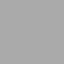

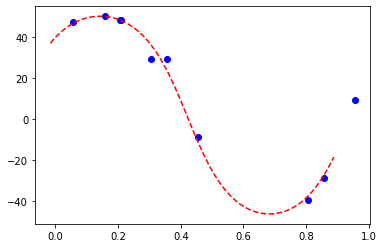

In [13]:

mdata = pd.concat([data[:npoints],data[data['type']=='s1']])
model = GeologicalModel(boundary_points[0,:],boundary_points[1,:])
model.set_model_data(mdata)
fold_frame = model.create_and_add_fold_frame('s1',nelements=10000)
stratigraphy = model.create_and_add_folded_foliation('s0',
                                               fold_frame['feature'],
                                                nelements=10000,
                                               fold_axis=[-6.51626577e-06, -5.00013645e-01, -8.66017526e-01],
#                                                    limb_wl=1
                                                    )
viewer = LavaVuModelViewer(model,background="white")
# viewer.add_scalar_field(model.bounding_box,(38,55,30),
#                       'box',
#                      paint_with=stratigraphy,
#                      cmap='prism')
viewer.add_isosurface(fold_frame['feature'][0],colour='blue',isovalue=0.4,alpha=0.5)
viewer.add_isosurface(fold_frame['feature'][1],colour='green',alpha=0.5)


viewer.add_data(stratigraphy['feature'])
viewer.add_isosurface(stratigraphy['feature'],
                     voxet=model.voxet())
viewer.interactive()
plt.plot(stratigraphy['foliation'],stratigraphy['limb_rotation'],'bo')
x = np.linspace(fold_frame['feature'][0].min(),fold_frame['feature'][1].max(),100)
plt.plot(x,stratigraphy['fold'].fold_limb_rotation(x),'r--')